# 3rd approach on deep learning
2025-02-20

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import sys
import numpy as np
import time
import re
from matplotlib.axes._axes import Axes as matplotlib_Axis

atom_vector_dict = {x:i for i, x in enumerate(["H", "C", "N", "O", "S"])}
residue_vector_dict = {x:i for i, x in enumerate(["ALA", "ARG", "ASN", "ASP", "CYS", "GLN", "GLU", "GLY", "HIS", "ILE", "LEU", "LYS", "MET", "PHE", "PRO", "SER", "THR", "TRP", "TYR", "VAL"])}

rescode_dict = {
    "ALA" : "A",
    "ARG" : "R",
    "ASN" : "N",
    "ASP" : "D",
    "CYS" : "C",
    "GLN" : "Q",
    "GLU" : "E",
    "GLY" : "G",
    "HIS" : "H",
    "ILE" : "I",
    "LEU" : "L",
    "LYS" : "K",
    "MET" : "M",
    "PHE" : "F",
    "PRO" : "P",
    "SER" : "S",
    "THR" : "T",
    "TRP" : "W",
    "TYR" : "Y",
    "VAL" : "V"
}

vector_size = 1 + len(residue_vector_dict)*2 + len(atom_vector_dict)*2
vector_offset_r1 = 1
vector_offset_r2 = vector_offset_r1 + len(residue_vector_dict)
vector_offset_a1 = vector_offset_r2 + len(residue_vector_dict) 
vector_offset_a2 = vector_offset_a1 + len(atom_vector_dict)
print(f"Vector size: {vector_size}; Atom 1 offset: {vector_offset_a1}")

Vector size: 51; Atom 1 offset: 41


In [2]:
AF_DMI_structures_folders = [Path("../ressources/AF2/AF_DMI_structures").resolve() / p for p in ['AF_DMI_structures1', 'AF_DMI_structures2', 'AF_DMI_structures3', "AF_DMI_mutated_structures"]]
solved_DMI_structures_path = Path("../ressources/solved/DMI_solved_structures_hydrogens").resolve()

for p in [solved_DMI_structures_path] + AF_DMI_structures_folders:
    if not p.exists():
        print(f"{p} does not point to a valid path")

D:\Eigene Datein\Programmieren\Git\abrilka\bachelorthesis\ressources\solved\DMI_solved_structures_hydrogens does not point to a valid path
D:\Eigene Datein\Programmieren\Git\abrilka\bachelorthesis\ressources\AF2\AF_DMI_structures\AF_DMI_structures1 does not point to a valid path
D:\Eigene Datein\Programmieren\Git\abrilka\bachelorthesis\ressources\AF2\AF_DMI_structures\AF_DMI_structures2 does not point to a valid path
D:\Eigene Datein\Programmieren\Git\abrilka\bachelorthesis\ressources\AF2\AF_DMI_structures\AF_DMI_structures3 does not point to a valid path
D:\Eigene Datein\Programmieren\Git\abrilka\bachelorthesis\ressources\AF2\AF_DMI_structures\AF_DMI_mutated_structures does not point to a valid path


In [28]:
libpath = Path("../src").resolve()
print(libpath)
sys.path.insert(0, str(libpath))
import measure_PPI
from measure_PPI import *

D:\Eigene Datein\Programmieren\Git\abrilka\bachelorthesis\src


In [29]:
pathObj = {}
for p in AF_DMI_structures_folders:
    measure_PPI.WalkFolder(basePath=p, pathObj=pathObj, files="ranked_0")
DMI_AF_biopy = {}
for (path, structure_name) in pathObj.values():
    biopy_struc, biotite_struc = measure_PPI.OpenStructure(path=path, structure_name=structure_name)
    if biotite_struc is None or biopy_struc is None:
        continue
    DMI_AF_biopy[structure_name] = biopy_struc

[2025-02-20 11:20:39,195 | measure_PPI | INFO] Found 80 structures
[2025-02-20 11:20:39,203 | measure_PPI | INFO] Found 105 structures
[2025-02-20 11:20:39,211 | measure_PPI | INFO] Found 89 structures
[2025-02-20 11:20:39,239 | measure_PPI | INFO] Found 268 structures
[2025-02-20 11:20:41,920 | measure_PPI | WARNING] Can't parse structure LIG_MAD2_1GO4 (file ranked_0.pdb) due to the following reason: Empty file.
[2025-02-20 11:20:44,904 | measure_PPI | WARNING] Can't parse structure LIG_Vh1_VBS_1_1SYQ (file ranked_0.pdb) due to the following reason: Empty file.
[2025-02-20 11:20:44,905 | measure_PPI | WARNING] Can't parse structure LIG_WD40_WDR5_VDV_1_4CY2 (file ranked_0.pdb) due to the following reason: Empty file.
[2025-02-20 11:20:47,076 | measure_PPI | WARNING] Can't parse structure MLIG_LYPXL_L_2_2R02.DLIG_PTAP_UEV_1_1M4P (file ranked_0.pdb) due to the following reason: Empty file.
[2025-02-20 11:20:48,436 | measure_PPI | WARNING] Can't parse structure MLIG_WD40_WDR5_WIN_2_4CY3.D

In [30]:
dataAF = pd.DataFrame(columns=("structure_name",))
for structure_name in DMI_AF_biopy.keys():
    dataAF.loc[len(dataAF)] = {"structure_name": structure_name}
regex_paired_DMI = r"^([\w\-]+)_(\w{4})$"
regex_random_DMI = r"^([\w\-]+)_(\w{4})\.([\w\-]+)_(\w{4})$"
regex_mutated_DMI = r"^([\w\-]+)_(\w{4})_(\w+)\.([A-Za-z]+)$"


dataAF["PDB_id"] = None
dataAF["ELM_instance"] = None
dataAF["PDB_id_random_paired"] = None
dataAF["ELM_instance_random_paired"] = None
dataAF["sequence"] = None
dataAF["sequence_mutated"] = None

def structure_name_parsing(row: pd.Series):
    pdb_id, elm_instance, pdb_id_2, elm_instance_2, sequence, sequence_f = None, None, None, None, None, None
    if (r1 := re.search(regex_paired_DMI, row["structure_name"])) is not None and len(r1.groups()) == 2:
        elm_instance = r1.groups()[0]
        pdb_id = r1.groups()[1]
    elif (r := re.search(regex_random_DMI, row["structure_name"])) is not None and len(r.groups()) == 4:
        elm_instance = r.groups()[0]
        pdb_id = r.groups()[1]
        elm_instance_2 = r.groups()[2]
        pdb_id_2 = r.groups()[3]
    elif (r := re.search(regex_mutated_DMI, row["structure_name"])) is not None and len(r.groups()) == 4:
        elm_instance = r.groups()[0]
        pdb_id = r.groups()[1]
        sequence = r.groups()[2]
        sequence_f = r.groups()[3]
    return pd.Series({"structure_name": row["structure_name"], "PDB_id": pdb_id, "ELM_instance": elm_instance, "PDB_id_random_paired": pdb_id_2, "ELM_instance_random_paired": elm_instance_2, "sequence": sequence, "sequence_mutated": sequence_f})

dataAF = dataAF.apply(structure_name_parsing, axis=1)
dataAF


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated
0,DEG_APCC_KENBOX_2_4GGD,4GGD,DEG_APCC_KENBOX_2,None,None,None,None
1,DEG_COP1_1_5IGO,5IGO,DEG_COP1_1,None,None,None,None
2,DEG_Kelch_Keap1_1_2FLU,2FLU,DEG_Kelch_Keap1_1,None,None,None,None
3,DEG_Kelch_Keap1_2_3WN7,3WN7,DEG_Kelch_Keap1_2,None,None,None,None
4,DEG_MDM2_SWIB_1_1YCR,1YCR,DEG_MDM2_SWIB_1,None,None,None,None
...,...,...,...,...,...,...,...
532,TRG_NES_CRM1_1_3GB8_EELSQALASSFSVSQD.EELSQALAS...,3GB8,TRG_NES_CRM1_1,None,None,EELSQALASSFSVSQD,EELSQALASSDSVSQW
533,TRG_NLS_Bipartite_1_1PJM_GKRSAEGSNPPKPLKKL.GGG...,1PJM,TRG_NLS_Bipartite_1,None,None,GKRSAEGSNPPKPLKKL,GGGSAEGSNPPKPLKKL
534,TRG_NLS_Bipartite_1_1PJM_GKRSAEGSNPPKPLKKL.GGR...,1PJM,TRG_NLS_Bipartite_1,None,None,GKRSAEGSNPPKPLKKL,GGRSAEGSNPPKPLKKL
535,TRG_PTS1_2C0L_NAKL.NAGD,2C0L,TRG_PTS1,None,None,NAKL,NAGD


In [31]:
pathObj_solved = {}
measure_PPI.WalkFolder(basePath=solved_DMI_structures_path, pathObj=pathObj_solved)
DMI_solved_biopy = {}
for (path, structure_name) in pathObj_solved.values():
    structure_name2 = structure_name.split("_")[0]
    biopy_struc, biotite_struc = measure_PPI.OpenStructure(path=path, structure_name=structure_name2)
    DMI_solved_biopy[structure_name2] = biopy_struc

[2025-02-20 11:20:58,984 | measure_PPI | INFO] Found 138 structures


In [ ]:
from sklearn.metrics import pairwise_distances
from Bio.PDB.Atom import Atom as BioPy_Atom

class ProteinStructureWarning(Exception):
    def __init__(self, message):            
        super().__init__(message)

def get_distance_matrix(structure_biopy:BioPy_PDBStructure) -> tuple[np.ndarray, list[BioPy_Atom], list[BioPy_Atom]]:
    stopwatch = Stopwatch().Start()
    chains = [c for c in structure_biopy.get_chains()]
    if not len(chains) == 2: raise ProteinStructureWarning(f"The protein needs to have 2 chains but it has {len(chains)}")
    chain1 = structure_biopy[0][chains[0].id]
    chain2 = structure_biopy[0][chains[1].id]
    

    chain1_atoms = np.array([a for a in chain1.get_atoms()])
    chain2_atoms = np.array([a for a in chain2.get_atoms()])
    chain1_coords = [a.coord for a in chain1_atoms]
    chain2_coords = [a.coord for a in chain2_atoms]
    stopwatch.Lap("Parsing the chains and atom arrays")

    distance_matrix = pairwise_distances(chain1_coords,chain2_coords)
    stopwatch.Lap("Distance Matrix")

    return (distance_matrix, chain1_atoms, chain2_atoms)

def get_interface(distance_matrix: np.ndarray, chain1_atoms: list[BioPy_Atom], chain2_atoms: list[BioPy_Atom], cutoff=5.0):
    pair_dist = np.argwhere(distance_matrix <= cutoff) # List of matrix indices where distance is below cutoff
    intf1_atoms = set(chain1_atoms[pair_dist[:, 0]]) # Set of the chain1 atoms with an atom from chain2 closer than cutoff distance
    intf2_atoms = set(chain2_atoms[pair_dist[:, 1]])

    # List of backbone atoms in the interface
    intf1_backbone = [a for a in intf1_atoms if a.name == "CA" and a in intf1_atoms]
    intf2_backbone = [a for a in intf2_atoms if a.name == "CA" and a in intf2_atoms]

    intf1_residues = [a.parent for a in intf1_backbone]
    intf2_residues = [a.parent for a in intf2_backbone]

    # A list for each chain combined to a tuple with the indices of the interface residues. Example : ([23, 445, 470], [26]) 
    backbone_indices_tuple = ([i for i,a in enumerate(chain1_atoms) if a in intf1_backbone], [i for i,a in enumerate(chain2_atoms) if a in intf2_backbone]) 

    # The distance matrix sliced to only the interface backbone atoms. So shape is (len(intf1_backbone), len(intf2_backbone))
    local_dist_matrix = distance_matrix[backbone_indices_tuple[0], :][:, backbone_indices_tuple[1]]

    min_distance = None
    if local_dist_matrix.size != 0:
        min_distance = round(np.min(local_dist_matrix), 3)

    return (intf1_residues, intf2_residues, min_distance)


In [33]:
class InterfacePair:

    def __init__(self, atom1: BioPy_Atom = None, atom2: BioPy_Atom = None, distance: float = None):
        self.atom1 = atom1
        self.atom2 = atom2
        self.valid: bool|None = None
        self.distance = float(distance)

    def __hash__(self):
        return hash(str(hash(self.atom1))+str(hash(self.atom2)))
    
    def __str__(self):
        return f"{int(self.valid) if self.valid is not None else ""}{str(self.atom1.parent.parent)}{str(self.atom1.parent)}{str(self.atom1)}, {str(self.atom2.parent.parent)}{str(self.atom2.parent)}{str(self.atom2)} @ {round(self.distance, 3)}"
    
    def __repr__(self):
        return self.__str__()

class Interface:

    def __init__(self, pairs: list[InterfacePair] = None):
        self.pairs: list[InterfacePair] = pairs if pairs is not None else []

    def get(self, mask:np.ndarray):
        return Interface(np.array(self.pairs)[mask])

    @property
    def distance(self):
        return np.array([x.distance for x in self.pairs])
    
    @property
    def residue1_id(self):
        return np.array([x.atom1.parent.id[1] for x in self.pairs])
    
    @property
    def residue2_id(self):
        return np.array([x.atom2.parent.id[1] for x in self.pairs])
    
    @property
    def element1(self):
        return np.array([x.atom1.element for x in self.pairs])
    
    @property
    def element2(self):
        return np.array([x.atom2.element for x in self.pairs])
    
    @property
    def valid(self):
        return np.array([x.valid for x in self.pairs])
    
    @valid.setter
    def valid(self, val: bool):
        for p in self.pairs: p.valid = val
    
    def __repr__(self):
        return "Interface:{\n" + '\n'.join(["\t" + str(p) for p in self.pairs]) + "\n}"
    
    def __str__(self):
        return f"<Interface of {len(self.pairs)} pairs>"
    
def get_interface(distance_matrix: np.ndarray, chain1_atoms: list[BioPy_Atom], chain2_atoms: list[BioPy_Atom], cutoff=5.0):
    pair_dist = np.argwhere(distance_matrix <= cutoff)
    intf = Interface([InterfacePair(chain1_atoms[pair_dist[i,0]], chain2_atoms[pair_dist[i,1]], distance_matrix[pair_dist[i,0],pair_dist[i,1]]) for i in range(pair_dist.shape[0])])
    return intf

distance_matrix, chain1_atoms, chain2_atoms = get_distance_matrix(DMI_AF_biopy["DEG_MDM2_SWIB_1_1YCR"])
intf = get_interface(distance_matrix, chain1_atoms, chain2_atoms)
intf

Interface:{
	<Chain id=A><Residue VAL het=  resseq=24 icode= ><Atom O>, <Chain id=B><Residue TRP het=  resseq=5 icode= ><Atom HZ2> @ 4.584
	<Chain id=A><Residue LEU het=  resseq=25 icode= ><Atom N>, <Chain id=B><Residue TRP het=  resseq=5 icode= ><Atom HE1> @ 4.918
	<Chain id=A><Residue LEU het=  resseq=25 icode= ><Atom N>, <Chain id=B><Residue TRP het=  resseq=5 icode= ><Atom HZ2> @ 4.748
	<Chain id=A><Residue LEU het=  resseq=25 icode= ><Atom CA>, <Chain id=B><Residue TRP het=  resseq=5 icode= ><Atom CE2> @ 4.734
	<Chain id=A><Residue LEU het=  resseq=25 icode= ><Atom CA>, <Chain id=B><Residue TRP het=  resseq=5 icode= ><Atom NE1> @ 4.345
	<Chain id=A><Residue LEU het=  resseq=25 icode= ><Atom CA>, <Chain id=B><Residue TRP het=  resseq=5 icode= ><Atom HE1> @ 3.531
	<Chain id=A><Residue LEU het=  resseq=25 icode= ><Atom CA>, <Chain id=B><Residue TRP het=  resseq=5 icode= ><Atom CZ2> @ 4.458
	<Chain id=A><Residue LEU het=  resseq=25 icode= ><Atom CA>, <Chain id=B><Residue TRP het=  res

In [34]:
interfaces = []
for i, row in dataAF.iterrows():
    if i % 25 == 0:
        print(f"Processed {i}/{len(dataAF)}")
    pdb_id = row["PDB_id"]
    structure_name = row["structure_name"]
    pdb_id_pair = row["PDB_id_random_paired"]
    sequence = row["sequence"]
    sequence_mutated = row["sequence_mutated"]
    biopy_struc = DMI_AF_biopy[structure_name]
    if sequence is None and pdb_id_pair is None:
        # Use solved structure if available
        if pdb_id not in DMI_solved_biopy.keys():
            print(f"{pdb_id} not found in solved structures")
        else:
            biopy_struc = DMI_solved_biopy[pdb_id]
    distance_matrix, chain1_atoms, chain2_atoms = get_distance_matrix(biopy_struc)
    intf = get_interface(distance_matrix, chain1_atoms, chain2_atoms)
    if pdb_id_pair is None and sequence is None:
        intf.valid = True
    elif pdb_id_pair is not None and sequence is None:
        intf.valid = False
    elif pdb_id_pair is None and sequence is not None:
        intf.valid = True
        for n in range(len(sequence)):
            c1, c2 = sequence[n], sequence_mutated[n]
            if c1 == c2: continue
            intf.get(intf.residue2_id == (n+1)).valid = False
    else:
        print("Unexpected row")


            
    interfaces.append(intf)
dataAF["interface"] = interfaces

Processed 0/537
Processed 25/537
3AA0 not found in solved structures
2V51 not found in solved structures
Processed 50/537
Processed 75/537
Processed 100/537
Processed 125/537
Processed 150/537
Processed 175/537
Processed 200/537
Processed 225/537
Processed 250/537
Processed 275/537
Processed 300/537
Processed 325/537
Processed 350/537
Processed 375/537
Processed 400/537
Processed 425/537
Processed 450/537
Processed 475/537
Processed 500/537
Processed 525/537


In [35]:
dataAF

,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
0,DEG_APCC_KENBOX_2_4GGD,4GGD,DEG_APCC_KENBOX_2,None,None,None,None,<Interface of 920 pairs>
1,DEG_COP1_1_5IGO,5IGO,DEG_COP1_1,None,None,None,None,<Interface of 1876 pairs>
2,DEG_Kelch_Keap1_1_2FLU,2FLU,DEG_Kelch_Keap1_1,None,None,None,None,<Interface of 1138 pairs>
3,DEG_Kelch_Keap1_2_3WN7,3WN7,DEG_Kelch_Keap1_2,None,None,None,None,<Interface of 1602 pairs>
4,DEG_MDM2_SWIB_1_1YCR,1YCR,DEG_MDM2_SWIB_1,None,None,None,None,<Interface of 1422 pairs>
...,...,...,...,...,...,...,...,...
532,TRG_NES_CRM1_1_3GB8_EELSQALASSFSVSQD.EELSQALAS...,3GB8,TRG_NES_CRM1_1,None,None,EELSQALASSFSVSQD,EELSQALASSDSVSQW,<Interface of 2427 pairs>
533,TRG_NLS_Bipartite_1_1PJM_GKRSAEGSNPPKPLKKL.GGG...,1PJM,TRG_NLS_Bipartite_1,None,None,GKRSAEGSNPPKPLKKL,GGGSAEGSNPPKPLKKL,<Interface of 2621 pairs>
534,TRG_NLS_Bipartite_1_1PJM_GKRSAEGSNPPKPLKKL.GGR...,1PJM,TRG_NLS_Bipartite_1,None,None,GKRSAEGSNPPKPLKKL,GGRSAEGSNPPKPLKKL,<Interface of 2673 pairs>
535,TRG_PTS1_2C0L_NAKL.NAGD,2C0L,TRG_PTS1,None,None,NAKL,NAGD,<Interface of 95 pairs>


In [48]:
rnd =  np.random.default_rng(seed=2501)
pdb_ids = list(set(dataAF["PDB_id"]).union(dataAF["PDB_id_random_paired"]))
pdb_ids.remove(None)
print("Available PDB IDs:", len(pdb_ids))
rnd.shuffle(pdb_ids)
pdb_ids_training = pdb_ids[0:int(len(pdb_ids)*0.8)]
pdb_ids_test = pdb_ids[int(len(pdb_ids)*0.8):]
print("Training")
display(pdb_ids_training)
print("Test")
display(pdb_ids_test)

Available PDB IDs: 141
Training


['1JGN',
 '1JD5',
 '1SXJ',
 '2KXH',
 '1NW9',
 '2R03',
 '1ELR',
 '2W84',
 '3ZFW',
 '1DDV',
 '2ZNE',
 '1EG4',
 '4ZI2',
 '1O0P',
 '5F74',
 '5FJX',
 '1CZY',
 '3WN7',
 '4KMD',
 '1PD7',
 '2PZO',
 '2ZVL',
 '2G30',
 '5IGO',
 '2GBQ',
 '2GPH',
 '1MFG',
 '2YKT',
 '1CA9',
 '2O8G',
 '2LSI',
 '2B9J',
 '3MQS',
 '4J2X',
 '2I3S',
 '2JQ9',
 '2V51',
 '3UVK',
 '3AA1',
 '2Y48',
 '3UXG',
 '4NEE',
 '3TEI',
 '1L2Z',
 '2RR3',
 '1D5G',
 '4FMO',
 '6FUZ',
 '1KYU',
 '2MOW',
 '2C0L',
 '2D1K',
 '3HQM',
 '1S70',
 '3OGL',
 '2ASQ',
 '1GWQ',
 '2XS0',
 '3N5U',
 '2A41',
 '3RDV',
 '2JKR',
 '3BQO',
 '2A25',
 '1O6K',
 '1PJM',
 '1KPS',
 '1O9U',
 '1YY6',
 '2V8C',
 '1C9I',
 '1B72',
 '3VVW',
 '6G84',
 '1MKE',
 '2K42',
 '2X04',
 '2L8J',
 '4F0Z',
 '4YOC',
 '5VZU',
 '4CQO',
 '2V3S',
 '4BH6',
 '1CKA',
 '5ETA',
 '3TWU',
 '1F95',
 '1KKQ',
 '1NTV',
 '1M4P',
 '2CCI',
 '1H25',
 '5AZG',
 '5EOD',
 '2IX7',
 '4H3Q',
 '3GB8',
 '2CE8',
 '2R02',
 '1UTC',
 '1GO4',
 '1SYQ',
 '3QIS',
 '2XS1',
 '2ORZ',
 '1DPU',
 '5MLW',
 '3AA0',
 '2ODD',
 '2FLU',
 

Test


['7DS2',
 '1BXX',
 '4CY2',
 '1N4M',
 '4CY3',
 '4GGD',
 '1ATP',
 '1KY7',
 '3GM1',
 '3SOQ',
 '1AXC',
 '2JK9',
 '4BXU',
 '1FF1',
 '5HKH',
 '1EVH',
 '1YCR',
 '4H3B',
 '2P1Q',
 '1ZUB',
 '1GH6',
 '1JWG',
 '4EOY',
 '3EU7',
 '3WP0',
 '2ROC',
 '2BZ8',
 '2KQS',
 '2V52']

In [37]:
dataAF_training = dataAF[np.logical_and(~dataAF["PDB_id"].isin(pdb_ids_test), ~dataAF["PDB_id_random_paired"].isin(pdb_ids_test))]
dataAF_test = dataAF[np.logical_and(~dataAF["PDB_id"].isin(pdb_ids_training), ~dataAF["PDB_id_random_paired"].isin(pdb_ids_training))]
print("Training")
display(dataAF_training)
print("Test")
display(dataAF_test)

Training


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
1,DEG_COP1_1_5IGO,5IGO,DEG_COP1_1,None,None,None,None,<Interface of 1876 pairs>
2,DEG_Kelch_Keap1_1_2FLU,2FLU,DEG_Kelch_Keap1_1,None,None,None,None,<Interface of 1138 pairs>
3,DEG_Kelch_Keap1_2_3WN7,3WN7,DEG_Kelch_Keap1_2,None,None,None,None,<Interface of 1602 pairs>
5,DEG_SCF_COI1_1_3OGL,3OGL,DEG_SCF_COI1_1,None,None,None,None,<Interface of 2558 pairs>
6,DEG_SCF_FBXO31_1_5VZU,5VZU,DEG_SCF_FBXO31_1,None,None,None,None,<Interface of 1170 pairs>
...,...,...,...,...,...,...,...,...
532,TRG_NES_CRM1_1_3GB8_EELSQALASSFSVSQD.EELSQALAS...,3GB8,TRG_NES_CRM1_1,None,None,EELSQALASSFSVSQD,EELSQALASSDSVSQW,<Interface of 2427 pairs>
533,TRG_NLS_Bipartite_1_1PJM_GKRSAEGSNPPKPLKKL.GGG...,1PJM,TRG_NLS_Bipartite_1,None,None,GKRSAEGSNPPKPLKKL,GGGSAEGSNPPKPLKKL,<Interface of 2621 pairs>
534,TRG_NLS_Bipartite_1_1PJM_GKRSAEGSNPPKPLKKL.GGR...,1PJM,TRG_NLS_Bipartite_1,None,None,GKRSAEGSNPPKPLKKL,GGRSAEGSNPPKPLKKL,<Interface of 2673 pairs>
535,TRG_PTS1_2C0L_NAKL.NAGD,2C0L,TRG_PTS1,None,None,NAKL,NAGD,<Interface of 95 pairs>


Test


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
0,DEG_APCC_KENBOX_2_4GGD,4GGD,DEG_APCC_KENBOX_2,None,None,None,None,<Interface of 920 pairs>
4,DEG_MDM2_SWIB_1_1YCR,1YCR,DEG_MDM2_SWIB_1,None,None,None,None,<Interface of 1422 pairs>
7,DEG_SCF_TIR1_1_2P1Q,2P1Q,DEG_SCF_TIR1_1,None,None,None,None,<Interface of 1778 pairs>
10,DOC_AGCK_PIF_3_1ATP,1ATP,DOC_AGCK_PIF_3,None,None,None,None,<Interface of 1160 pairs>
18,DOC_MAPK_JIP1_4_4H3B,4H3B,DOC_MAPK_JIP1_4,None,None,None,None,<Interface of 1632 pairs>
...,...,...,...,...,...,...,...,...
512,LIG_WD40_WDR5_WIN_2_4CY3_CSRARPL.CSRARWL,4CY3,LIG_WD40_WDR5_WIN_2,None,None,CSRARPL,CSRARWL,<Interface of 1537 pairs>
525,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRD,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRD,<Interface of 393 pairs>
526,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRL,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRL,<Interface of 845 pairs>
529,TRG_LysEnd_GGAAcLL_1_1JWG_DEDLLHI.DEDLDHI,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,DEDLLHI,DEDLDHI,<Interface of 1459 pairs>


In [38]:
def interface_pair_to_vector(intfp: InterfacePair):
    vector1 = np.full(shape=(vector_size + 1,), fill_value=0, dtype="float")

    r1, r2 = intfp.atom1.parent.resname, intfp.atom2.parent.resname
    r1_class = residue_vector_dict[r1] if r1 in residue_vector_dict.keys() else -1
    r2_class = residue_vector_dict[r2] if r2 in residue_vector_dict.keys() else -1

    a1e, a2e = intfp.atom1.element, intfp.atom2.element
    a1_class = atom_vector_dict[a1e] if a1e in atom_vector_dict.keys() else -1
    a2_class = atom_vector_dict[a2e] if a2e in atom_vector_dict.keys() else -1

    if r1_class == -1 or r2_class == -2: return None
    if a1_class == -1 or a2_class == -2: return None

    vector1[0] = intfp.distance
    vector1[r1_class + vector_offset_r1] = 1
    vector1[r2_class + vector_offset_r2] = 1
    vector1[a1_class + vector_offset_a1] = 1
    vector1[a2_class + vector_offset_a2] = 1
    vector1[vector_size] = intfp.valid

    return vector1

vectors_train = []
for i, row in dataAF_training.iterrows():
    vectors_train.extend([interface_pair_to_vector(p) for p in row["interface"].pairs if interface_pair_to_vector(p) is not None])
vectors_train = np.array(vectors_train)
x_train, y_train = vectors_train[:, 0:(vectors_train.shape[1]-1)], vectors_train[:, vectors_train.shape[1]-1]

vectors_test = []
for i, row in dataAF_test.iterrows():
    vectors_test.extend([interface_pair_to_vector(p) for p in row["interface"].pairs if interface_pair_to_vector(p) is not None])
vectors_test = np.array(vectors_test)
x_test, y_test = vectors_test[:, 0:(vectors_test.shape[1]-1)], vectors_test[:, vectors_test.shape[1]-1]
print("Training:", x_train.shape, y_train.shape)
print("Test:", x_test.shape, y_test.shape)

Training: (522048, 51) (522048,)
Test: (117915, 51) (117915,)


In [ ]:
dataAF_training = dataAF[np.logical_and(~dataAF["PDB_id"].isin(pdb_ids_test), ~dataAF["PDB_id_random_paired"].isin(pdb_ids_test))]
dataAF_test = dataAF[np.logical_and(~dataAF["PDB_id"].isin(pdb_ids_training), ~dataAF["PDB_id_random_paired"].isin(pdb_ids_training))]
print("Training")
display(dataAF_training)
print("Test")
display(dataAF_test)

Training


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
1,DEG_COP1_1_5IGO,5IGO,DEG_COP1_1,None,None,None,None,<Interface of 1876 pairs>
2,DEG_Kelch_Keap1_1_2FLU,2FLU,DEG_Kelch_Keap1_1,None,None,None,None,<Interface of 1138 pairs>
3,DEG_Kelch_Keap1_2_3WN7,3WN7,DEG_Kelch_Keap1_2,None,None,None,None,<Interface of 1602 pairs>
5,DEG_SCF_COI1_1_3OGL,3OGL,DEG_SCF_COI1_1,None,None,None,None,<Interface of 2558 pairs>
6,DEG_SCF_FBXO31_1_5VZU,5VZU,DEG_SCF_FBXO31_1,None,None,None,None,<Interface of 1170 pairs>
...,...,...,...,...,...,...,...,...
532,TRG_NES_CRM1_1_3GB8_EELSQALASSFSVSQD.EELSQALAS...,3GB8,TRG_NES_CRM1_1,None,None,EELSQALASSFSVSQD,EELSQALASSDSVSQW,<Interface of 2427 pairs>
533,TRG_NLS_Bipartite_1_1PJM_GKRSAEGSNPPKPLKKL.GGG...,1PJM,TRG_NLS_Bipartite_1,None,None,GKRSAEGSNPPKPLKKL,GGGSAEGSNPPKPLKKL,<Interface of 2621 pairs>
534,TRG_NLS_Bipartite_1_1PJM_GKRSAEGSNPPKPLKKL.GGR...,1PJM,TRG_NLS_Bipartite_1,None,None,GKRSAEGSNPPKPLKKL,GGRSAEGSNPPKPLKKL,<Interface of 2673 pairs>
535,TRG_PTS1_2C0L_NAKL.NAGD,2C0L,TRG_PTS1,None,None,NAKL,NAGD,<Interface of 95 pairs>


Test


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
0,DEG_APCC_KENBOX_2_4GGD,4GGD,DEG_APCC_KENBOX_2,None,None,None,None,<Interface of 920 pairs>
4,DEG_MDM2_SWIB_1_1YCR,1YCR,DEG_MDM2_SWIB_1,None,None,None,None,<Interface of 1422 pairs>
7,DEG_SCF_TIR1_1_2P1Q,2P1Q,DEG_SCF_TIR1_1,None,None,None,None,<Interface of 1778 pairs>
10,DOC_AGCK_PIF_3_1ATP,1ATP,DOC_AGCK_PIF_3,None,None,None,None,<Interface of 1160 pairs>
18,DOC_MAPK_JIP1_4_4H3B,4H3B,DOC_MAPK_JIP1_4,None,None,None,None,<Interface of 1632 pairs>
...,...,...,...,...,...,...,...,...
512,LIG_WD40_WDR5_WIN_2_4CY3_CSRARPL.CSRARWL,4CY3,LIG_WD40_WDR5_WIN_2,None,None,CSRARPL,CSRARWL,<Interface of 1537 pairs>
525,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRD,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRD,<Interface of 393 pairs>
526,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRL,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRL,<Interface of 845 pairs>
529,TRG_LysEnd_GGAAcLL_1_1JWG_DEDLLHI.DEDLDHI,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,DEDLLHI,DEDLDHI,<Interface of 1459 pairs>


In [ ]:
def interface_pair_to_vector(intfp: InterfacePair):
    vector1 = np.full(shape=(vector_size + 1,), fill_value=0, dtype="float")

    r1, r2 = intfp.atom1.parent.resname, intfp.atom2.parent.resname
    r1_class = residue_vector_dict[r1] if r1 in residue_vector_dict.keys() else -1
    r2_class = residue_vector_dict[r2] if r2 in residue_vector_dict.keys() else -1

    a1e, a2e = intfp.atom1.element, intfp.atom2.element
    a1_class = atom_vector_dict[a1e] if a1e in atom_vector_dict.keys() else -1
    a2_class = atom_vector_dict[a2e] if a2e in atom_vector_dict.keys() else -1

    if r1_class == -1 or r2_class == -2: return None
    if a1_class == -1 or a2_class == -2: return None

    vector1[0] = intfp.distance
    vector1[r1_class + vector_offset_r1] = 1
    vector1[r2_class + vector_offset_r2] = 1
    vector1[a1_class + vector_offset_a1] = 1
    vector1[a2_class + vector_offset_a2] = 1
    vector1[vector_size] = intfp.valid

    return vector1

vectors_train = []
for i, row in dataAF_training.iterrows():
    vectors_train.extend([interface_pair_to_vector(p) for p in row["interface"].pairs if interface_pair_to_vector(p) is not None])
vectors_train = np.array(vectors_train)
x_train, y_train = vectors_train[:, 0:(vectors_train.shape[1]-1)], vectors_train[:, vectors_train.shape[1]-1]

vectors_test = []
for i, row in dataAF_test.iterrows():
    vectors_test.extend([interface_pair_to_vector(p) for p in row["interface"].pairs if interface_pair_to_vector(p) is not None])
vectors_test = np.array(vectors_test)
x_test, y_test = vectors_test[:, 0:(vectors_test.shape[1]-1)], vectors_test[:, vectors_test.shape[1]-1]
print("Training:", x_train.shape, y_train.shape)
print("Test:", x_test.shape, y_test.shape)

Training: (522048, 51) (522048,)
Test: (117915, 51) (117915,)


## Deep learning

In [15]:
import keras

In [39]:
from sklearn.neural_network import MLPClassifier
clf = MLPClassifier(solver='adam', alpha=1e-2, hidden_layer_sizes=(20, 10, 5), random_state=2501)

clf.fit(x_train, y_train)

MLPClassifier(alpha=0.01, hidden_layer_sizes=(20, 10, 5), random_state=2501)

In [46]:
clf.score(x_test, y_test)

0.8381376415214349

In [82]:
def visualize_interface_ax(ax, intf, chain: str, title: str):
    if chain == "A":
        intfc_res = list(set([p.atom1.parent for p in intf.pairs]))
        intfc_not_valid = list(set([p.atom1.parent for p in intf.pairs if p.valid == False]))
    else:
        intfc_res = list(set([p.atom2.parent for p in intf.pairs]))
        intfc_not_valid = list(set([p.atom2.parent for p in intf.pairs if p.valid == False]))

    vectors = np.array([interface_pair_to_vector(p) for p in intf.pairs if interface_pair_to_vector(p) is not None])
    vectors_x, vectors_y = vectors[:, 0:(vectors.shape[1]-1)], vectors[:, vectors.shape[1]-1]

    y_proba = clf.predict_proba(vectors_x)

    #parent_ids = list(set([p.atom2.parent.id[1] for p in intf.pairs]))
    if chain == "A":
        x = [p.atom1.parent.id[1] for p in intf.pairs]
    else:
        x = [p.atom2.parent.id[1] for p in intf.pairs]
    x_set = sorted(list(set(x)))
    x_conv = []
    for x_ in x:
        x_conv.append(x_set.index(x_))
    x_ticks = {(r.id[1]) : f"{r.resname} ({r.id[1]}){'(X)' if r in intfc_not_valid else ''}" for i, r in enumerate(sorted(intfc_res, key=lambda p:p.id[1]))}


    ax.scatter(x_conv, y_proba[:,1], alpha=0.2)
    ax.set_title(title)
    ax.set_xticks(range(len(x_ticks.keys())), list(x_ticks.values()), rotation=90)
    ax.set_ylim((-0.1, 1.1))

def visualize_interface(pdb_id: str):
    if len(rows := dataAF[dataAF["PDB_id"] == pdb_id]) == 0:
        print(f"Unkown PDB ID {pdb_id}")
        return
    print(len(rows))
    
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20,10))

    row_solved = rows[np.logical_and(rows["PDB_id_random_paired"].isna(), rows["sequence"].isna())]
    row_random_paired = rows[np.logical_and(~rows["PDB_id_random_paired"].isna(), rows["sequence"].isna())]
    row_mutated = rows[np.logical_and(rows["PDB_id_random_paired"].isna(), ~rows["sequence"].isna())]

    display(row_solved)
    display(row_random_paired)
    display(row_mutated)

    if len(list(row_solved['structure_name'])) >= 1:
        visualize_interface_ax(axes[0,0], list(row_solved["interface"])[0], "A", f"{list(row_solved['structure_name'])[0]} Chain A")
        visualize_interface_ax(axes[1,0], list(row_solved["interface"])[0], "B", f"{list(row_solved['structure_name'])[0]} Chain B")
    if len(list(row_random_paired['structure_name'])) >= 1:
        visualize_interface_ax(axes[0,1], list(row_random_paired["interface"])[0], "A", f"{list(row_random_paired['structure_name'])[0]} Chain A")
        visualize_interface_ax(axes[1,1], list(row_random_paired["interface"])[0], "B", f"{list(row_random_paired['structure_name'])[0]} Chain B")

    if len(list(row_mutated['structure_name'])) >= 1:
        visualize_interface_ax(axes[0,2], list(row_mutated["interface"])[0], "A", f"{list(row_mutated['structure_name'])[0]} Chain A")
        visualize_interface_ax(axes[1,2], list(row_mutated["interface"])[0], "B", f"{list(row_mutated['structure_name'])[0]} Chain B")
    if len(list(row_mutated['structure_name'])) >= 2:
        visualize_interface_ax(axes[0,3], list(row_mutated["interface"])[1], "A", f"{list(row_mutated['structure_name'])[1]} Chain A")
        visualize_interface_ax(axes[1,3], list(row_mutated["interface"])[1], "B", f"{list(row_mutated['structure_name'])[1]} Chain B")

    fig.tight_layout()
    plt.show()
    return




In [ ]:
for pdb_id in pdb_ids_test:
    visualize_interface(pdb_id)


### Trying to predict RMSD

In [57]:
set(dataAF_training["PDB_id"]).intersection(dataAF_test["PDB_id"])

set()

In [58]:
dataAF_training = dataAF[np.logical_and(~dataAF["PDB_id"].isin(pdb_ids_test), ~dataAF["PDB_id_random_paired"].isin(pdb_ids_test))]
dataAF_training = dataAF_training[~dataAF_training["sequence"].isna()]
dataAF_test = dataAF[np.logical_and(~dataAF["PDB_id"].isin(pdb_ids_training), ~dataAF["PDB_id_random_paired"].isin(pdb_ids_training))]
dataAF_test = dataAF_test[~dataAF_test["sequence"].isna()]
print("Training")
display(dataAF_training)
print("Test")
display(dataAF_test)

Training


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
271,DEG_COP1_1_5IGO_SDQIVPEY.SDQIVPWG,5IGO,DEG_COP1_1,None,None,SDQIVPEY,SDQIVPWG,<Interface of 1439 pairs>
272,DEG_COP1_1_5IGO_SDQIVPEY.SDQIVPWY,5IGO,DEG_COP1_1,None,None,SDQIVPEY,SDQIVPWY,<Interface of 1418 pairs>
273,DEG_Kelch_Keap1_1_2FLU_DEETGE.DEETWE,2FLU,DEG_Kelch_Keap1_1,None,None,DEETGE,DEETWE,<Interface of 1733 pairs>
274,DEG_Kelch_Keap1_1_2FLU_DEETGE.DEEWWE,2FLU,DEG_Kelch_Keap1_1,None,None,DEETGE,DEEWWE,<Interface of 1824 pairs>
275,DEG_Kelch_Keap1_2_3WN7_QDIDLGV.WDIDDGV,3WN7,DEG_Kelch_Keap1_2,None,None,QDIDLGV,WDIDDGV,<Interface of 1199 pairs>
...,...,...,...,...,...,...,...,...
532,TRG_NES_CRM1_1_3GB8_EELSQALASSFSVSQD.EELSQALAS...,3GB8,TRG_NES_CRM1_1,None,None,EELSQALASSFSVSQD,EELSQALASSDSVSQW,<Interface of 2427 pairs>
533,TRG_NLS_Bipartite_1_1PJM_GKRSAEGSNPPKPLKKL.GGG...,1PJM,TRG_NLS_Bipartite_1,None,None,GKRSAEGSNPPKPLKKL,GGGSAEGSNPPKPLKKL,<Interface of 2621 pairs>
534,TRG_NLS_Bipartite_1_1PJM_GKRSAEGSNPPKPLKKL.GGR...,1PJM,TRG_NLS_Bipartite_1,None,None,GKRSAEGSNPPKPLKKL,GGRSAEGSNPPKPLKKL,<Interface of 2673 pairs>
535,TRG_PTS1_2C0L_NAKL.NAGD,2C0L,TRG_PTS1,None,None,NAKL,NAGD,<Interface of 95 pairs>


Test


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
269,DEG_APCC_KENBOX_2_4GGD_SKENV.SGENV,4GGD,DEG_APCC_KENBOX_2,None,None,SKENV,SGENV,<Interface of 771 pairs>
270,DEG_APCC_KENBOX_2_4GGD_SKENV.SGEWV,4GGD,DEG_APCC_KENBOX_2,None,None,SKENV,SGEWV,<Interface of 663 pairs>
277,DEG_MDM2_SWIB_1_1YCR_FSDLWKLL.FSDLGKLD,1YCR,DEG_MDM2_SWIB_1,None,None,FSDLWKLL,FSDLGKLD,<Interface of 1208 pairs>
278,DEG_MDM2_SWIB_1_1YCR_FSDLWKLL.FSDLWKLD,1YCR,DEG_MDM2_SWIB_1,None,None,FSDLWKLL,FSDLWKLD,<Interface of 1423 pairs>
283,DEG_SCF_TIR1_1_2P1Q_QVVGWPPVRNYRK.QVDGWPPDRNYRK,2P1Q,DEG_SCF_TIR1_1,None,None,QVVGWPPVRNYRK,QVDGWPPDRNYRK,<Interface of 3021 pairs>
284,DEG_SCF_TIR1_1_2P1Q_QVVGWPPVRNYRK.QVDGWPPVRNYRK,2P1Q,DEG_SCF_TIR1_1,None,None,QVVGWPPVRNYRK,QVDGWPPVRNYRK,<Interface of 2426 pairs>
289,DOC_AGCK_PIF_3_1ATP_FTEF.DTED,1ATP,DOC_AGCK_PIF_3,None,None,FTEF,DTED,<Interface of 292 pairs>
290,DOC_AGCK_PIF_3_1ATP_FTEF.FTED,1ATP,DOC_AGCK_PIF_3,None,None,FTEF,FTED,<Interface of 671 pairs>
305,DOC_MAPK_JIP1_4_4H3B_RPGSLDL.RWGSDDL,4H3B,DOC_MAPK_JIP1_4,None,None,RPGSLDL,RWGSDDL,<Interface of 1105 pairs>
306,DOC_MAPK_JIP1_4_4H3B_RPGSLDL.RWGSLDL,4H3B,DOC_MAPK_JIP1_4,None,None,RPGSLDL,RWGSLDL,<Interface of 1126 pairs>


In [84]:
def interface_pair_to_vector(intfp: InterfacePair):
    vector1 = np.full(shape=(vector_size + 1,), fill_value=0, dtype="float")

    r1, r2 = intfp.atom1.parent.resname, intfp.atom2.parent.resname
    r1_class = residue_vector_dict[r1] if r1 in residue_vector_dict.keys() else -1
    r2_class = residue_vector_dict[r2] if r2 in residue_vector_dict.keys() else -1

    a1e, a2e = intfp.atom1.element, intfp.atom2.element
    a1_class = atom_vector_dict[a1e] if a1e in atom_vector_dict.keys() else -1
    a2_class = atom_vector_dict[a2e] if a2e in atom_vector_dict.keys() else -1

    if r1_class == -1 or r2_class == -2: return None
    if a1_class == -1 or a2_class == -2: return None

    vector1[0] = intfp.distance
    vector1[r1_class + vector_offset_r1] = 1
    vector1[r2_class + vector_offset_r2] = 1
    vector1[a1_class + vector_offset_a1] = 1
    vector1[a2_class + vector_offset_a2] = 1
    vector1[vector_size] = intfp.valid

    return vector1[0:vector_offset_a1+1]

vectors_train = []
for i, row in dataAF_training.iterrows():
    vectors_train.extend([interface_pair_to_vector(p) for p in row["interface"].pairs if interface_pair_to_vector(p) is not None])
vectors_train = np.array(vectors_train)
x_train, y_train = vectors_train[:, 0:(vectors_train.shape[1]-1)], vectors_train[:, vectors_train.shape[1]-1]

vectors_test = []
for i, row in dataAF_test.iterrows():
    vectors_test.extend([interface_pair_to_vector(p) for p in row["interface"].pairs if interface_pair_to_vector(p) is not None])
vectors_test = np.array(vectors_test)
x_test, y_test = vectors_test[:, 0:(vectors_test.shape[1]-1)], vectors_test[:, vectors_test.shape[1]-1]
print("Training:", x_train.shape, y_train.shape)
print("Test:", x_test.shape, y_test.shape)

Training: (267155, 41) (267155,)
Test: (70445, 41) (70445,)


In [85]:
x_train.shape

(267155, 41)

In [80]:
from sklearn.neural_network import MLPClassifier
clf = MLPClassifier(solver='adam', alpha=1e-2, hidden_layer_sizes=(20, 10, 5), random_state=2501)

clf.fit(x_train, y_train)
clf.score(x_test, y_test)

0.8926396479523032

In [87]:
from sklearn.neural_network import MLPClassifier
clf = MLPClassifier(solver='adam', alpha=1e-2, hidden_layer_sizes=(10, 5), random_state=2501)

clf.fit(x_train, y_train)
clf.score(x_test, y_test)

0.6013343743345873

Run with residues only

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
33,LIG_ActinCP_TwfCPI_2_7DS2,7DS2,LIG_ActinCP_TwfCPI_2,None,None,None,None,<Interface of 1972 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
335,LIG_ActinCP_TwfCPI_2_7DS2_FAKPKGPAGKR.DAKPKGPAGKR,7DS2,LIG_ActinCP_TwfCPI_2,None,None,FAKPKGPAGKR,DAKPKGPAGKR,<Interface of 1907 pairs>
336,LIG_ActinCP_TwfCPI_2_7DS2_FAKPKGPAGKR.DAKPKGWAGKR,7DS2,LIG_ActinCP_TwfCPI_2,None,None,FAKPKGPAGKR,DAKPKGWAGKR,<Interface of 2131 pairs>


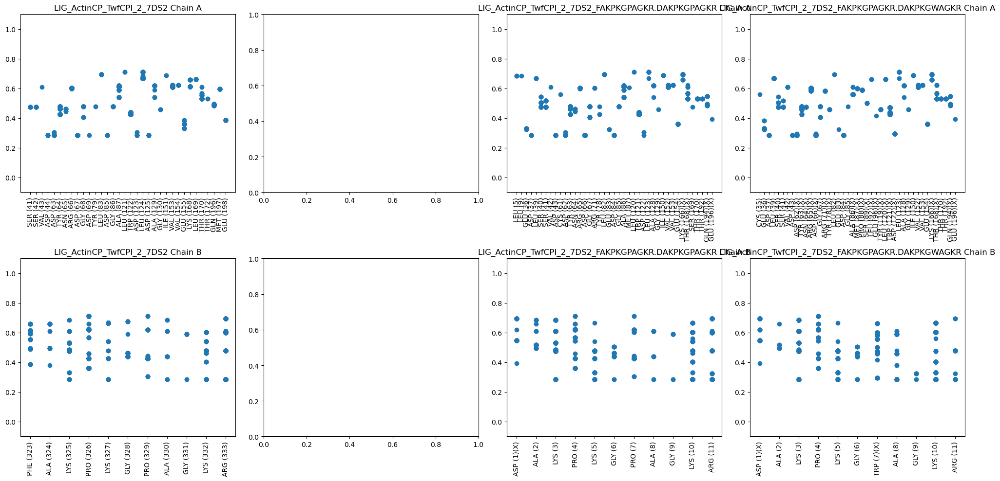

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
263,TRG_ENDOCYTIC_2_1BXX,1BXX,TRG_ENDOCYTIC_2,None,None,None,None,<Interface of 1436 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
254,MTRG_ENDOCYTIC_2_1BXX.DTRG_ER_FFAT_1_2RR3,1BXX,MTRG_ENDOCYTIC_2,2RR3,DTRG_ER_FFAT_1,None,None,<Interface of 1276 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
525,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRD,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRD,<Interface of 393 pairs>
526,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRL,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRL,<Interface of 845 pairs>


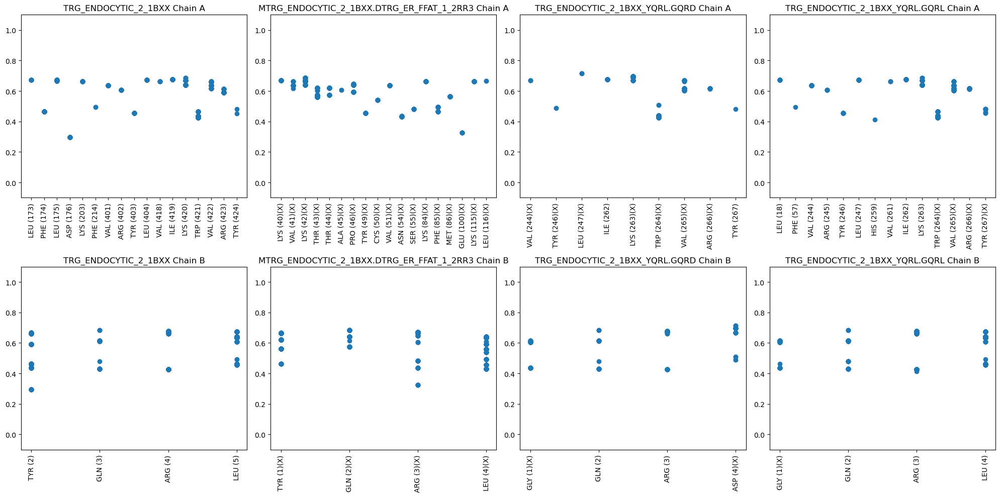

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
244,MLIG_WD40_WDR5_VDV_1_4CY2.DLIG_BIR_III_3_1JD5,4CY2,MLIG_WD40_WDR5_VDV_1,1JD5,DLIG_BIR_III_3,None,None,<Interface of 598 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
507,LIG_WD40_WDR5_VDV_1_4CY2_DLDV.DDDD,4CY2,LIG_WD40_WDR5_VDV_1,None,None,DLDV,DDDD,<Interface of 277 pairs>
508,LIG_WD40_WDR5_VDV_1_4CY2_DLDV.DLDD,4CY2,LIG_WD40_WDR5_VDV_1,None,None,DLDV,DLDD,<Interface of 628 pairs>


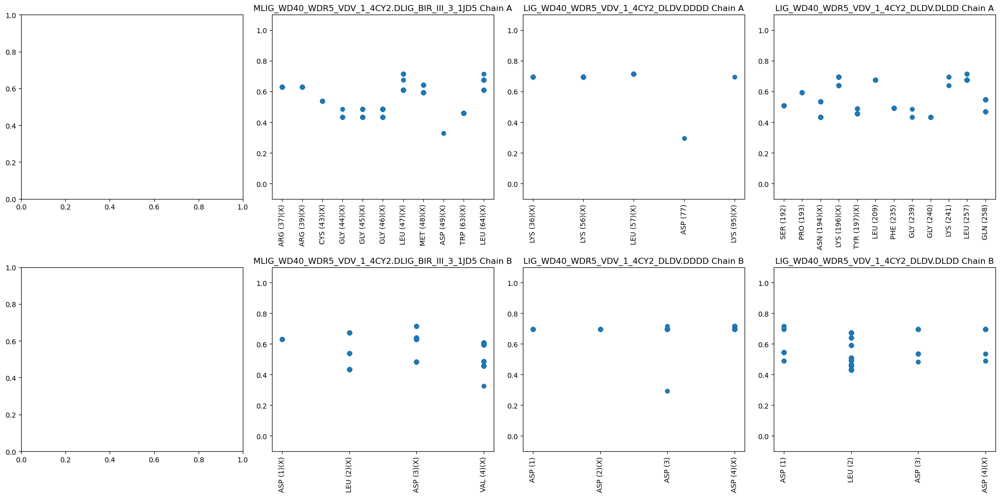

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
104,LIG_Rb_pABgroove_1_1N4M,1N4M,LIG_Rb_pABgroove_1,None,None,None,None,<Interface of 1437 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
227,MLIG_Rb_pABgroove_1_1N4M.DLIG_WD40_WDR5_WIN_1_...,1N4M,MLIG_Rb_pABgroove_1,3UVK,DLIG_WD40_WDR5_WIN_1,None,None,<Interface of 1613 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
473,LIG_Rb_pABgroove_1_1N4M_EGISDLFD.EGDSDLFD,1N4M,LIG_Rb_pABgroove_1,None,None,EGISDLFD,EGDSDLFD,<Interface of 1294 pairs>
474,LIG_Rb_pABgroove_1_1N4M_EGISDLFD.EGDSDLFW,1N4M,LIG_Rb_pABgroove_1,None,None,EGISDLFD,EGDSDLFW,<Interface of 1016 pairs>


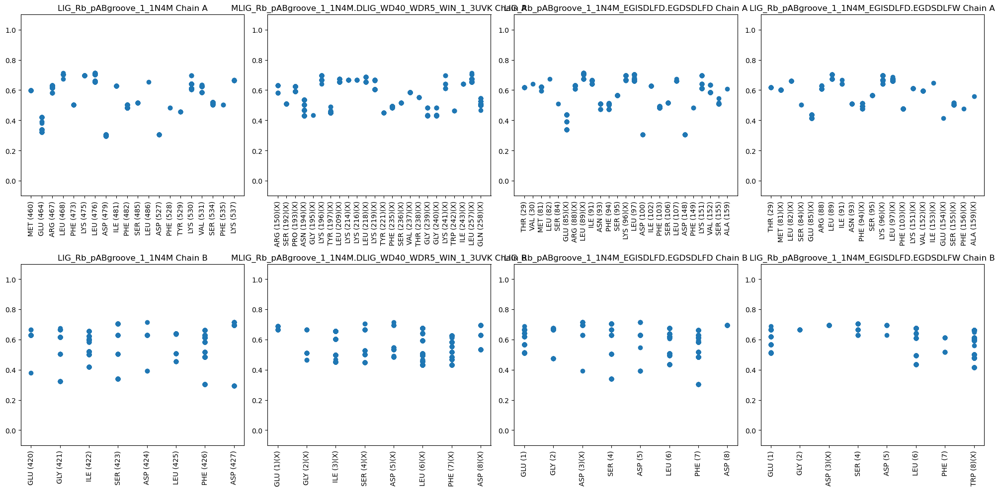

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
122,LIG_WD40_WDR5_WIN_2_4CY3,4CY3,LIG_WD40_WDR5_WIN_2,None,None,None,None,<Interface of 1759 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
511,LIG_WD40_WDR5_WIN_2_4CY3_CSRARPL.CSRAGWL,4CY3,LIG_WD40_WDR5_WIN_2,None,None,CSRARPL,CSRAGWL,<Interface of 1439 pairs>
512,LIG_WD40_WDR5_WIN_2_4CY3_CSRARPL.CSRARWL,4CY3,LIG_WD40_WDR5_WIN_2,None,None,CSRARPL,CSRARWL,<Interface of 1537 pairs>


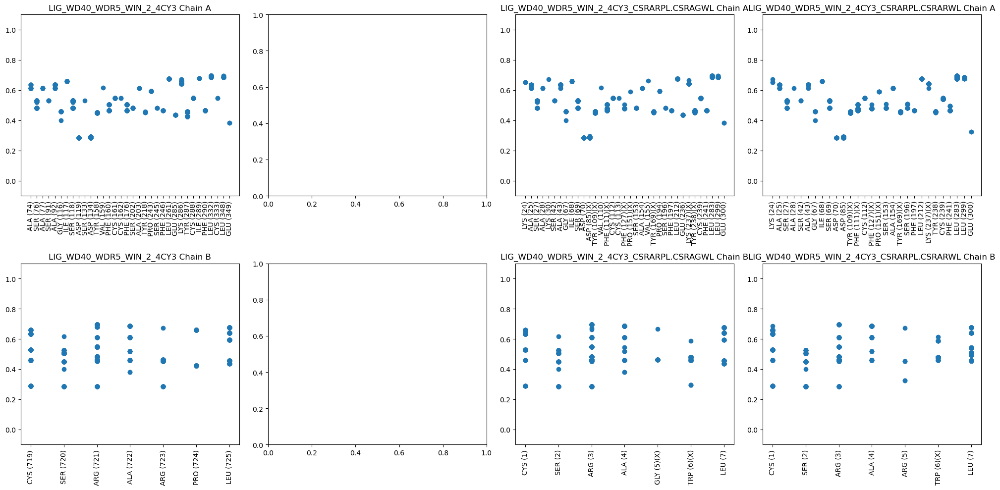

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
0,DEG_APCC_KENBOX_2_4GGD,4GGD,DEG_APCC_KENBOX_2,None,None,None,None,<Interface of 920 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
124,MDEG_APCC_KENBOX_2_4GGD.DTRG_AP2beta_CARGO_1_2G30,4GGD,MDEG_APCC_KENBOX_2,2G30,DTRG_AP2beta_CARGO_1,None,None,<Interface of 1036 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
269,DEG_APCC_KENBOX_2_4GGD_SKENV.SGENV,4GGD,DEG_APCC_KENBOX_2,None,None,SKENV,SGENV,<Interface of 771 pairs>
270,DEG_APCC_KENBOX_2_4GGD_SKENV.SGEWV,4GGD,DEG_APCC_KENBOX_2,None,None,SKENV,SGEWV,<Interface of 663 pairs>


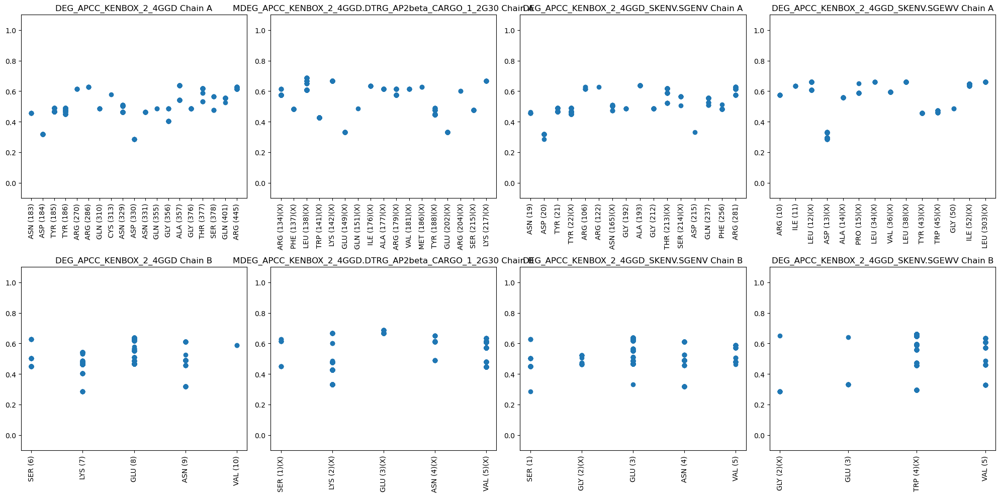

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
10,DOC_AGCK_PIF_3_1ATP,1ATP,DOC_AGCK_PIF_3,None,None,None,None,<Interface of 1160 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
134,MDOC_AGCK_PIF_3_1ATP.DDEG_Kelch_Keap1_1_2FLU,1ATP,MDOC_AGCK_PIF_3,2FLU,DDEG_Kelch_Keap1_1,None,None,<Interface of 1017 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
289,DOC_AGCK_PIF_3_1ATP_FTEF.DTED,1ATP,DOC_AGCK_PIF_3,None,None,FTEF,DTED,<Interface of 292 pairs>
290,DOC_AGCK_PIF_3_1ATP_FTEF.FTED,1ATP,DOC_AGCK_PIF_3,None,None,FTEF,FTED,<Interface of 671 pairs>


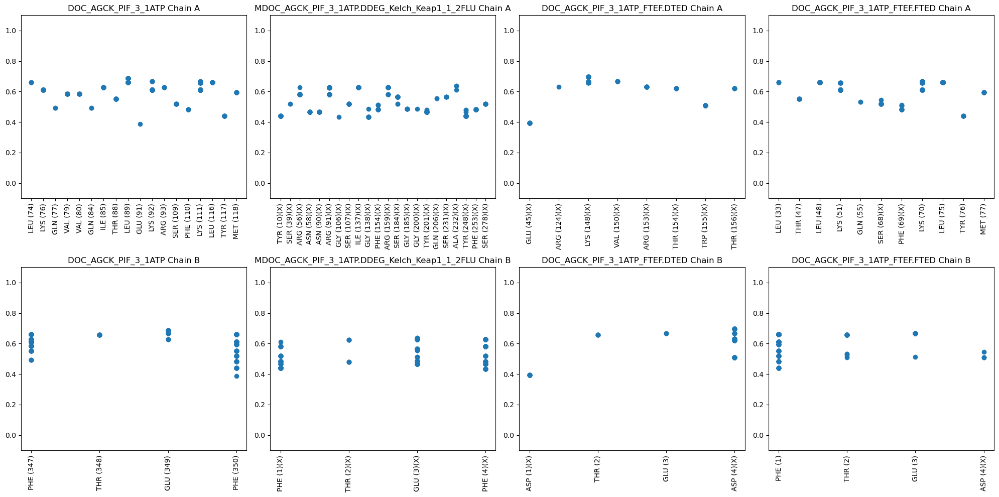

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
38,LIG_AP2alpha_1_1KY7,1KY7,LIG_AP2alpha_1,None,None,None,None,<Interface of 1140 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
161,MLIG_AP2alpha_1_1KY7.DLIG_PAM2_1_1JGN,1KY7,MLIG_AP2alpha_1,1JGN,DLIG_PAM2_1,None,None,<Interface of 488 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
345,LIG_AP2alpha_1_1KY7_FEDNF.DEDNF,1KY7,LIG_AP2alpha_1,None,None,FEDNF,DEDNF,<Interface of 566 pairs>
346,LIG_AP2alpha_1_1KY7_FEDNF.DEWNF,1KY7,LIG_AP2alpha_1,None,None,FEDNF,DEWNF,<Interface of 719 pairs>


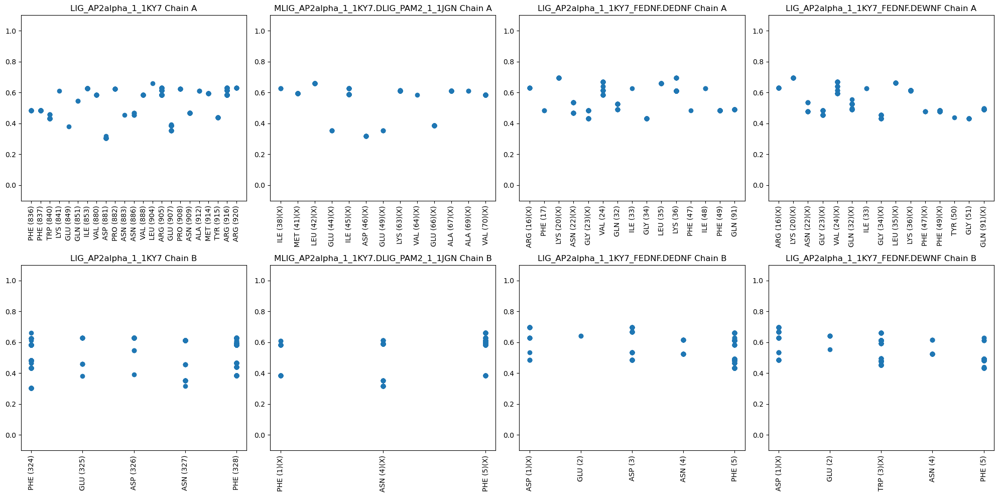

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
63,LIG_FAT_LD_1_3GM1,3GM1,LIG_FAT_LD_1,None,None,None,None,<Interface of 1264 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
186,MLIG_FAT_LD_1_3GM1.DLIG_LIR_Nem_3_5AZG,3GM1,MLIG_FAT_LD_1,5AZG,DLIG_LIR_Nem_3,None,None,<Interface of 1306 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
393,LIG_FAT_LD_1_3GM1_LDELMASLS.LDEDDASLS,3GM1,LIG_FAT_LD_1,None,None,LDELMASLS,LDEDDASLS,<Interface of 1115 pairs>
394,LIG_FAT_LD_1_3GM1_LDELMASLS.LDEDMASLS,3GM1,LIG_FAT_LD_1,None,None,LDELMASLS,LDEDMASLS,<Interface of 1250 pairs>


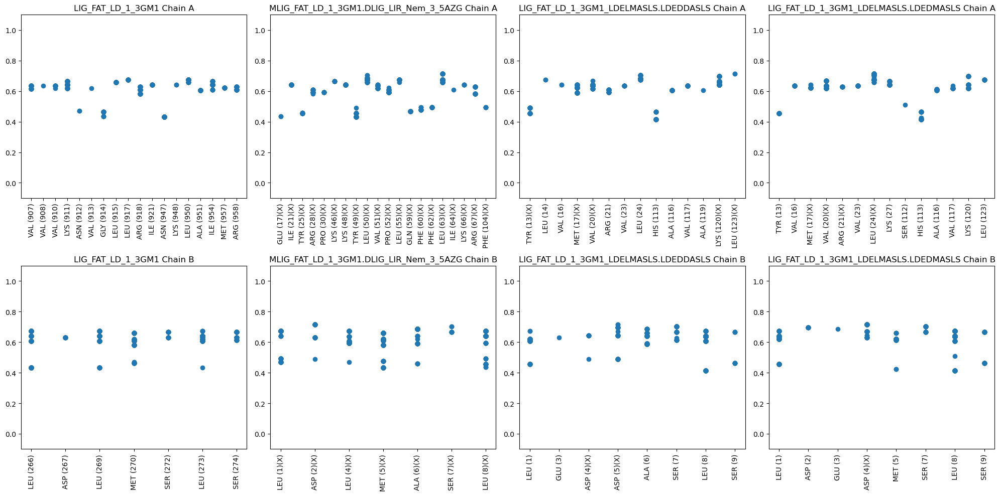

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
76,LIG_LRP6_Inhibitor_1_3SOQ,3SOQ,LIG_LRP6_Inhibitor_1,None,None,None,None,<Interface of 1360 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
199,MLIG_LRP6_Inhibitor_1_3SOQ.DTRG_NES_CRM1_1_3GB8,3SOQ,MLIG_LRP6_Inhibitor_1,3GB8,DTRG_NES_CRM1_1,None,None,<Interface of 1143 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
417,LIG_LRP6_Inhibitor_1_3SOQ_LNSNAIK.LNSNADG,3SOQ,LIG_LRP6_Inhibitor_1,None,None,LNSNAIK,LNSNADG,<Interface of 817 pairs>
418,LIG_LRP6_Inhibitor_1_3SOQ_LNSNAIK.LNSNAIG,3SOQ,LIG_LRP6_Inhibitor_1,None,None,LNSNAIK,LNSNAIG,<Interface of 883 pairs>


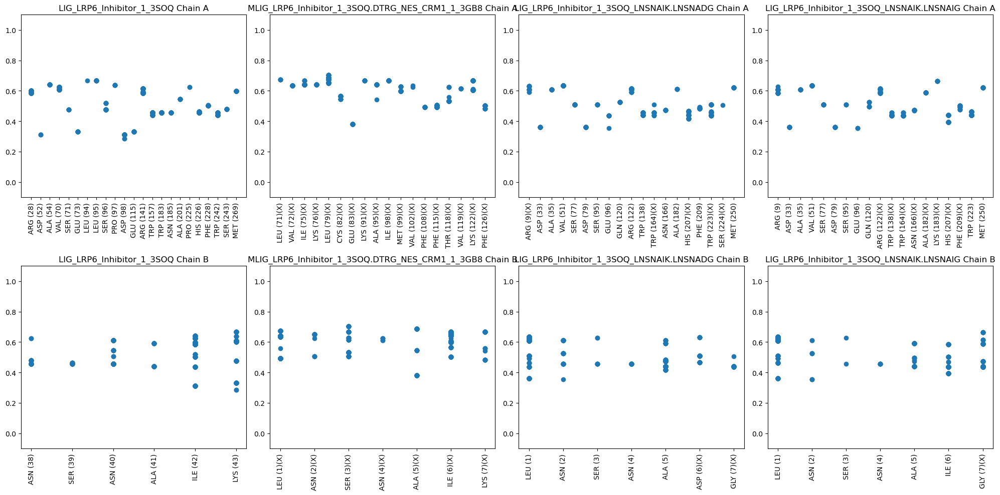

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
91,LIG_PCNA_PIPBox_1_1AXC,1AXC,LIG_PCNA_PIPBox_1,None,None,None,None,<Interface of 2158 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
214,MLIG_PCNA_PIPBox_1_1AXC.DLIG_PTB_Apo_2_1NTV,1AXC,MLIG_PCNA_PIPBox_1,1NTV,DLIG_PTB_Apo_2,None,None,<Interface of 1525 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
447,LIG_PCNA_PIPBox_1_1AXC_QTSMTDFYHS.QTSMTDDYHS,1AXC,LIG_PCNA_PIPBox_1,None,None,QTSMTDFYHS,QTSMTDDYHS,<Interface of 1733 pairs>
448,LIG_PCNA_PIPBox_1_1AXC_QTSMTDFYHS.WTSMTDDYHS,1AXC,LIG_PCNA_PIPBox_1,None,None,QTSMTDFYHS,WTSMTDDYHS,<Interface of 1412 pairs>


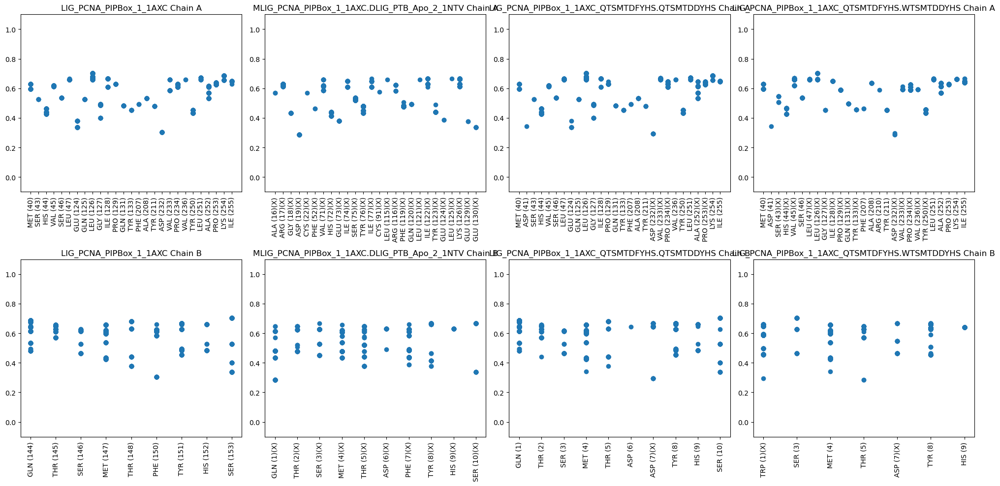

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
111,LIG_SPRY_1_2JK9,2JK9,LIG_SPRY_1,None,None,None,None,<Interface of 1168 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
233,MLIG_SPRY_1_2JK9.DLIG_BIR_III_3_1JD5,2JK9,MLIG_SPRY_1,1JD5,DLIG_BIR_III_3,None,None,<Interface of 1095 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
485,LIG_SPRY_1_2JK9_ELNNNL.ELWNNL,2JK9,LIG_SPRY_1,None,None,ELNNNL,ELWNNL,<Interface of 934 pairs>
486,LIG_SPRY_1_2JK9_ELNNNL.ELWNWL,2JK9,LIG_SPRY_1,None,None,ELNNNL,ELWNWL,<Interface of 873 pairs>


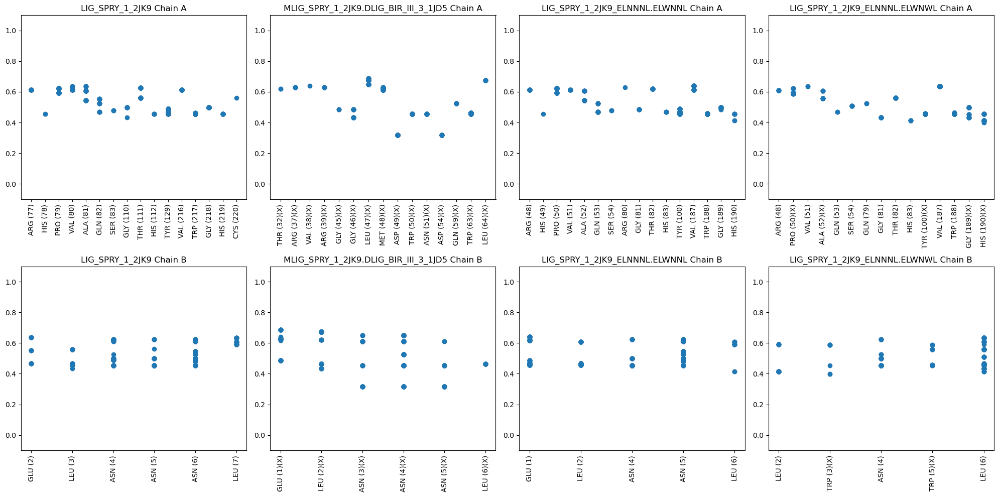

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
99,LIG_Pex14_3_4BXU,4BXU,LIG_Pex14_3,None,None,None,None,<Interface of 1187 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
222,MLIG_Pex14_3_4BXU.DLIG_Clathr_ClatBox_1_1C9I,4BXU,MLIG_Pex14_3,1C9I,DLIG_Clathr_ClatBox_1,None,None,<Interface of 1220 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
463,LIG_Pex14_3_4BXU_LVAEFL.LDAEFD,4BXU,LIG_Pex14_3,None,None,LVAEFL,LDAEFD,<Interface of 816 pairs>
464,LIG_Pex14_3_4BXU_LVAEFL.LVAEFD,4BXU,LIG_Pex14_3,None,None,LVAEFL,LVAEFD,<Interface of 428 pairs>


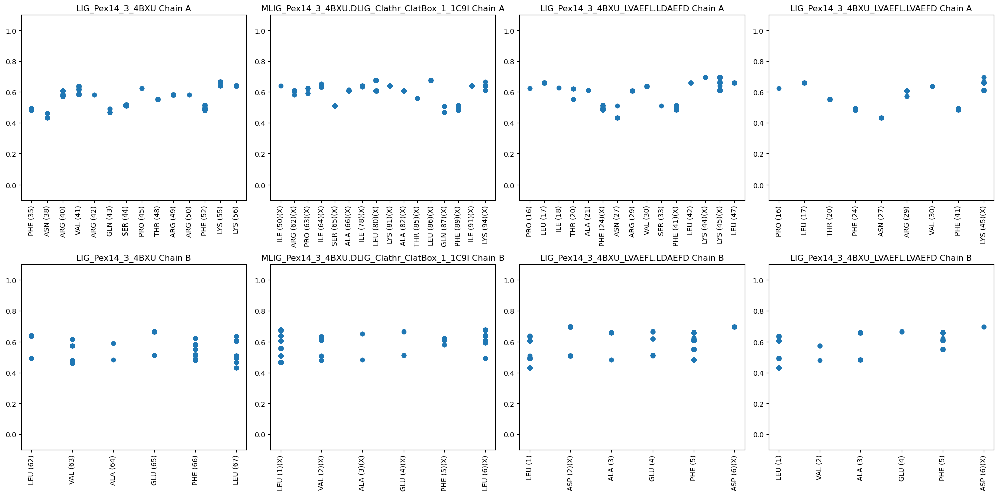

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
59,LIG_EH_1_1FF1,1FF1,LIG_EH_1,None,None,None,None,<Interface of 1325 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
181,MLIG_EH_1_1FF1.DDOC_MAPK_GRA24_9_5ETA,1FF1,MLIG_EH_1,5ETA,DDOC_MAPK_GRA24_9,None,None,<Interface of 460 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
385,LIG_EH_1_1FF1_TNPFL.TNPDL,1FF1,LIG_EH_1,None,None,TNPFL,TNPDL,<Interface of 478 pairs>
386,LIG_EH_1_1FF1_TNPFL.TWPDL,1FF1,LIG_EH_1,None,None,TNPFL,TWPDL,<Interface of 722 pairs>


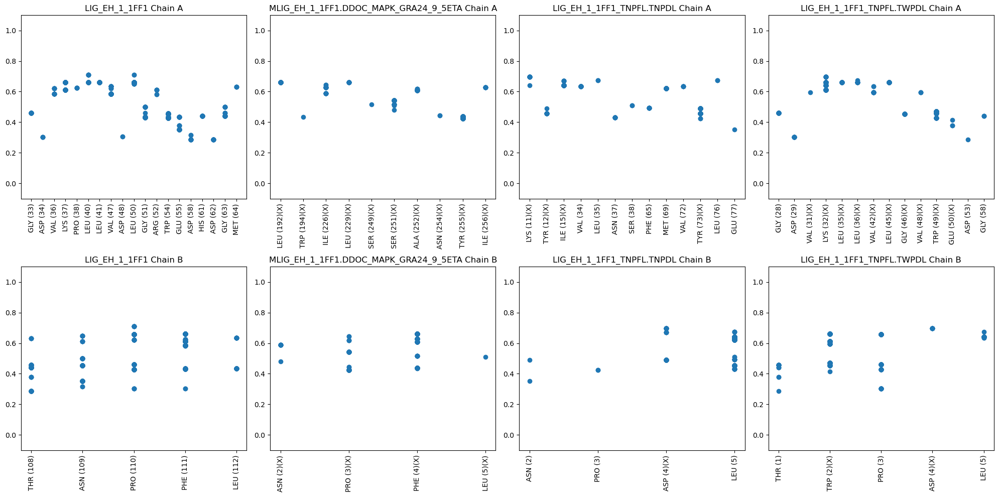

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
119,LIG_UFM1_UFIM_1_5HKH,5HKH,LIG_UFM1_UFIM_1,None,None,None,None,<Interface of 1390 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
241,MLIG_UFM1_UFIM_1_5HKH.DLIG_KLC1_Yacidic_2_6FUZ,5HKH,MLIG_UFM1_UFIM_1,6FUZ,DLIG_KLC1_Yacidic_2,None,None,<Interface of 1932 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
501,LIG_UFM1_UFIM_1_5HKH_NEWGIELV.NEWGIEDD,5HKH,LIG_UFM1_UFIM_1,None,None,NEWGIELV,NEWGIEDD,<Interface of 1121 pairs>
502,LIG_UFM1_UFIM_1_5HKH_NEWGIELV.NEWGIEDV,5HKH,LIG_UFM1_UFIM_1,None,None,NEWGIELV,NEWGIEDV,<Interface of 1127 pairs>


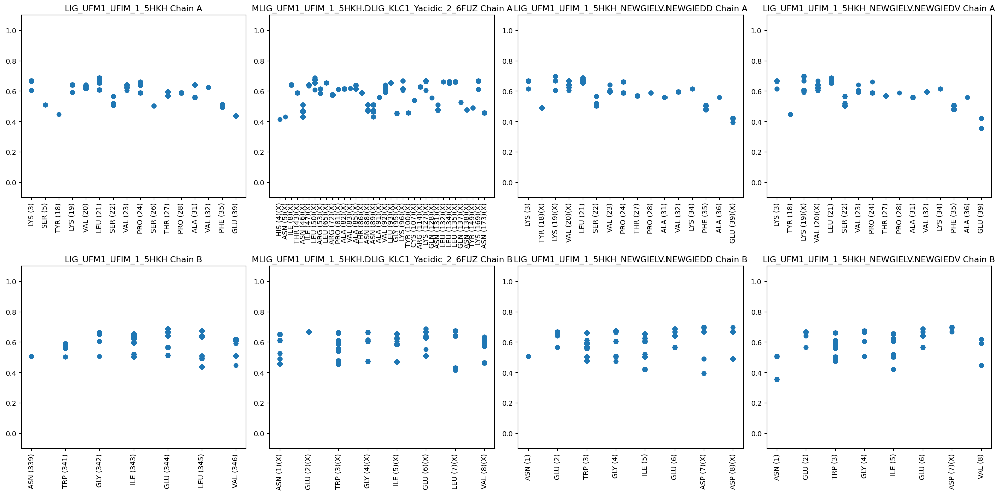

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
60,LIG_EVH1_1_1EVH,1EVH,LIG_EVH1_1,None,None,None,None,<Interface of 1141 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
183,MLIG_EVH1_1_1EVH.DLIG_Actin_WH2_1_2A41,1EVH,MLIG_EVH1_1,2A41,DLIG_Actin_WH2_1,None,None,<Interface of 926 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
387,LIG_EVH1_1_1EVH_FPPPP.DWPPP,1EVH,LIG_EVH1_1,None,None,FPPPP,DWPPP,<Interface of 888 pairs>
388,LIG_EVH1_1_1EVH_FPPPP.FWPPP,1EVH,LIG_EVH1_1,None,None,FPPPP,FWPPP,<Interface of 1046 pairs>


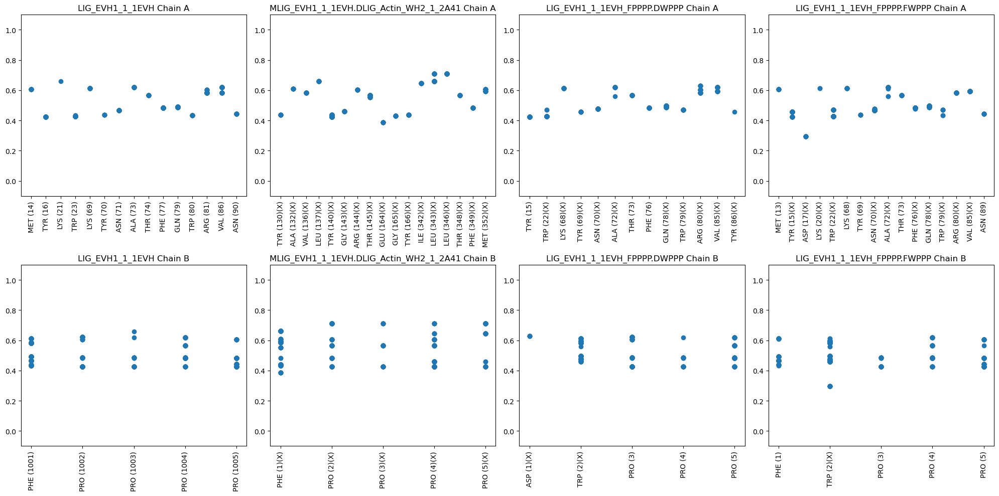

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
4,DEG_MDM2_SWIB_1_1YCR,1YCR,DEG_MDM2_SWIB_1,None,None,None,None,<Interface of 1422 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
128,MDEG_MDM2_SWIB_1_1YCR.DLIG_PCNA_APIM_2_5MLW,1YCR,MDEG_MDM2_SWIB_1,5MLW,DLIG_PCNA_APIM_2,None,None,<Interface of 1788 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
277,DEG_MDM2_SWIB_1_1YCR_FSDLWKLL.FSDLGKLD,1YCR,DEG_MDM2_SWIB_1,None,None,FSDLWKLL,FSDLGKLD,<Interface of 1208 pairs>
278,DEG_MDM2_SWIB_1_1YCR_FSDLWKLL.FSDLWKLD,1YCR,DEG_MDM2_SWIB_1,None,None,FSDLWKLL,FSDLWKLD,<Interface of 1423 pairs>


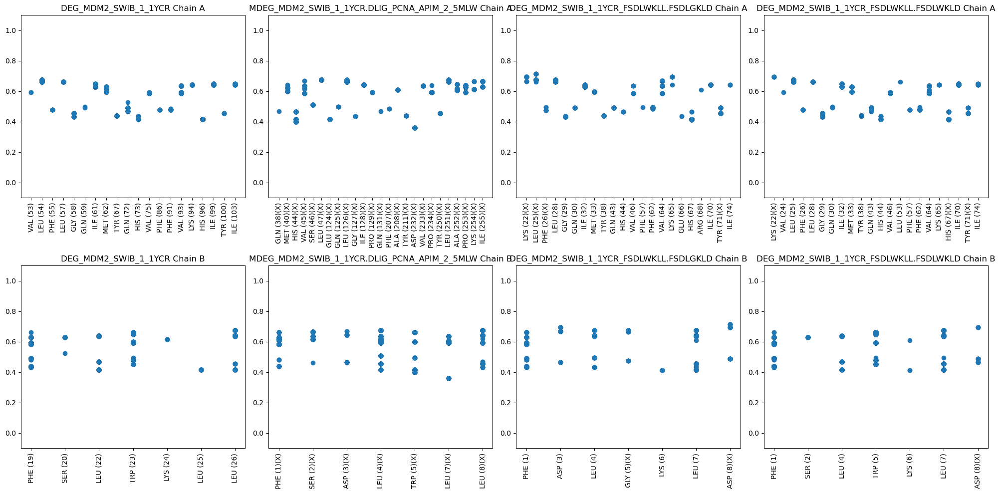

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
18,DOC_MAPK_JIP1_4_4H3B,4H3B,DOC_MAPK_JIP1_4,None,None,None,None,<Interface of 1632 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
142,MDOC_MAPK_JIP1_4_4H3B.DLIG_PAM2_1_1JGN,4H3B,MDOC_MAPK_JIP1_4,1JGN,DLIG_PAM2_1,None,None,<Interface of 687 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
305,DOC_MAPK_JIP1_4_4H3B_RPGSLDL.RWGSDDL,4H3B,DOC_MAPK_JIP1_4,None,None,RPGSLDL,RWGSDDL,<Interface of 1105 pairs>
306,DOC_MAPK_JIP1_4_4H3B_RPGSLDL.RWGSLDL,4H3B,DOC_MAPK_JIP1_4,None,None,RPGSLDL,RWGSLDL,<Interface of 1126 pairs>


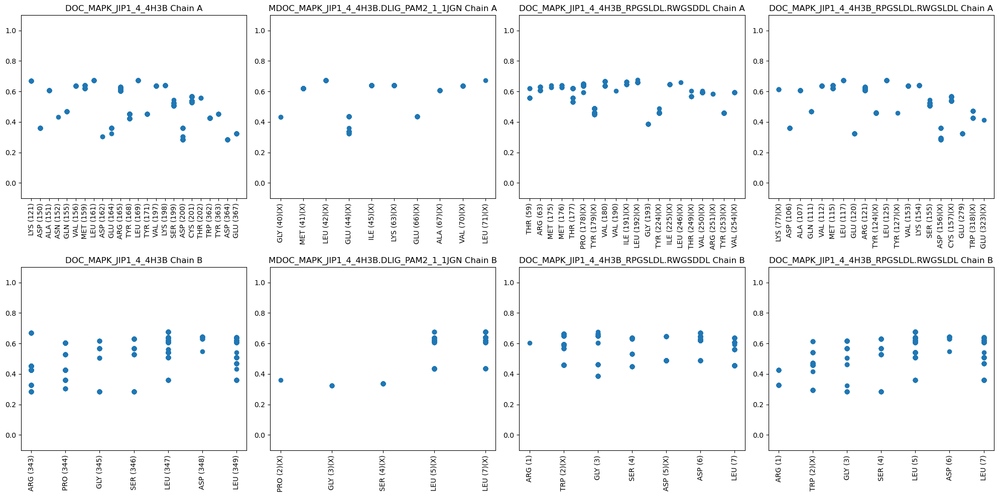

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
7,DEG_SCF_TIR1_1_2P1Q,2P1Q,DEG_SCF_TIR1_1,None,None,None,None,<Interface of 1778 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
131,MDEG_SCF_TIR1_1_2P1Q.DLIG_ULM_U2AF65_1_1O0P,2P1Q,MDEG_SCF_TIR1_1,1O0P,DLIG_ULM_U2AF65_1,None,None,<Interface of 1429 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
283,DEG_SCF_TIR1_1_2P1Q_QVVGWPPVRNYRK.QVDGWPPDRNYRK,2P1Q,DEG_SCF_TIR1_1,None,None,QVVGWPPVRNYRK,QVDGWPPDRNYRK,<Interface of 3021 pairs>
284,DEG_SCF_TIR1_1_2P1Q_QVVGWPPVRNYRK.QVDGWPPVRNYRK,2P1Q,DEG_SCF_TIR1_1,None,None,QVVGWPPVRNYRK,QVDGWPPVRNYRK,<Interface of 2426 pairs>


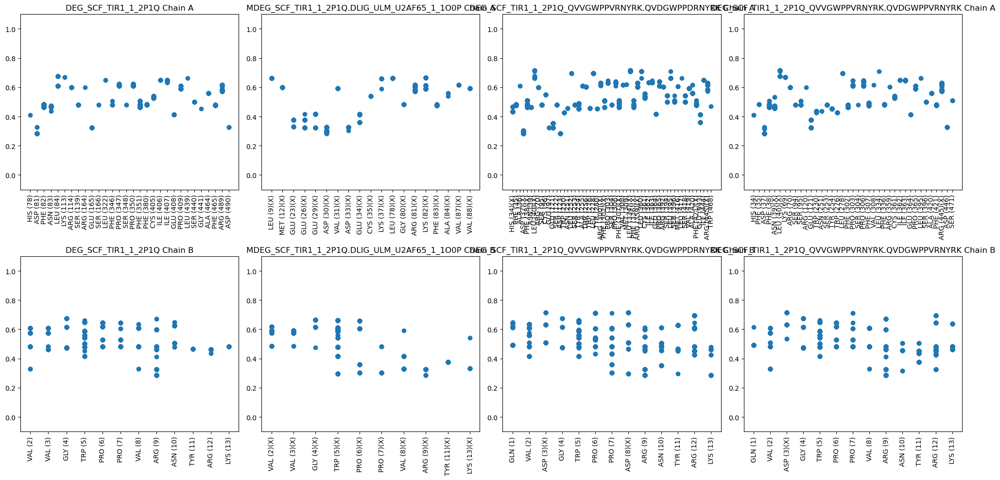

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
97,LIG_PDZ_Wminus1_1_1ZUB,1ZUB,LIG_PDZ_Wminus1_1,None,None,None,None,<Interface of 1785 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
220,MLIG_PDZ_Wminus1_1_1ZUB.DDEG_Kelch_Keap1_2_3WN7,1ZUB,MLIG_PDZ_Wminus1_1,3WN7,DDEG_Kelch_Keap1_2,None,None,<Interface of 963 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
459,LIG_PDZ_Wminus1_1_1ZUB_GIWA.GIGA,1ZUB,LIG_PDZ_Wminus1_1,None,None,GIWA,GIGA,<Interface of 1004 pairs>
460,LIG_PDZ_Wminus1_1_1ZUB_GIWA.GIGW,1ZUB,LIG_PDZ_Wminus1_1,None,None,GIWA,GIGW,<Interface of 1324 pairs>


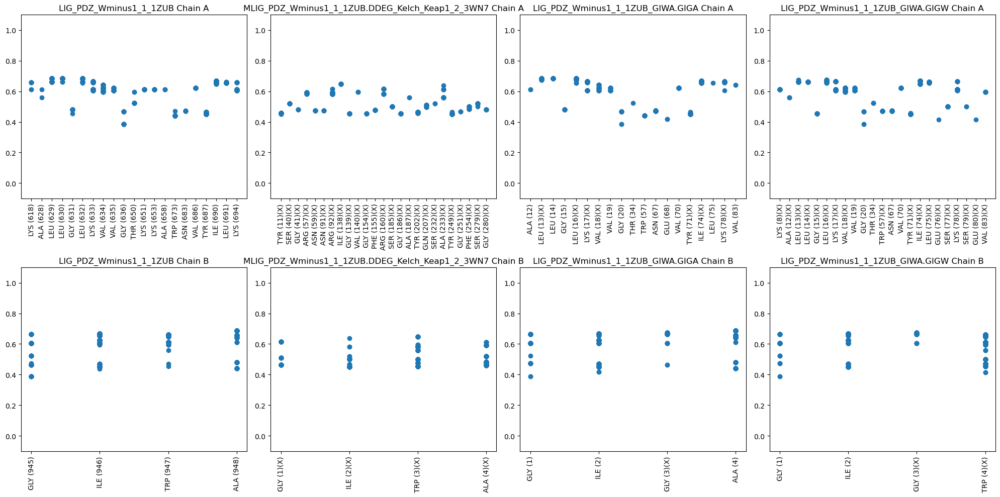

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
103,LIG_Rb_LxCxE_1_1GH6,1GH6,LIG_Rb_LxCxE_1,None,None,None,None,<Interface of 1394 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
226,MLIG_Rb_LxCxE_1_1GH6.DLIG_EVH1_1_1EVH,1GH6,MLIG_Rb_LxCxE_1,1EVH,DLIG_EVH1_1,None,None,<Interface of 1396 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
471,LIG_Rb_LxCxE_1_1GH6_ENLFCSEEMPSSDDEAT.ENLFCSEE...,1GH6,LIG_Rb_LxCxE_1,None,None,ENLFCSEEMPSSDDEAT,ENLFCSEEMPSSDDEAW,<Interface of 2213 pairs>
472,LIG_Rb_LxCxE_1_1GH6_ENLFCSEEMPSSDDEAT.ENLFCSEE...,1GH6,LIG_Rb_LxCxE_1,None,None,ENLFCSEEMPSSDDEAT,ENLFCSEEMWSSDDEAW,<Interface of 2089 pairs>


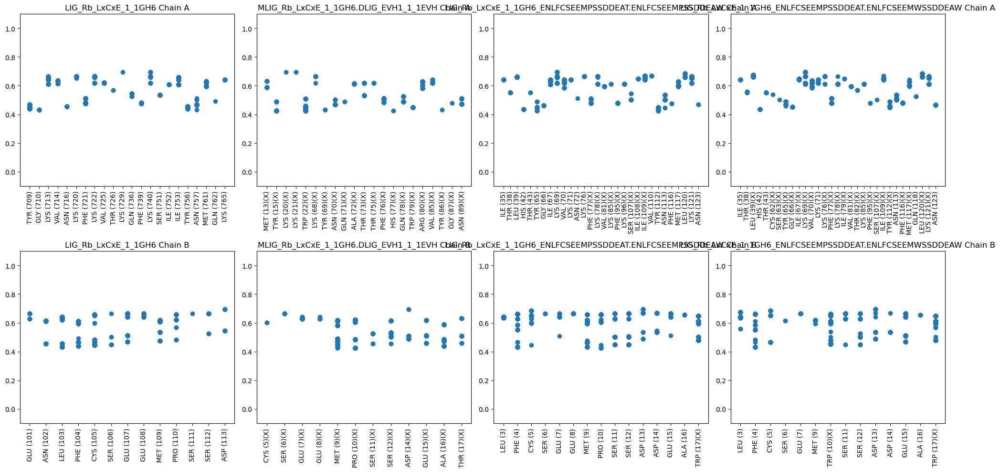

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
265,TRG_LysEnd_GGAAcLL_1_1JWG,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,None,None,<Interface of 1797 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
256,MTRG_LysEnd_GGAAcLL_1_1JWG.DLIG_SUMO_SIM_anti_...,1JWG,MTRG_LysEnd_GGAAcLL_1,2KQS,DLIG_SUMO_SIM_anti_2,None,None,<Interface of 1285 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
529,TRG_LysEnd_GGAAcLL_1_1JWG_DEDLLHI.DEDLDHI,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,DEDLLHI,DEDLDHI,<Interface of 1459 pairs>
530,TRG_LysEnd_GGAAcLL_1_1JWG_DEDLLHI.WEDLDHI,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,DEDLLHI,WEDLDHI,<Interface of 1259 pairs>


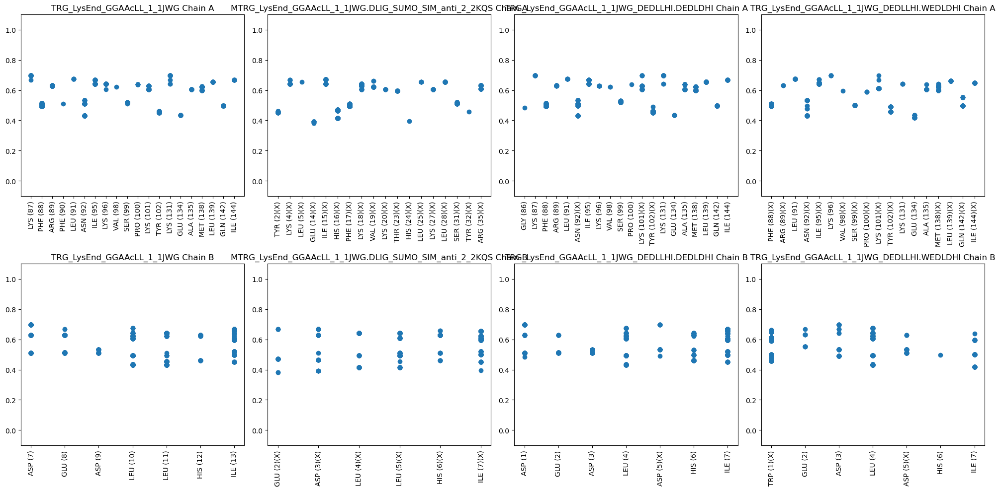

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
72,LIG_LIR_Apic_2_4EOY,4EOY,LIG_LIR_Apic_2,None,None,None,None,<Interface of 1383 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
195,MLIG_LIR_Apic_2_4EOY.DLIG_Sin3_1_1PD7,4EOY,MLIG_LIR_Apic_2,1PD7,DLIG_Sin3_1,None,None,<Interface of 663 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
409,LIG_LIR_Apic_2_4EOY_NDWLLP.NWWLLP,4EOY,LIG_LIR_Apic_2,None,None,NDWLLP,NWWLLP,<Interface of 1741 pairs>
410,LIG_LIR_Apic_2_4EOY_NDWLLP.NWWLLW,4EOY,LIG_LIR_Apic_2,None,None,NDWLLP,NWWLLW,<Interface of 1663 pairs>


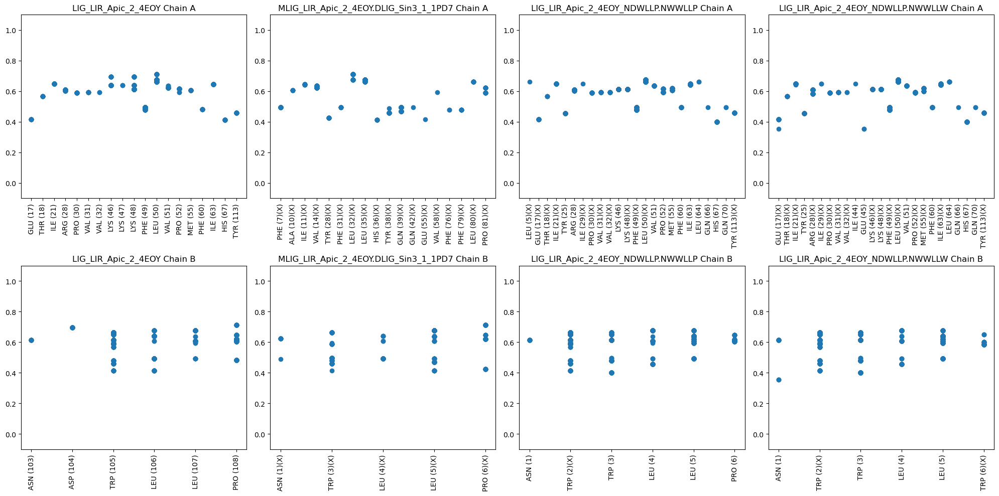

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
87,LIG_PALB2_WD40_1_3EU7,3EU7,LIG_PALB2_WD40_1,None,None,None,None,<Interface of 1450 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
210,MLIG_PALB2_WD40_1_3EU7.DLIG_Actin_RPEL_3_2V52,3EU7,MLIG_PALB2_WD40_1,2V52,DLIG_Actin_RPEL_3,None,None,<Interface of 1141 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
439,LIG_PALB2_WD40_1_3EU7_ISLNWFEEL.ISLNWDEED,3EU7,LIG_PALB2_WD40_1,None,None,ISLNWFEEL,ISLNWDEED,<Interface of 1524 pairs>
440,LIG_PALB2_WD40_1_3EU7_ISLNWFEEL.ISLNWDEEL,3EU7,LIG_PALB2_WD40_1,None,None,ISLNWFEEL,ISLNWDEEL,<Interface of 1392 pairs>


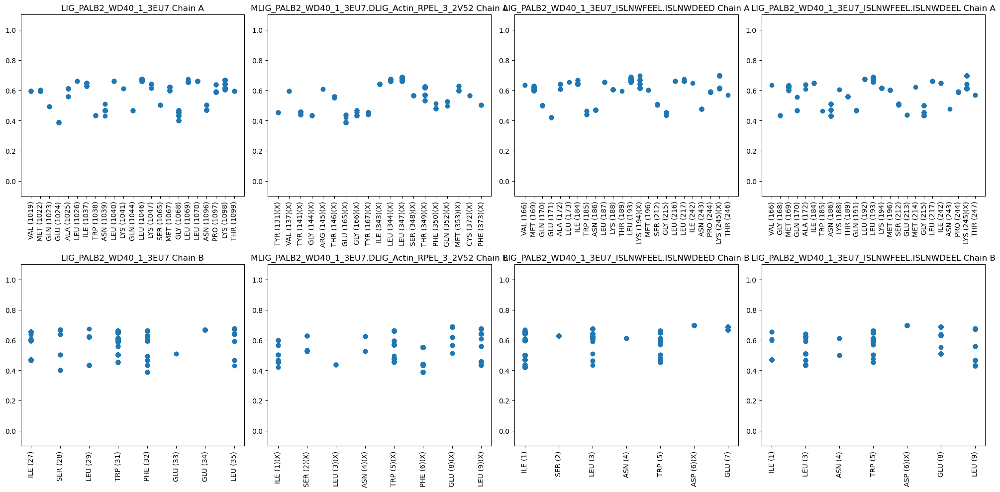

2


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
55,LIG_DLG_GKlike_1_3WP0,3WP0,LIG_DLG_GKlike_1,None,None,None,None,<Interface of 1007 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
178,MLIG_DLG_GKlike_1_3WP0.DTRG_ER_FFAT_1_2RR3,3WP0,MLIG_DLG_GKlike_1,2RR3,DTRG_ER_FFAT_1,None,None,<Interface of 1298 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


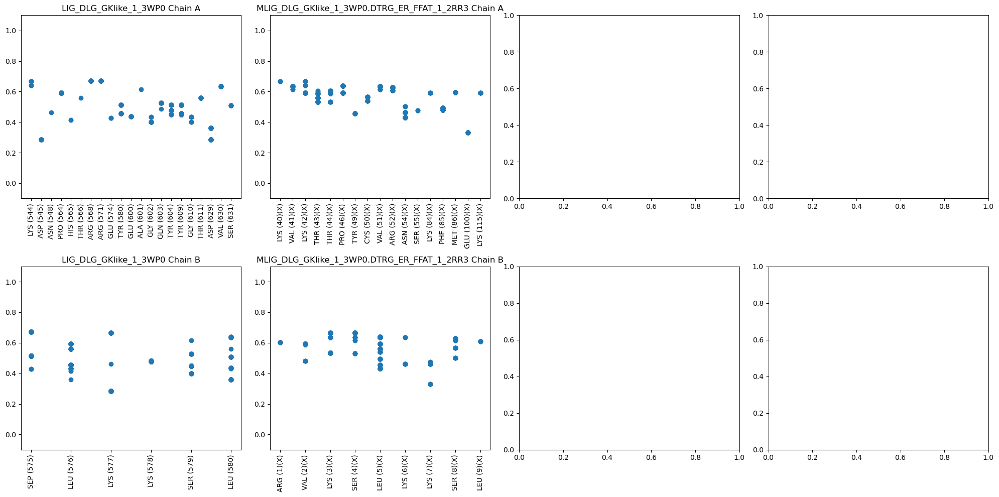

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
42,LIG_BH_BH3_1_2ROC,2ROC,LIG_BH_BH3_1,None,None,None,None,<Interface of 2468 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
165,MLIG_BH_BH3_1_2ROC.DLIG_Actin_WH2_2_2D1K,2ROC,MLIG_BH_BH3_1,2D1K,DLIG_Actin_WH2_2,None,None,<Interface of 1403 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
353,LIG_BH_BH3_1_2ROC_WAREIGAQLRRIADDLN.WAREIGAQLR...,2ROC,LIG_BH_BH3_1,None,None,WAREIGAQLRRIADDLN,WAREIGAQLRRDADDLN,<Interface of 2602 pairs>
354,LIG_BH_BH3_1_2ROC_WAREIGAQLRRIADDLN.WAREIGAQLR...,2ROC,LIG_BH_BH3_1,None,None,WAREIGAQLRRIADDLN,WAREIGAQLRRDWDDLN,<Interface of 2705 pairs>


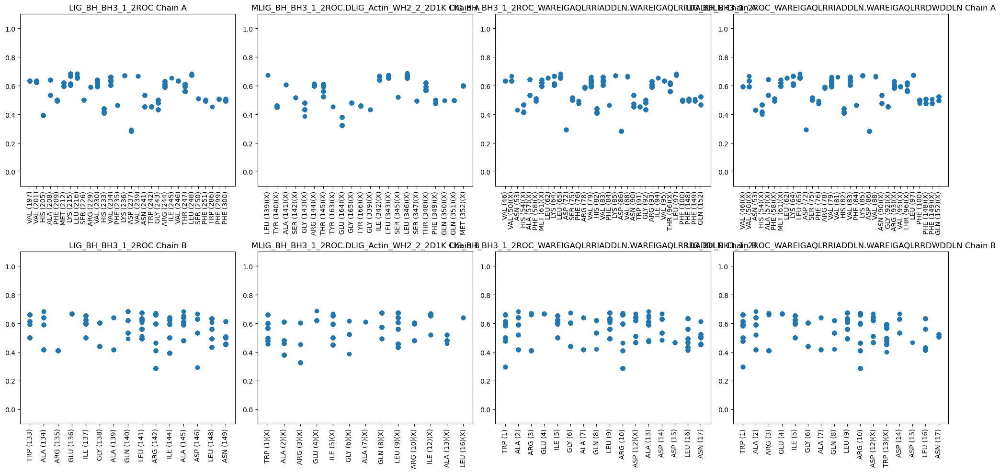

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
109,LIG_SH3_CIN85_PxpxPR_1_2BZ8,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,None,None,<Interface of 999 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
232,MLIG_SH3_CIN85_PxpxPR_1_2BZ8.DLIG_PAM2_1_1JGN,2BZ8,MLIG_SH3_CIN85_PxpxPR_1,1JGN,DLIG_PAM2_1,None,None,<Interface of 265 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
483,LIG_SH3_CIN85_PxpxPR_1_2BZ8_PKPRPR.PKPRPG,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,PKPRPR,PKPRPG,<Interface of 1007 pairs>
484,LIG_SH3_CIN85_PxpxPR_1_2BZ8_PKPRPR.PKPRWG,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,PKPRPR,PKPRWG,<Interface of 849 pairs>


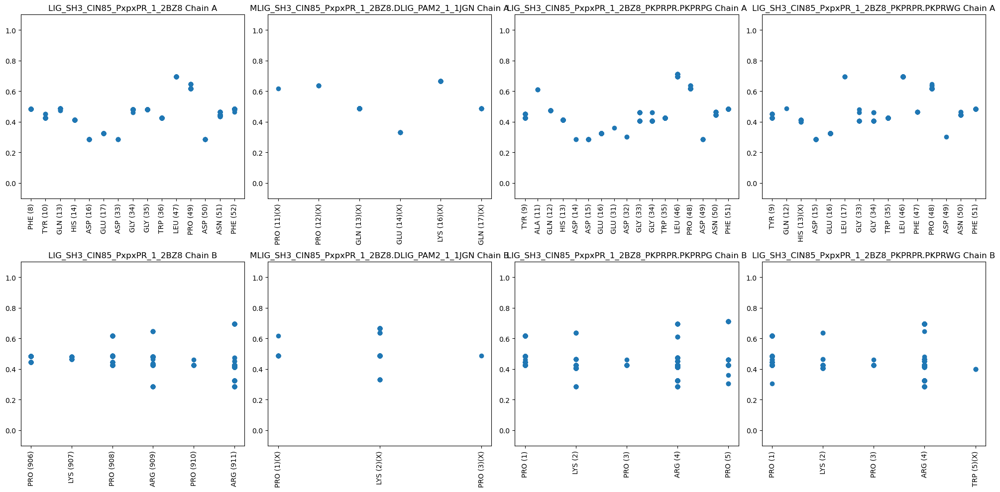

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
113,LIG_SUMO_SIM_anti_2_2KQS,2KQS,LIG_SUMO_SIM_anti_2,None,None,None,None,<Interface of 1850 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
235,MLIG_SUMO_SIM_anti_2_2KQS.DLIG_APCC_ABBA_1_4BH6,2KQS,MLIG_SUMO_SIM_anti_2,4BH6,DLIG_APCC_ABBA_1,None,None,<Interface of 965 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
489,LIG_SUMO_SIM_anti_2_2KQS_EIIVLSDSD.EIDVLSDWD,2KQS,LIG_SUMO_SIM_anti_2,None,None,EIIVLSDSD,EIDVLSDWD,<Interface of 1422 pairs>
490,LIG_SUMO_SIM_anti_2_2KQS_EIIVLSDSD.EIIVLSDWD,2KQS,LIG_SUMO_SIM_anti_2,None,None,EIIVLSDSD,EIIVLSDWD,<Interface of 1766 pairs>


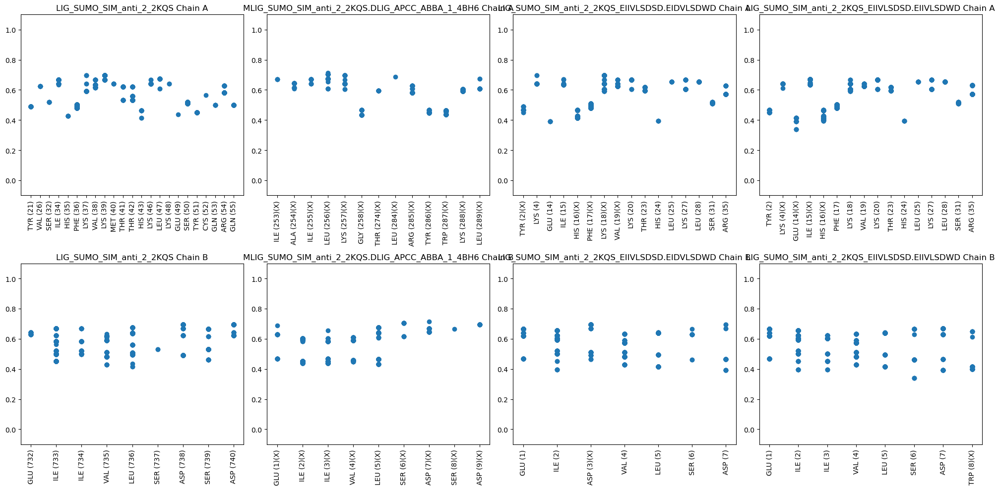

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
157,MLIG_Actin_RPEL_3_2V52.DLIG_ActinCP_TwfCPI_2_7DS2,2V52,MLIG_Actin_RPEL_3,7DS2,DLIG_ActinCP_TwfCPI_2,None,None,<Interface of 3866 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
337,LIG_Actin_RPEL_3_2V52_LKRKIRSRPERAELVRMHIL.LKR...,2V52,LIG_Actin_RPEL_3,None,None,LKRKIRSRPERAELVRMHIL,LKRKIRSGPERAELVRMHDL,<Interface of 1772 pairs>
338,LIG_Actin_RPEL_3_2V52_LKRKIRSRPERAELVRMHIL.LKR...,2V52,LIG_Actin_RPEL_3,None,None,LKRKIRSRPERAELVRMHIL,LKRKIRSGPERAELVRMHIL,<Interface of 1553 pairs>


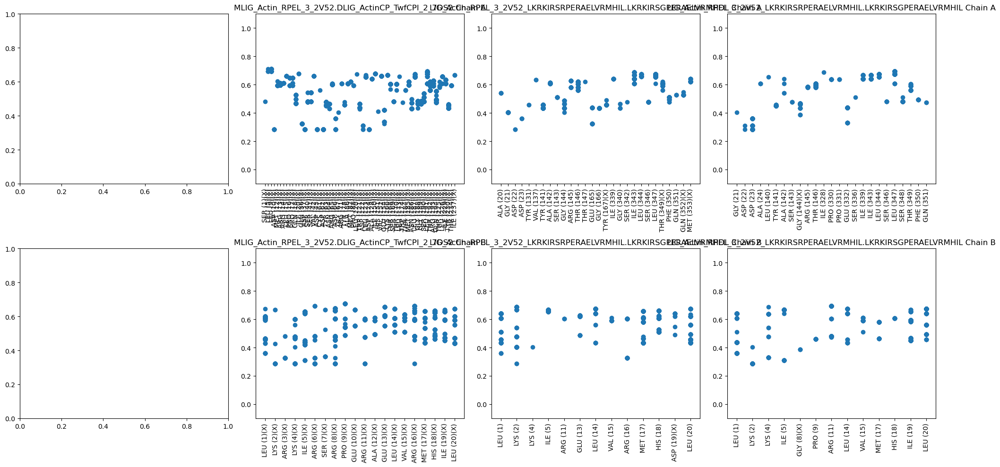

In [73]:
for pdb_id in pdb_ids_test:
    visualize_interface(pdb_id)

Run with residues + distance

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
33,LIG_ActinCP_TwfCPI_2_7DS2,7DS2,LIG_ActinCP_TwfCPI_2,None,None,None,None,<Interface of 1972 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
335,LIG_ActinCP_TwfCPI_2_7DS2_FAKPKGPAGKR.DAKPKGPAGKR,7DS2,LIG_ActinCP_TwfCPI_2,None,None,FAKPKGPAGKR,DAKPKGPAGKR,<Interface of 1907 pairs>
336,LIG_ActinCP_TwfCPI_2_7DS2_FAKPKGPAGKR.DAKPKGWAGKR,7DS2,LIG_ActinCP_TwfCPI_2,None,None,FAKPKGPAGKR,DAKPKGWAGKR,<Interface of 2131 pairs>


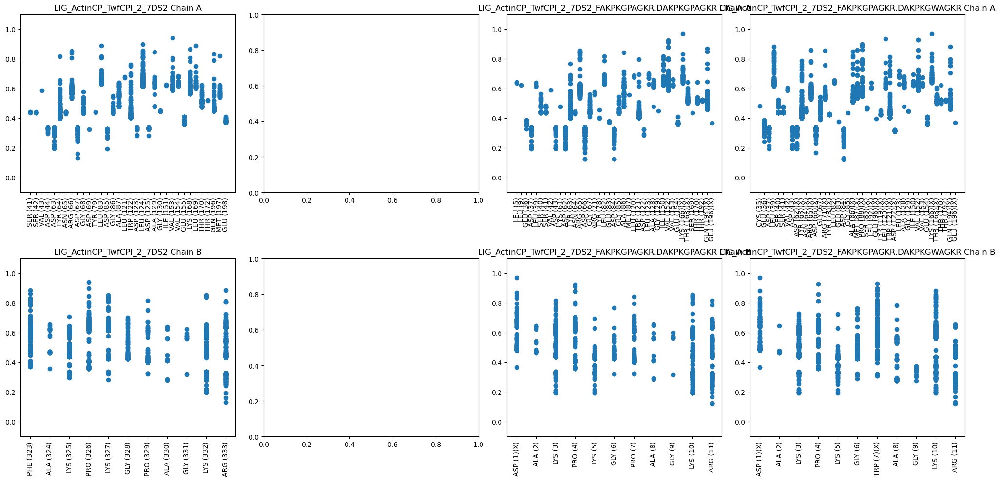

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
263,TRG_ENDOCYTIC_2_1BXX,1BXX,TRG_ENDOCYTIC_2,None,None,None,None,<Interface of 1436 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
254,MTRG_ENDOCYTIC_2_1BXX.DTRG_ER_FFAT_1_2RR3,1BXX,MTRG_ENDOCYTIC_2,2RR3,DTRG_ER_FFAT_1,None,None,<Interface of 1276 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
525,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRD,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRD,<Interface of 393 pairs>
526,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRL,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRL,<Interface of 845 pairs>


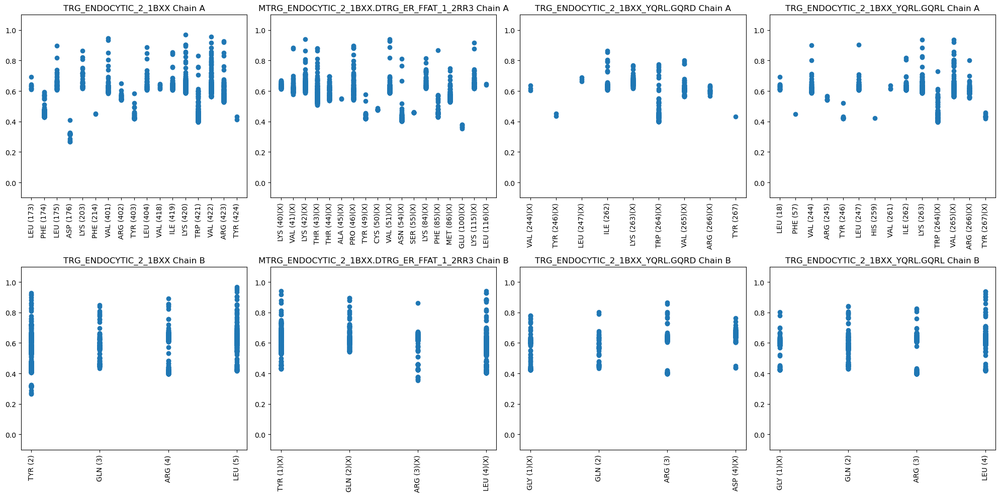

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
244,MLIG_WD40_WDR5_VDV_1_4CY2.DLIG_BIR_III_3_1JD5,4CY2,MLIG_WD40_WDR5_VDV_1,1JD5,DLIG_BIR_III_3,None,None,<Interface of 598 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
507,LIG_WD40_WDR5_VDV_1_4CY2_DLDV.DDDD,4CY2,LIG_WD40_WDR5_VDV_1,None,None,DLDV,DDDD,<Interface of 277 pairs>
508,LIG_WD40_WDR5_VDV_1_4CY2_DLDV.DLDD,4CY2,LIG_WD40_WDR5_VDV_1,None,None,DLDV,DLDD,<Interface of 628 pairs>


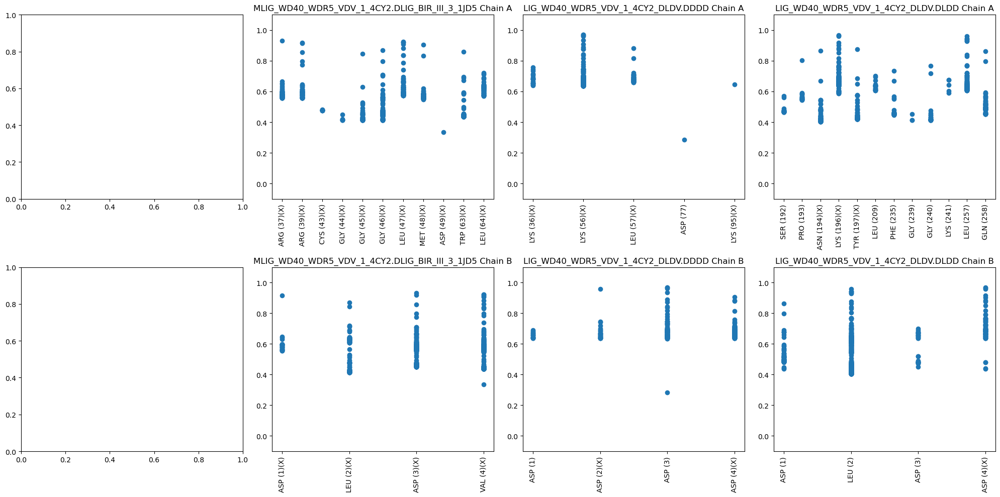

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
104,LIG_Rb_pABgroove_1_1N4M,1N4M,LIG_Rb_pABgroove_1,None,None,None,None,<Interface of 1437 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
227,MLIG_Rb_pABgroove_1_1N4M.DLIG_WD40_WDR5_WIN_1_...,1N4M,MLIG_Rb_pABgroove_1,3UVK,DLIG_WD40_WDR5_WIN_1,None,None,<Interface of 1613 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
473,LIG_Rb_pABgroove_1_1N4M_EGISDLFD.EGDSDLFD,1N4M,LIG_Rb_pABgroove_1,None,None,EGISDLFD,EGDSDLFD,<Interface of 1294 pairs>
474,LIG_Rb_pABgroove_1_1N4M_EGISDLFD.EGDSDLFW,1N4M,LIG_Rb_pABgroove_1,None,None,EGISDLFD,EGDSDLFW,<Interface of 1016 pairs>


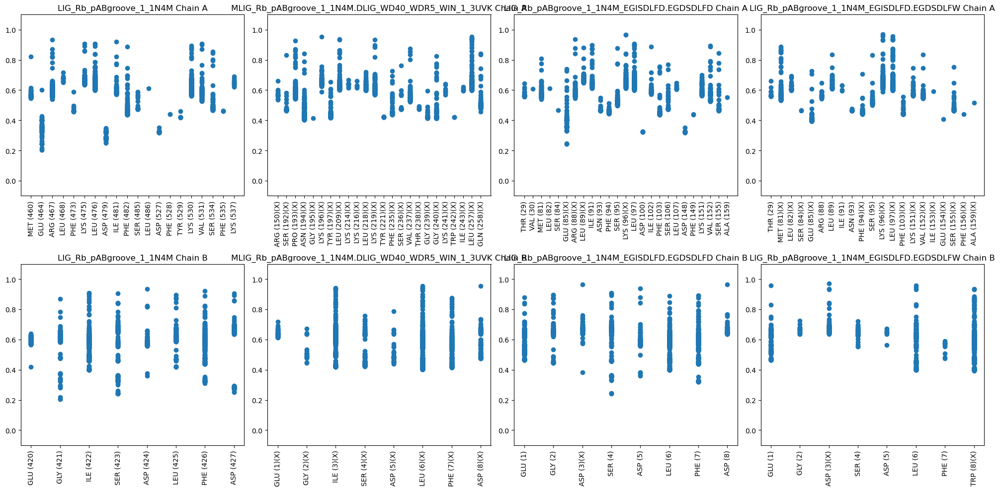

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
122,LIG_WD40_WDR5_WIN_2_4CY3,4CY3,LIG_WD40_WDR5_WIN_2,None,None,None,None,<Interface of 1759 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
511,LIG_WD40_WDR5_WIN_2_4CY3_CSRARPL.CSRAGWL,4CY3,LIG_WD40_WDR5_WIN_2,None,None,CSRARPL,CSRAGWL,<Interface of 1439 pairs>
512,LIG_WD40_WDR5_WIN_2_4CY3_CSRARPL.CSRARWL,4CY3,LIG_WD40_WDR5_WIN_2,None,None,CSRARPL,CSRARWL,<Interface of 1537 pairs>


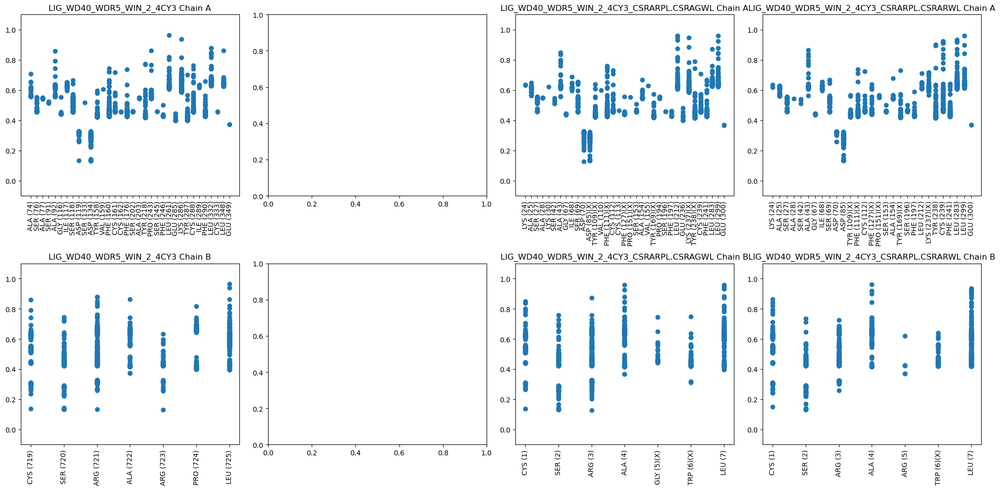

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
0,DEG_APCC_KENBOX_2_4GGD,4GGD,DEG_APCC_KENBOX_2,None,None,None,None,<Interface of 920 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
124,MDEG_APCC_KENBOX_2_4GGD.DTRG_AP2beta_CARGO_1_2G30,4GGD,MDEG_APCC_KENBOX_2,2G30,DTRG_AP2beta_CARGO_1,None,None,<Interface of 1036 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
269,DEG_APCC_KENBOX_2_4GGD_SKENV.SGENV,4GGD,DEG_APCC_KENBOX_2,None,None,SKENV,SGENV,<Interface of 771 pairs>
270,DEG_APCC_KENBOX_2_4GGD_SKENV.SGEWV,4GGD,DEG_APCC_KENBOX_2,None,None,SKENV,SGEWV,<Interface of 663 pairs>


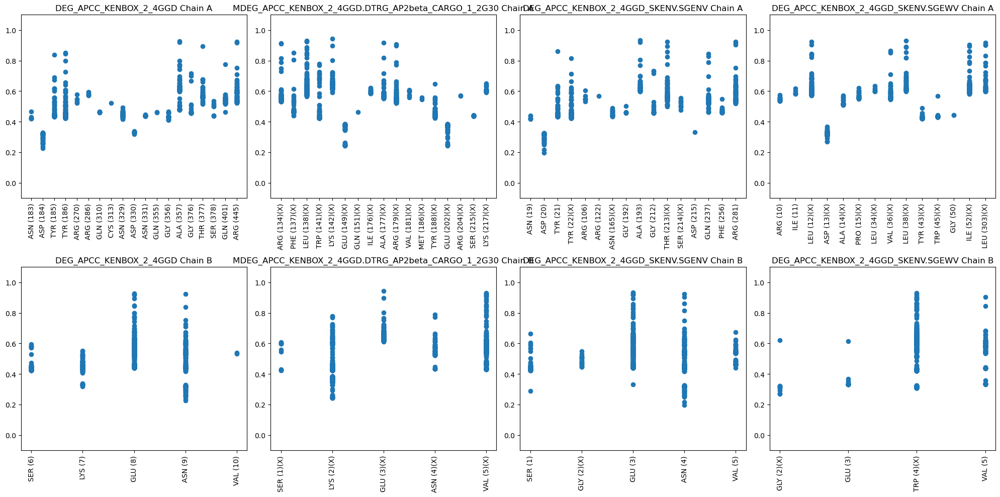

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
10,DOC_AGCK_PIF_3_1ATP,1ATP,DOC_AGCK_PIF_3,None,None,None,None,<Interface of 1160 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
134,MDOC_AGCK_PIF_3_1ATP.DDEG_Kelch_Keap1_1_2FLU,1ATP,MDOC_AGCK_PIF_3,2FLU,DDEG_Kelch_Keap1_1,None,None,<Interface of 1017 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
289,DOC_AGCK_PIF_3_1ATP_FTEF.DTED,1ATP,DOC_AGCK_PIF_3,None,None,FTEF,DTED,<Interface of 292 pairs>
290,DOC_AGCK_PIF_3_1ATP_FTEF.FTED,1ATP,DOC_AGCK_PIF_3,None,None,FTEF,FTED,<Interface of 671 pairs>


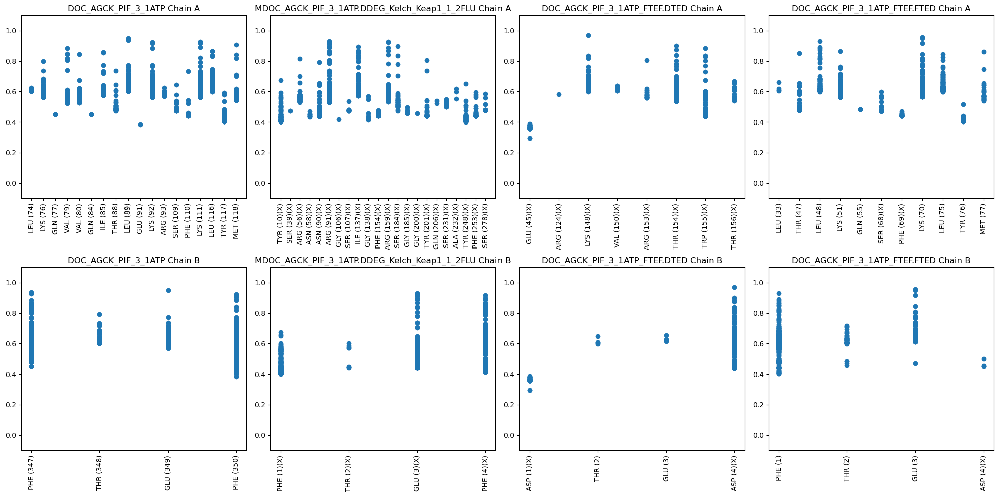

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
38,LIG_AP2alpha_1_1KY7,1KY7,LIG_AP2alpha_1,None,None,None,None,<Interface of 1140 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
161,MLIG_AP2alpha_1_1KY7.DLIG_PAM2_1_1JGN,1KY7,MLIG_AP2alpha_1,1JGN,DLIG_PAM2_1,None,None,<Interface of 488 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
345,LIG_AP2alpha_1_1KY7_FEDNF.DEDNF,1KY7,LIG_AP2alpha_1,None,None,FEDNF,DEDNF,<Interface of 566 pairs>
346,LIG_AP2alpha_1_1KY7_FEDNF.DEWNF,1KY7,LIG_AP2alpha_1,None,None,FEDNF,DEWNF,<Interface of 719 pairs>


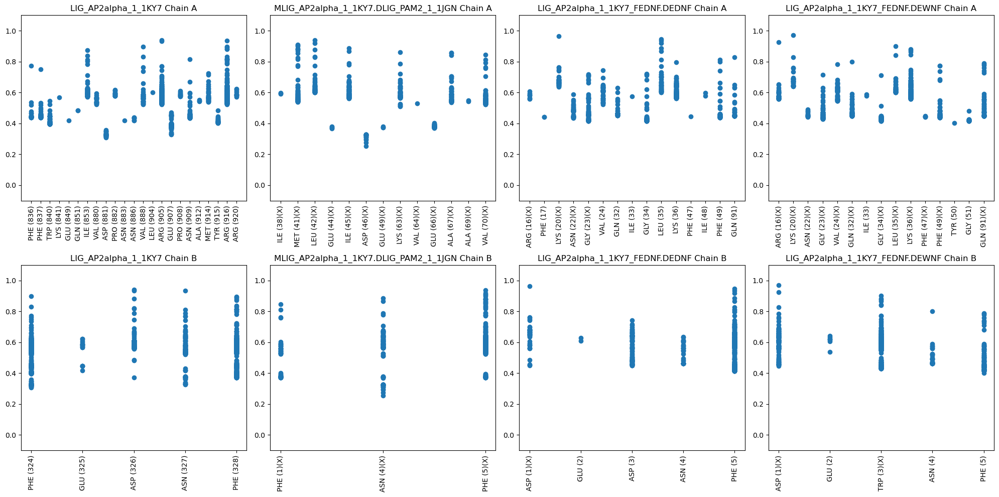

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
63,LIG_FAT_LD_1_3GM1,3GM1,LIG_FAT_LD_1,None,None,None,None,<Interface of 1264 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
186,MLIG_FAT_LD_1_3GM1.DLIG_LIR_Nem_3_5AZG,3GM1,MLIG_FAT_LD_1,5AZG,DLIG_LIR_Nem_3,None,None,<Interface of 1306 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
393,LIG_FAT_LD_1_3GM1_LDELMASLS.LDEDDASLS,3GM1,LIG_FAT_LD_1,None,None,LDELMASLS,LDEDDASLS,<Interface of 1115 pairs>
394,LIG_FAT_LD_1_3GM1_LDELMASLS.LDEDMASLS,3GM1,LIG_FAT_LD_1,None,None,LDELMASLS,LDEDMASLS,<Interface of 1250 pairs>


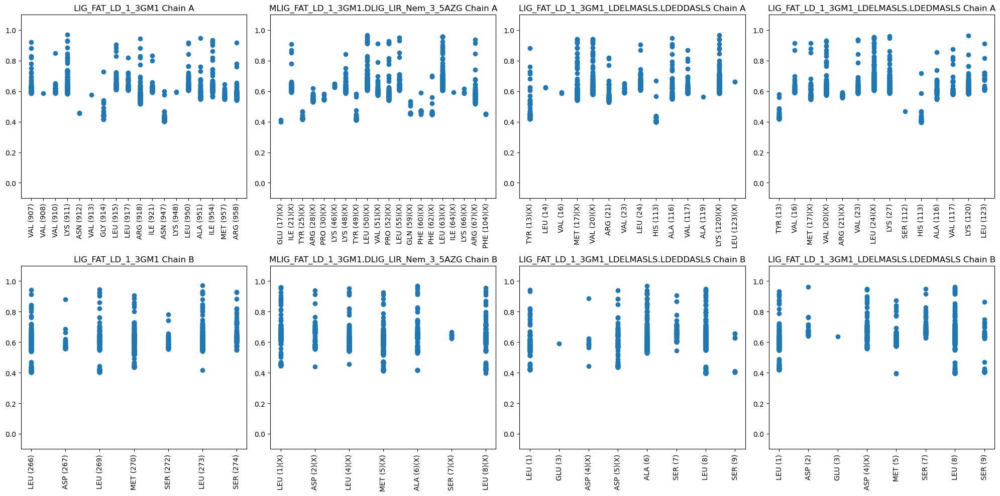

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
76,LIG_LRP6_Inhibitor_1_3SOQ,3SOQ,LIG_LRP6_Inhibitor_1,None,None,None,None,<Interface of 1360 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
199,MLIG_LRP6_Inhibitor_1_3SOQ.DTRG_NES_CRM1_1_3GB8,3SOQ,MLIG_LRP6_Inhibitor_1,3GB8,DTRG_NES_CRM1_1,None,None,<Interface of 1143 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
417,LIG_LRP6_Inhibitor_1_3SOQ_LNSNAIK.LNSNADG,3SOQ,LIG_LRP6_Inhibitor_1,None,None,LNSNAIK,LNSNADG,<Interface of 817 pairs>
418,LIG_LRP6_Inhibitor_1_3SOQ_LNSNAIK.LNSNAIG,3SOQ,LIG_LRP6_Inhibitor_1,None,None,LNSNAIK,LNSNAIG,<Interface of 883 pairs>


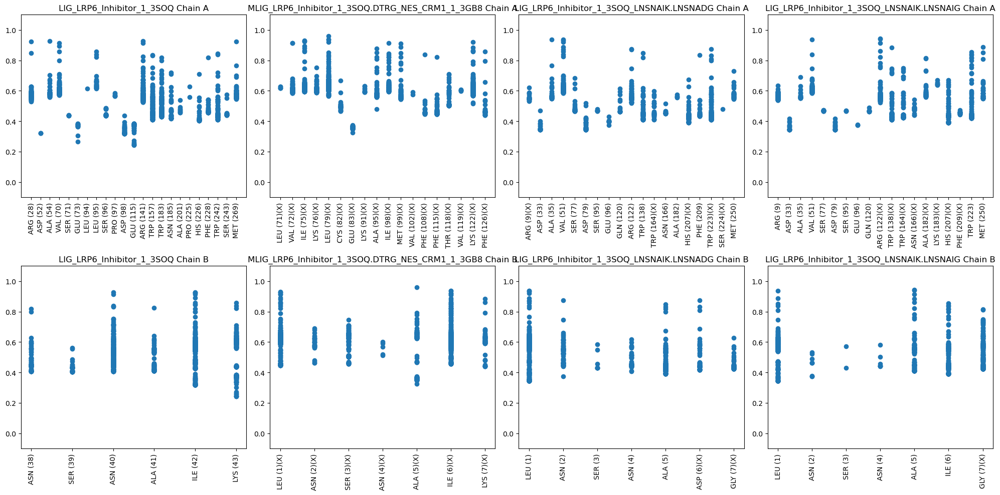

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
91,LIG_PCNA_PIPBox_1_1AXC,1AXC,LIG_PCNA_PIPBox_1,None,None,None,None,<Interface of 2158 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
214,MLIG_PCNA_PIPBox_1_1AXC.DLIG_PTB_Apo_2_1NTV,1AXC,MLIG_PCNA_PIPBox_1,1NTV,DLIG_PTB_Apo_2,None,None,<Interface of 1525 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
447,LIG_PCNA_PIPBox_1_1AXC_QTSMTDFYHS.QTSMTDDYHS,1AXC,LIG_PCNA_PIPBox_1,None,None,QTSMTDFYHS,QTSMTDDYHS,<Interface of 1733 pairs>
448,LIG_PCNA_PIPBox_1_1AXC_QTSMTDFYHS.WTSMTDDYHS,1AXC,LIG_PCNA_PIPBox_1,None,None,QTSMTDFYHS,WTSMTDDYHS,<Interface of 1412 pairs>


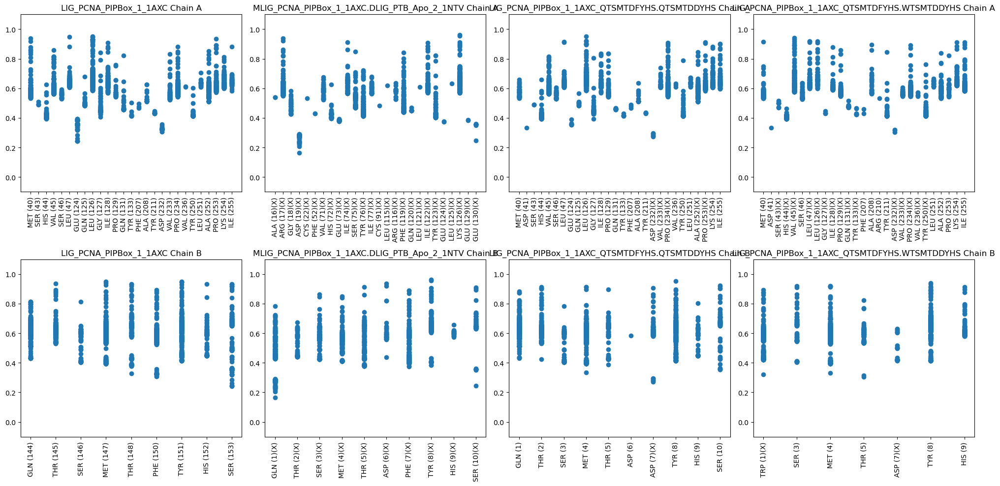

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
111,LIG_SPRY_1_2JK9,2JK9,LIG_SPRY_1,None,None,None,None,<Interface of 1168 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
233,MLIG_SPRY_1_2JK9.DLIG_BIR_III_3_1JD5,2JK9,MLIG_SPRY_1,1JD5,DLIG_BIR_III_3,None,None,<Interface of 1095 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
485,LIG_SPRY_1_2JK9_ELNNNL.ELWNNL,2JK9,LIG_SPRY_1,None,None,ELNNNL,ELWNNL,<Interface of 934 pairs>
486,LIG_SPRY_1_2JK9_ELNNNL.ELWNWL,2JK9,LIG_SPRY_1,None,None,ELNNNL,ELWNWL,<Interface of 873 pairs>


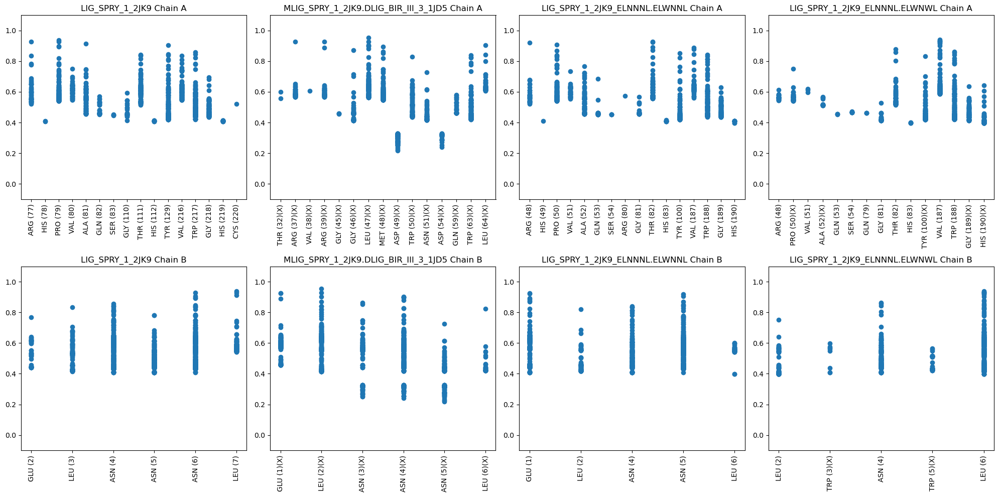

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
99,LIG_Pex14_3_4BXU,4BXU,LIG_Pex14_3,None,None,None,None,<Interface of 1187 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
222,MLIG_Pex14_3_4BXU.DLIG_Clathr_ClatBox_1_1C9I,4BXU,MLIG_Pex14_3,1C9I,DLIG_Clathr_ClatBox_1,None,None,<Interface of 1220 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
463,LIG_Pex14_3_4BXU_LVAEFL.LDAEFD,4BXU,LIG_Pex14_3,None,None,LVAEFL,LDAEFD,<Interface of 816 pairs>
464,LIG_Pex14_3_4BXU_LVAEFL.LVAEFD,4BXU,LIG_Pex14_3,None,None,LVAEFL,LVAEFD,<Interface of 428 pairs>


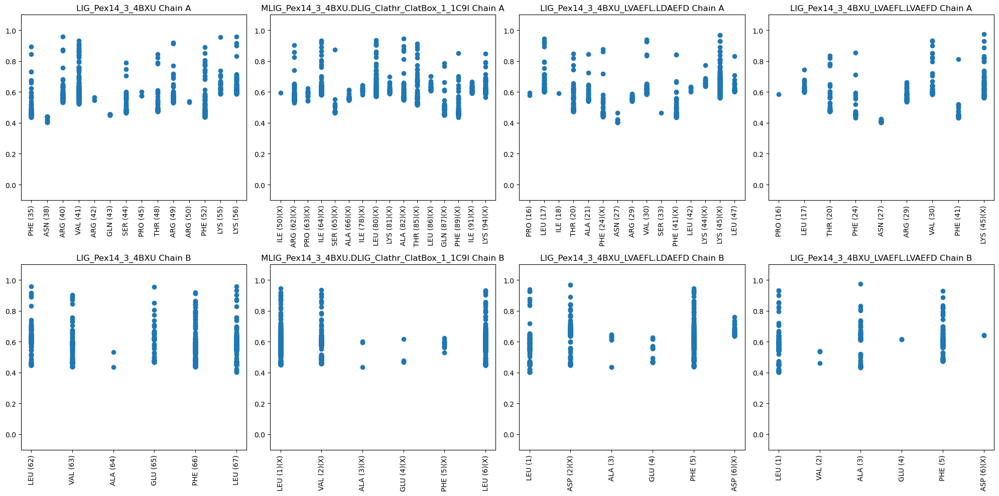

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
59,LIG_EH_1_1FF1,1FF1,LIG_EH_1,None,None,None,None,<Interface of 1325 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
181,MLIG_EH_1_1FF1.DDOC_MAPK_GRA24_9_5ETA,1FF1,MLIG_EH_1,5ETA,DDOC_MAPK_GRA24_9,None,None,<Interface of 460 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
385,LIG_EH_1_1FF1_TNPFL.TNPDL,1FF1,LIG_EH_1,None,None,TNPFL,TNPDL,<Interface of 478 pairs>
386,LIG_EH_1_1FF1_TNPFL.TWPDL,1FF1,LIG_EH_1,None,None,TNPFL,TWPDL,<Interface of 722 pairs>


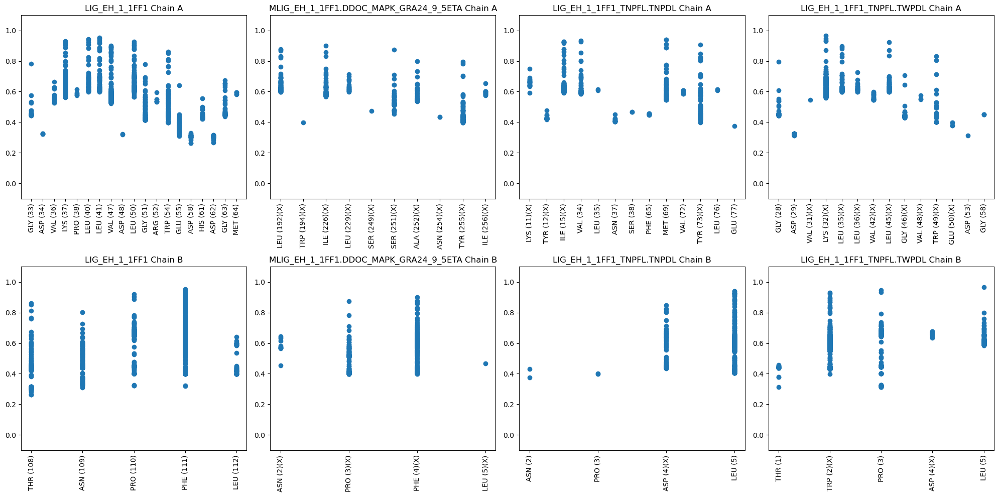

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
119,LIG_UFM1_UFIM_1_5HKH,5HKH,LIG_UFM1_UFIM_1,None,None,None,None,<Interface of 1390 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
241,MLIG_UFM1_UFIM_1_5HKH.DLIG_KLC1_Yacidic_2_6FUZ,5HKH,MLIG_UFM1_UFIM_1,6FUZ,DLIG_KLC1_Yacidic_2,None,None,<Interface of 1932 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
501,LIG_UFM1_UFIM_1_5HKH_NEWGIELV.NEWGIEDD,5HKH,LIG_UFM1_UFIM_1,None,None,NEWGIELV,NEWGIEDD,<Interface of 1121 pairs>
502,LIG_UFM1_UFIM_1_5HKH_NEWGIELV.NEWGIEDV,5HKH,LIG_UFM1_UFIM_1,None,None,NEWGIELV,NEWGIEDV,<Interface of 1127 pairs>


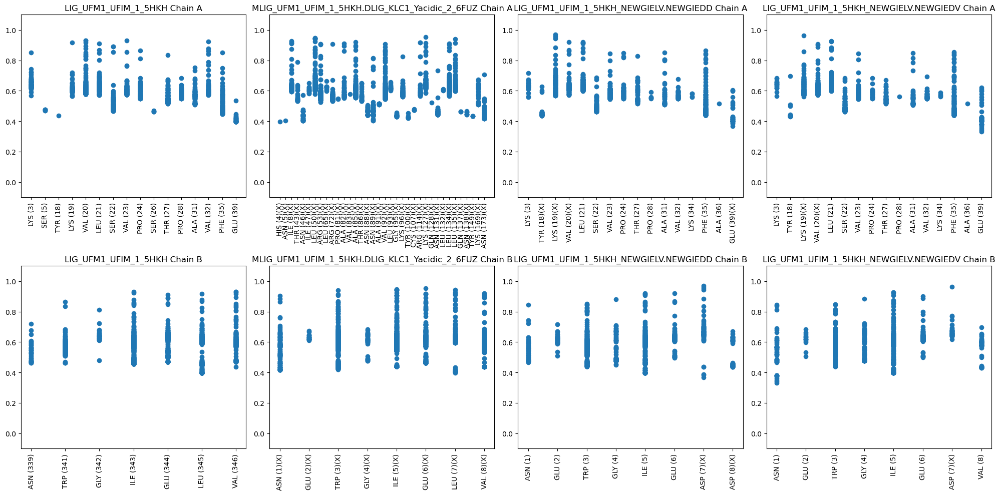

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
60,LIG_EVH1_1_1EVH,1EVH,LIG_EVH1_1,None,None,None,None,<Interface of 1141 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
183,MLIG_EVH1_1_1EVH.DLIG_Actin_WH2_1_2A41,1EVH,MLIG_EVH1_1,2A41,DLIG_Actin_WH2_1,None,None,<Interface of 926 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
387,LIG_EVH1_1_1EVH_FPPPP.DWPPP,1EVH,LIG_EVH1_1,None,None,FPPPP,DWPPP,<Interface of 888 pairs>
388,LIG_EVH1_1_1EVH_FPPPP.FWPPP,1EVH,LIG_EVH1_1,None,None,FPPPP,FWPPP,<Interface of 1046 pairs>


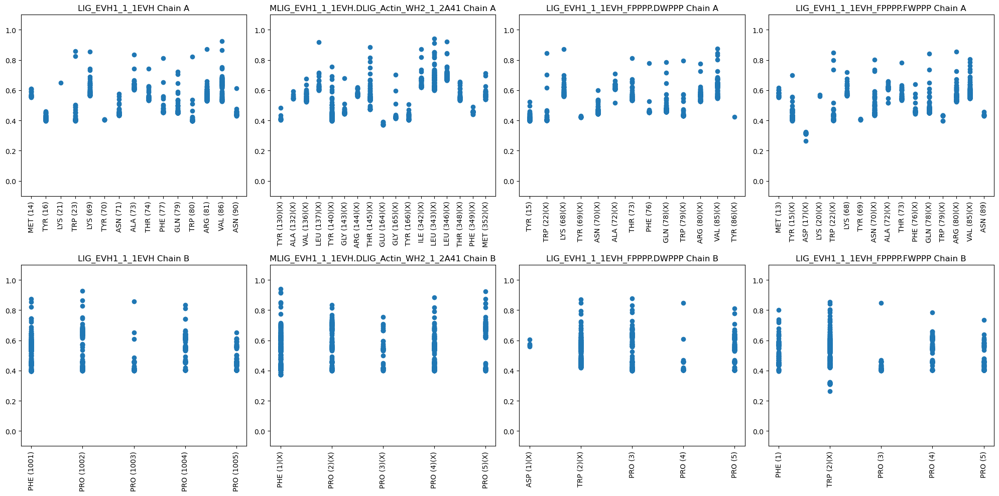

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
4,DEG_MDM2_SWIB_1_1YCR,1YCR,DEG_MDM2_SWIB_1,None,None,None,None,<Interface of 1422 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
128,MDEG_MDM2_SWIB_1_1YCR.DLIG_PCNA_APIM_2_5MLW,1YCR,MDEG_MDM2_SWIB_1,5MLW,DLIG_PCNA_APIM_2,None,None,<Interface of 1788 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
277,DEG_MDM2_SWIB_1_1YCR_FSDLWKLL.FSDLGKLD,1YCR,DEG_MDM2_SWIB_1,None,None,FSDLWKLL,FSDLGKLD,<Interface of 1208 pairs>
278,DEG_MDM2_SWIB_1_1YCR_FSDLWKLL.FSDLWKLD,1YCR,DEG_MDM2_SWIB_1,None,None,FSDLWKLL,FSDLWKLD,<Interface of 1423 pairs>


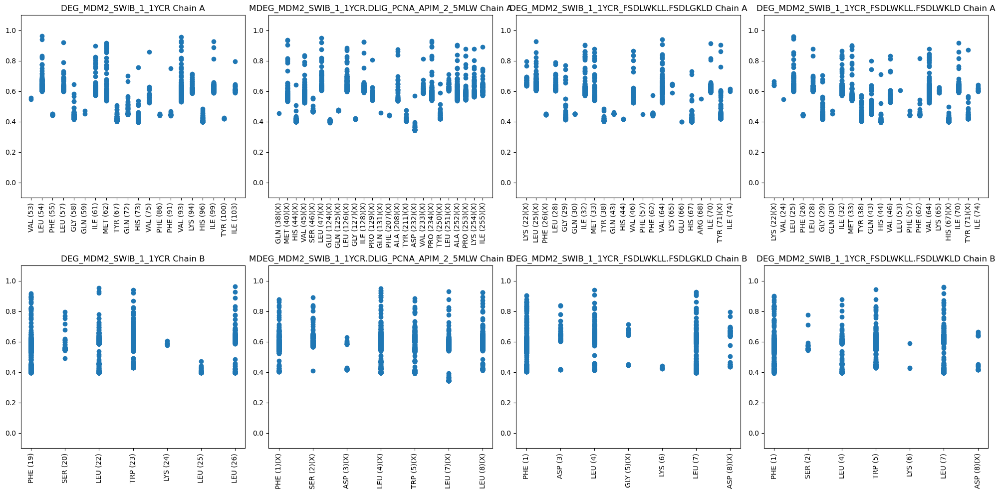

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
18,DOC_MAPK_JIP1_4_4H3B,4H3B,DOC_MAPK_JIP1_4,None,None,None,None,<Interface of 1632 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
142,MDOC_MAPK_JIP1_4_4H3B.DLIG_PAM2_1_1JGN,4H3B,MDOC_MAPK_JIP1_4,1JGN,DLIG_PAM2_1,None,None,<Interface of 687 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
305,DOC_MAPK_JIP1_4_4H3B_RPGSLDL.RWGSDDL,4H3B,DOC_MAPK_JIP1_4,None,None,RPGSLDL,RWGSDDL,<Interface of 1105 pairs>
306,DOC_MAPK_JIP1_4_4H3B_RPGSLDL.RWGSLDL,4H3B,DOC_MAPK_JIP1_4,None,None,RPGSLDL,RWGSLDL,<Interface of 1126 pairs>


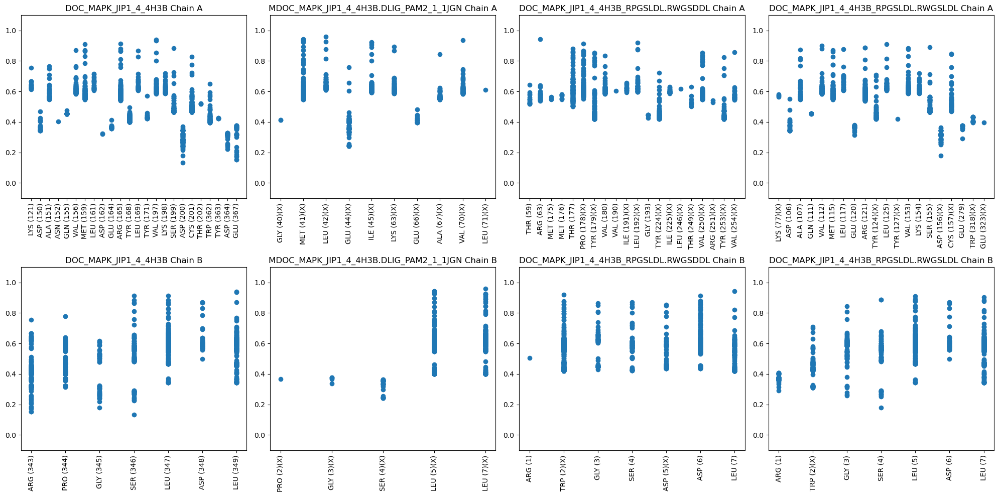

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
7,DEG_SCF_TIR1_1_2P1Q,2P1Q,DEG_SCF_TIR1_1,None,None,None,None,<Interface of 1778 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
131,MDEG_SCF_TIR1_1_2P1Q.DLIG_ULM_U2AF65_1_1O0P,2P1Q,MDEG_SCF_TIR1_1,1O0P,DLIG_ULM_U2AF65_1,None,None,<Interface of 1429 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
283,DEG_SCF_TIR1_1_2P1Q_QVVGWPPVRNYRK.QVDGWPPDRNYRK,2P1Q,DEG_SCF_TIR1_1,None,None,QVVGWPPVRNYRK,QVDGWPPDRNYRK,<Interface of 3021 pairs>
284,DEG_SCF_TIR1_1_2P1Q_QVVGWPPVRNYRK.QVDGWPPVRNYRK,2P1Q,DEG_SCF_TIR1_1,None,None,QVVGWPPVRNYRK,QVDGWPPVRNYRK,<Interface of 2426 pairs>


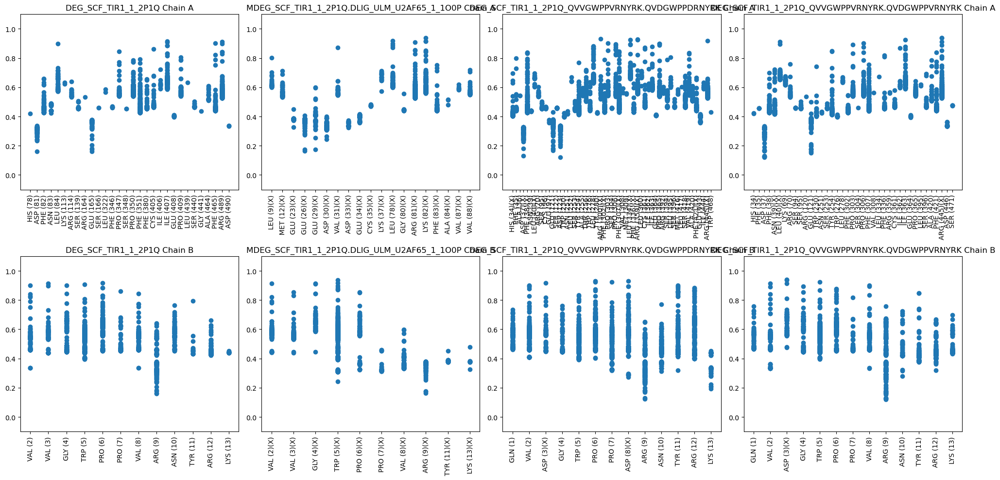

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
97,LIG_PDZ_Wminus1_1_1ZUB,1ZUB,LIG_PDZ_Wminus1_1,None,None,None,None,<Interface of 1785 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
220,MLIG_PDZ_Wminus1_1_1ZUB.DDEG_Kelch_Keap1_2_3WN7,1ZUB,MLIG_PDZ_Wminus1_1,3WN7,DDEG_Kelch_Keap1_2,None,None,<Interface of 963 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
459,LIG_PDZ_Wminus1_1_1ZUB_GIWA.GIGA,1ZUB,LIG_PDZ_Wminus1_1,None,None,GIWA,GIGA,<Interface of 1004 pairs>
460,LIG_PDZ_Wminus1_1_1ZUB_GIWA.GIGW,1ZUB,LIG_PDZ_Wminus1_1,None,None,GIWA,GIGW,<Interface of 1324 pairs>


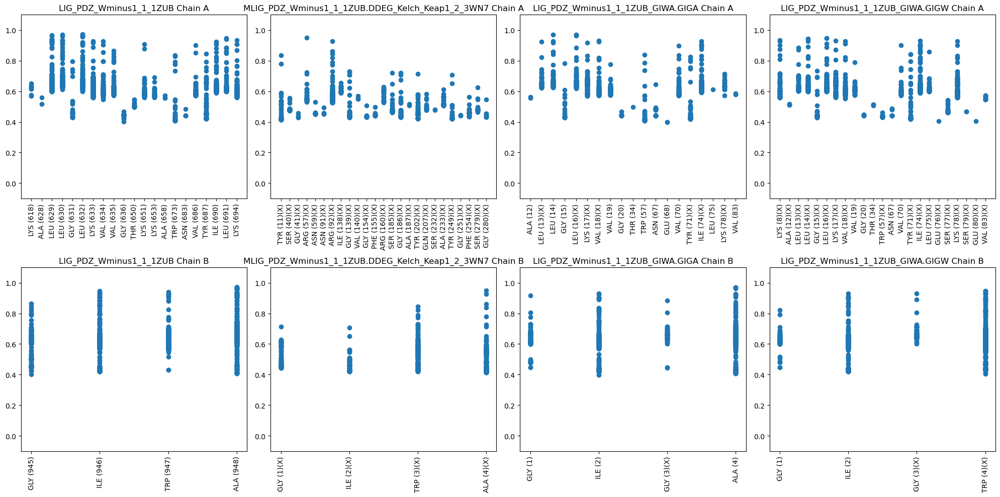

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
103,LIG_Rb_LxCxE_1_1GH6,1GH6,LIG_Rb_LxCxE_1,None,None,None,None,<Interface of 1394 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
226,MLIG_Rb_LxCxE_1_1GH6.DLIG_EVH1_1_1EVH,1GH6,MLIG_Rb_LxCxE_1,1EVH,DLIG_EVH1_1,None,None,<Interface of 1396 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
471,LIG_Rb_LxCxE_1_1GH6_ENLFCSEEMPSSDDEAT.ENLFCSEE...,1GH6,LIG_Rb_LxCxE_1,None,None,ENLFCSEEMPSSDDEAT,ENLFCSEEMPSSDDEAW,<Interface of 2213 pairs>
472,LIG_Rb_LxCxE_1_1GH6_ENLFCSEEMPSSDDEAT.ENLFCSEE...,1GH6,LIG_Rb_LxCxE_1,None,None,ENLFCSEEMPSSDDEAT,ENLFCSEEMWSSDDEAW,<Interface of 2089 pairs>


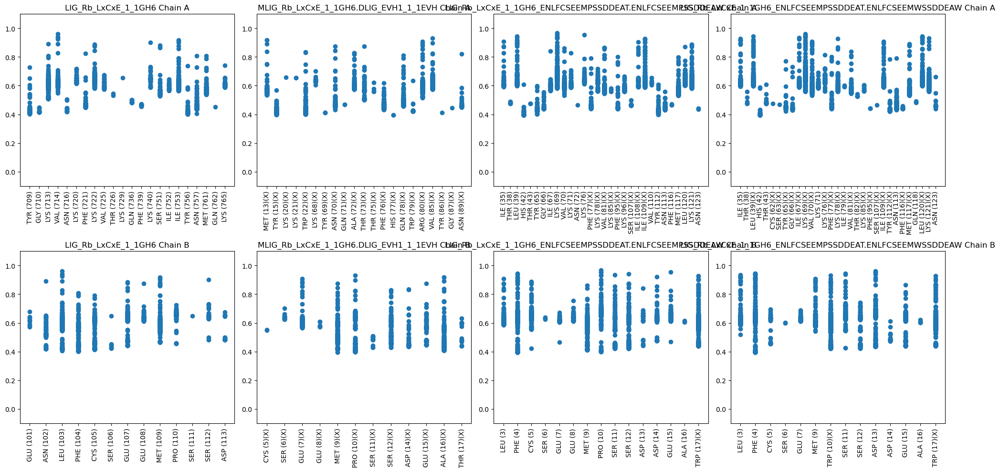

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
265,TRG_LysEnd_GGAAcLL_1_1JWG,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,None,None,<Interface of 1797 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
256,MTRG_LysEnd_GGAAcLL_1_1JWG.DLIG_SUMO_SIM_anti_...,1JWG,MTRG_LysEnd_GGAAcLL_1,2KQS,DLIG_SUMO_SIM_anti_2,None,None,<Interface of 1285 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
529,TRG_LysEnd_GGAAcLL_1_1JWG_DEDLLHI.DEDLDHI,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,DEDLLHI,DEDLDHI,<Interface of 1459 pairs>
530,TRG_LysEnd_GGAAcLL_1_1JWG_DEDLLHI.WEDLDHI,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,DEDLLHI,WEDLDHI,<Interface of 1259 pairs>


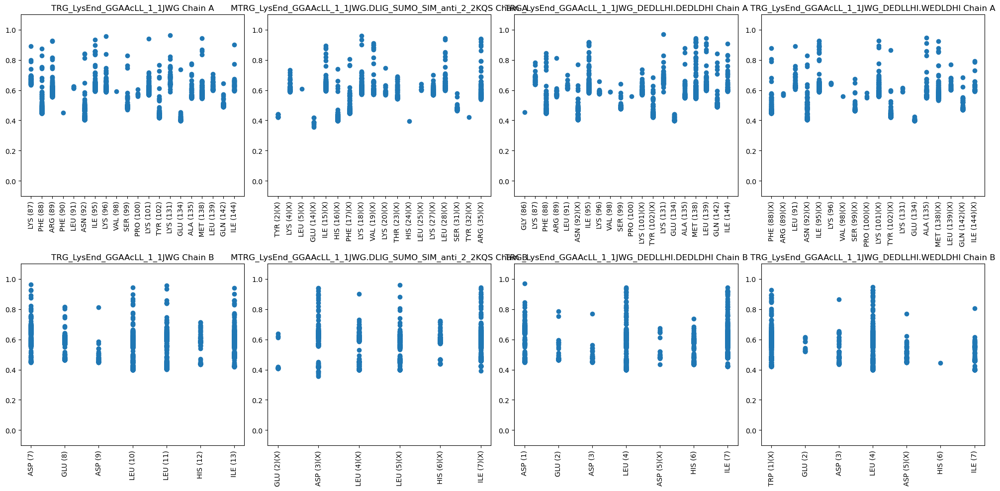

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
72,LIG_LIR_Apic_2_4EOY,4EOY,LIG_LIR_Apic_2,None,None,None,None,<Interface of 1383 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
195,MLIG_LIR_Apic_2_4EOY.DLIG_Sin3_1_1PD7,4EOY,MLIG_LIR_Apic_2,1PD7,DLIG_Sin3_1,None,None,<Interface of 663 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
409,LIG_LIR_Apic_2_4EOY_NDWLLP.NWWLLP,4EOY,LIG_LIR_Apic_2,None,None,NDWLLP,NWWLLP,<Interface of 1741 pairs>
410,LIG_LIR_Apic_2_4EOY_NDWLLP.NWWLLW,4EOY,LIG_LIR_Apic_2,None,None,NDWLLP,NWWLLW,<Interface of 1663 pairs>


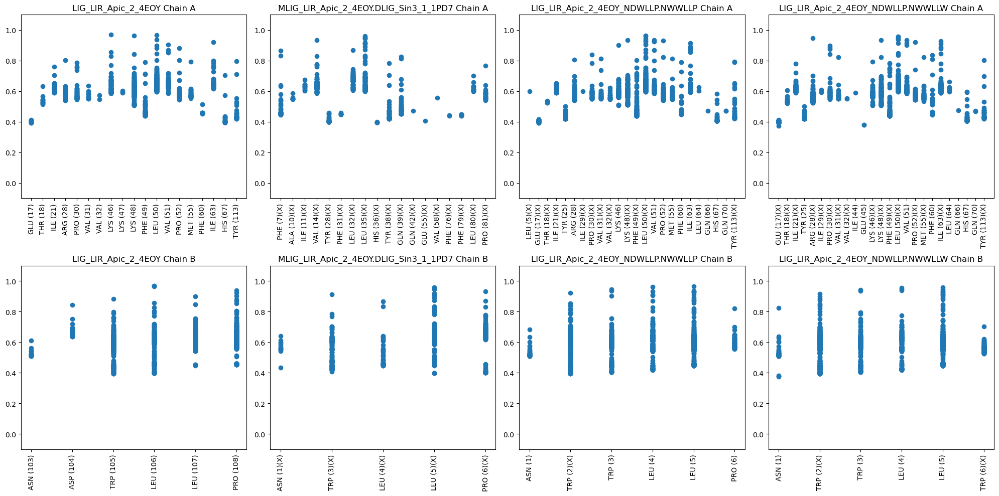

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
87,LIG_PALB2_WD40_1_3EU7,3EU7,LIG_PALB2_WD40_1,None,None,None,None,<Interface of 1450 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
210,MLIG_PALB2_WD40_1_3EU7.DLIG_Actin_RPEL_3_2V52,3EU7,MLIG_PALB2_WD40_1,2V52,DLIG_Actin_RPEL_3,None,None,<Interface of 1141 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
439,LIG_PALB2_WD40_1_3EU7_ISLNWFEEL.ISLNWDEED,3EU7,LIG_PALB2_WD40_1,None,None,ISLNWFEEL,ISLNWDEED,<Interface of 1524 pairs>
440,LIG_PALB2_WD40_1_3EU7_ISLNWFEEL.ISLNWDEEL,3EU7,LIG_PALB2_WD40_1,None,None,ISLNWFEEL,ISLNWDEEL,<Interface of 1392 pairs>


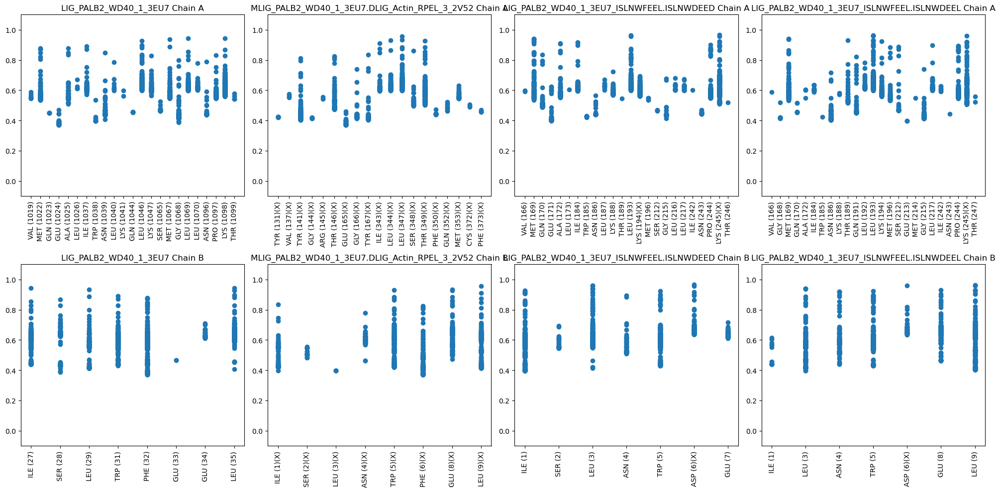

2


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
55,LIG_DLG_GKlike_1_3WP0,3WP0,LIG_DLG_GKlike_1,None,None,None,None,<Interface of 1007 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
178,MLIG_DLG_GKlike_1_3WP0.DTRG_ER_FFAT_1_2RR3,3WP0,MLIG_DLG_GKlike_1,2RR3,DTRG_ER_FFAT_1,None,None,<Interface of 1298 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


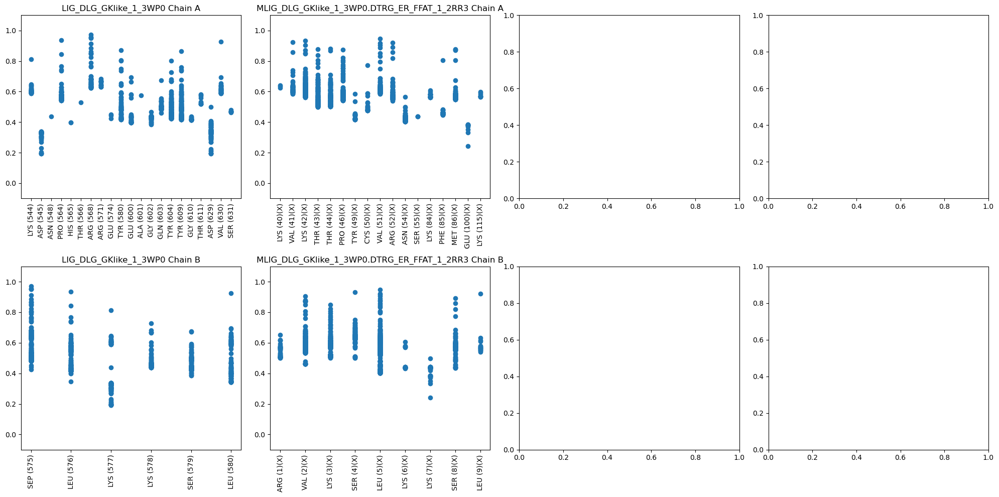

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
42,LIG_BH_BH3_1_2ROC,2ROC,LIG_BH_BH3_1,None,None,None,None,<Interface of 2468 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
165,MLIG_BH_BH3_1_2ROC.DLIG_Actin_WH2_2_2D1K,2ROC,MLIG_BH_BH3_1,2D1K,DLIG_Actin_WH2_2,None,None,<Interface of 1403 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
353,LIG_BH_BH3_1_2ROC_WAREIGAQLRRIADDLN.WAREIGAQLR...,2ROC,LIG_BH_BH3_1,None,None,WAREIGAQLRRIADDLN,WAREIGAQLRRDADDLN,<Interface of 2602 pairs>
354,LIG_BH_BH3_1_2ROC_WAREIGAQLRRIADDLN.WAREIGAQLR...,2ROC,LIG_BH_BH3_1,None,None,WAREIGAQLRRIADDLN,WAREIGAQLRRDWDDLN,<Interface of 2705 pairs>


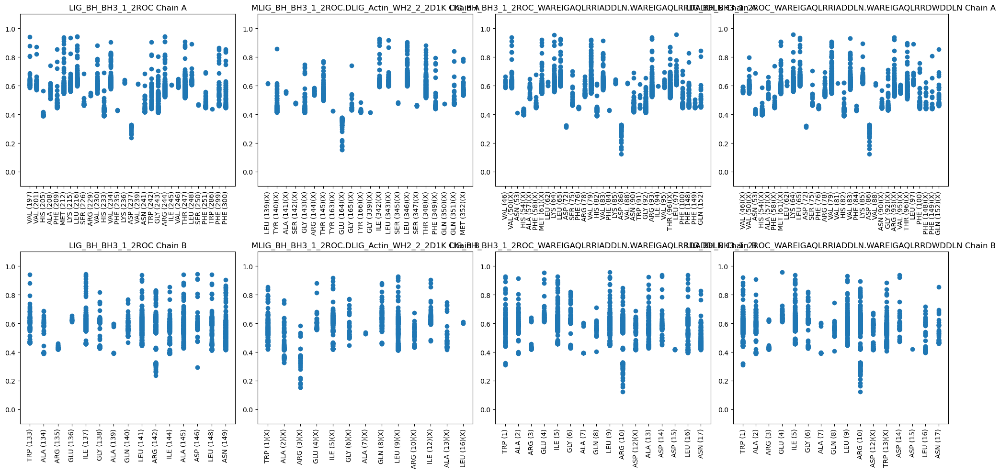

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
109,LIG_SH3_CIN85_PxpxPR_1_2BZ8,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,None,None,<Interface of 999 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
232,MLIG_SH3_CIN85_PxpxPR_1_2BZ8.DLIG_PAM2_1_1JGN,2BZ8,MLIG_SH3_CIN85_PxpxPR_1,1JGN,DLIG_PAM2_1,None,None,<Interface of 265 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
483,LIG_SH3_CIN85_PxpxPR_1_2BZ8_PKPRPR.PKPRPG,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,PKPRPR,PKPRPG,<Interface of 1007 pairs>
484,LIG_SH3_CIN85_PxpxPR_1_2BZ8_PKPRPR.PKPRWG,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,PKPRPR,PKPRWG,<Interface of 849 pairs>


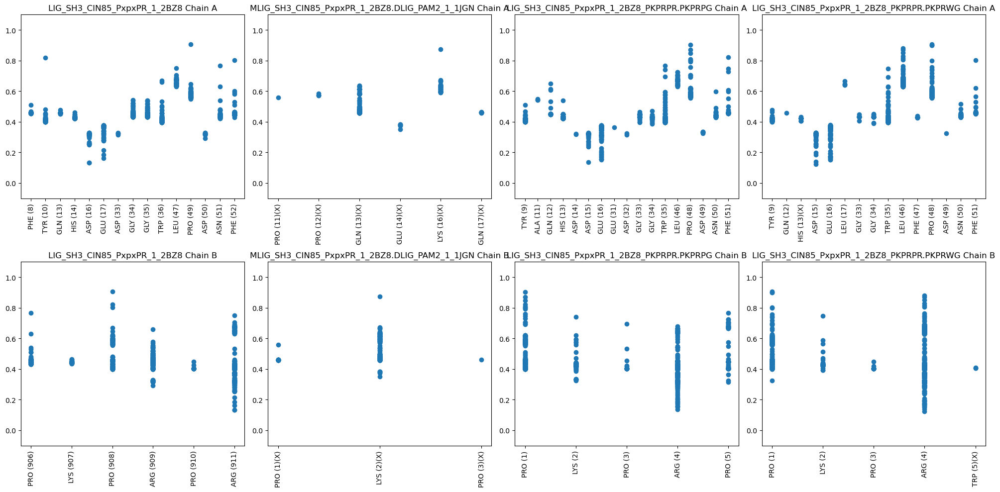

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
113,LIG_SUMO_SIM_anti_2_2KQS,2KQS,LIG_SUMO_SIM_anti_2,None,None,None,None,<Interface of 1850 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
235,MLIG_SUMO_SIM_anti_2_2KQS.DLIG_APCC_ABBA_1_4BH6,2KQS,MLIG_SUMO_SIM_anti_2,4BH6,DLIG_APCC_ABBA_1,None,None,<Interface of 965 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
489,LIG_SUMO_SIM_anti_2_2KQS_EIIVLSDSD.EIDVLSDWD,2KQS,LIG_SUMO_SIM_anti_2,None,None,EIIVLSDSD,EIDVLSDWD,<Interface of 1422 pairs>
490,LIG_SUMO_SIM_anti_2_2KQS_EIIVLSDSD.EIIVLSDWD,2KQS,LIG_SUMO_SIM_anti_2,None,None,EIIVLSDSD,EIIVLSDWD,<Interface of 1766 pairs>


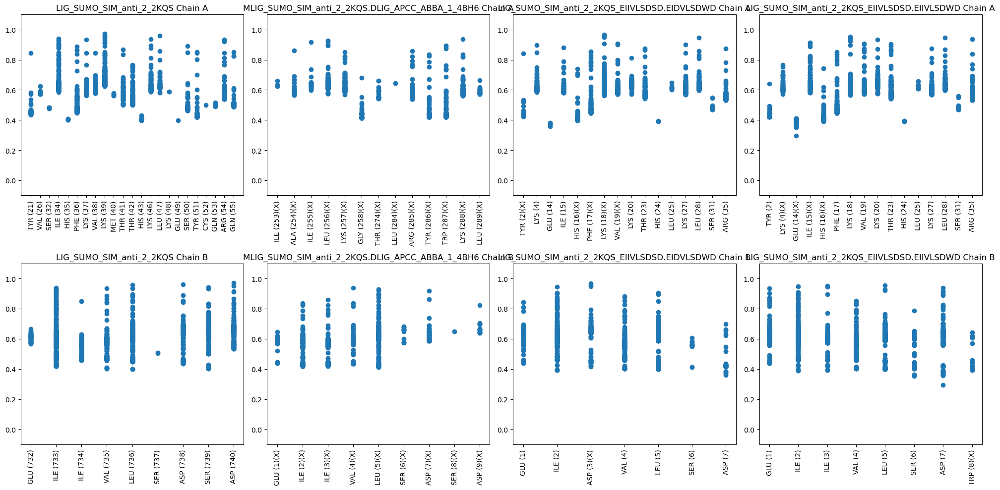

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
157,MLIG_Actin_RPEL_3_2V52.DLIG_ActinCP_TwfCPI_2_7DS2,2V52,MLIG_Actin_RPEL_3,7DS2,DLIG_ActinCP_TwfCPI_2,None,None,<Interface of 3866 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
337,LIG_Actin_RPEL_3_2V52_LKRKIRSRPERAELVRMHIL.LKR...,2V52,LIG_Actin_RPEL_3,None,None,LKRKIRSRPERAELVRMHIL,LKRKIRSGPERAELVRMHDL,<Interface of 1772 pairs>
338,LIG_Actin_RPEL_3_2V52_LKRKIRSRPERAELVRMHIL.LKR...,2V52,LIG_Actin_RPEL_3,None,None,LKRKIRSRPERAELVRMHIL,LKRKIRSGPERAELVRMHIL,<Interface of 1553 pairs>


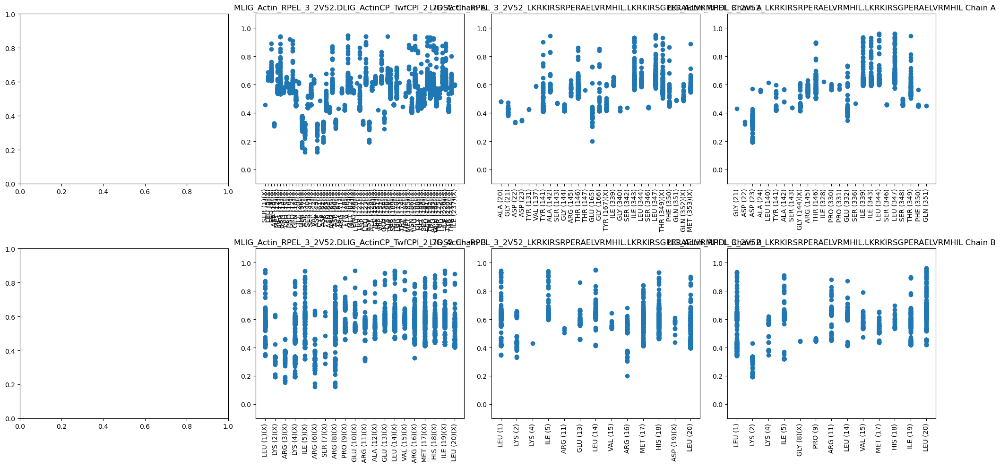

In [77]:
for pdb_id in pdb_ids_test:
    visualize_interface(pdb_id)

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
33,LIG_ActinCP_TwfCPI_2_7DS2,7DS2,LIG_ActinCP_TwfCPI_2,None,None,None,None,<Interface of 1972 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
335,LIG_ActinCP_TwfCPI_2_7DS2_FAKPKGPAGKR.DAKPKGPAGKR,7DS2,LIG_ActinCP_TwfCPI_2,None,None,FAKPKGPAGKR,DAKPKGPAGKR,<Interface of 1907 pairs>
336,LIG_ActinCP_TwfCPI_2_7DS2_FAKPKGPAGKR.DAKPKGWAGKR,7DS2,LIG_ActinCP_TwfCPI_2,None,None,FAKPKGPAGKR,DAKPKGWAGKR,<Interface of 2131 pairs>


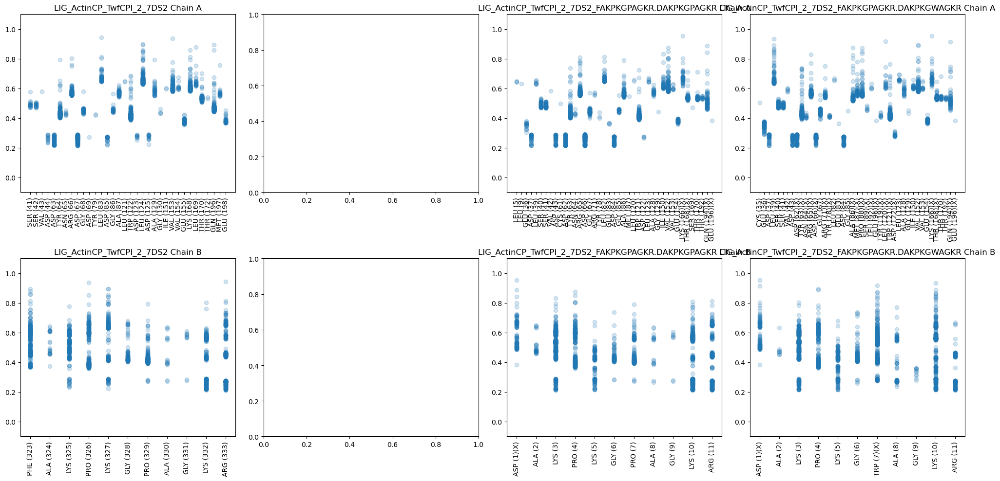

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
263,TRG_ENDOCYTIC_2_1BXX,1BXX,TRG_ENDOCYTIC_2,None,None,None,None,<Interface of 1436 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
254,MTRG_ENDOCYTIC_2_1BXX.DTRG_ER_FFAT_1_2RR3,1BXX,MTRG_ENDOCYTIC_2,2RR3,DTRG_ER_FFAT_1,None,None,<Interface of 1276 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
525,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRD,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRD,<Interface of 393 pairs>
526,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRL,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRL,<Interface of 845 pairs>


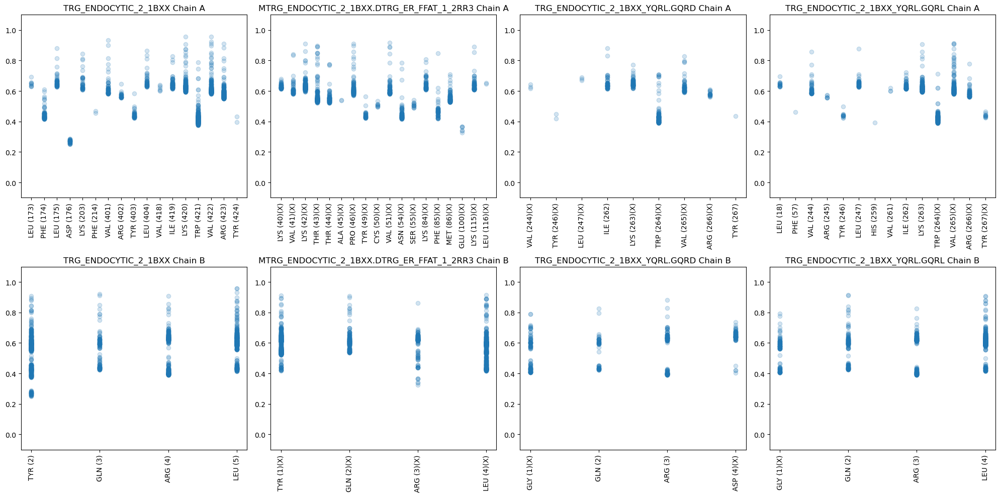

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
244,MLIG_WD40_WDR5_VDV_1_4CY2.DLIG_BIR_III_3_1JD5,4CY2,MLIG_WD40_WDR5_VDV_1,1JD5,DLIG_BIR_III_3,None,None,<Interface of 598 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
507,LIG_WD40_WDR5_VDV_1_4CY2_DLDV.DDDD,4CY2,LIG_WD40_WDR5_VDV_1,None,None,DLDV,DDDD,<Interface of 277 pairs>
508,LIG_WD40_WDR5_VDV_1_4CY2_DLDV.DLDD,4CY2,LIG_WD40_WDR5_VDV_1,None,None,DLDV,DLDD,<Interface of 628 pairs>


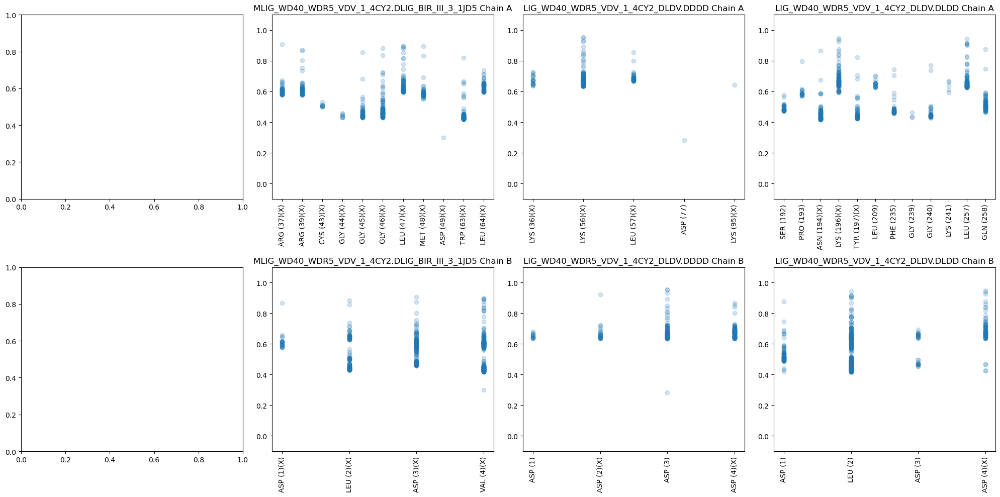

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
104,LIG_Rb_pABgroove_1_1N4M,1N4M,LIG_Rb_pABgroove_1,None,None,None,None,<Interface of 1437 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
227,MLIG_Rb_pABgroove_1_1N4M.DLIG_WD40_WDR5_WIN_1_...,1N4M,MLIG_Rb_pABgroove_1,3UVK,DLIG_WD40_WDR5_WIN_1,None,None,<Interface of 1613 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
473,LIG_Rb_pABgroove_1_1N4M_EGISDLFD.EGDSDLFD,1N4M,LIG_Rb_pABgroove_1,None,None,EGISDLFD,EGDSDLFD,<Interface of 1294 pairs>
474,LIG_Rb_pABgroove_1_1N4M_EGISDLFD.EGDSDLFW,1N4M,LIG_Rb_pABgroove_1,None,None,EGISDLFD,EGDSDLFW,<Interface of 1016 pairs>


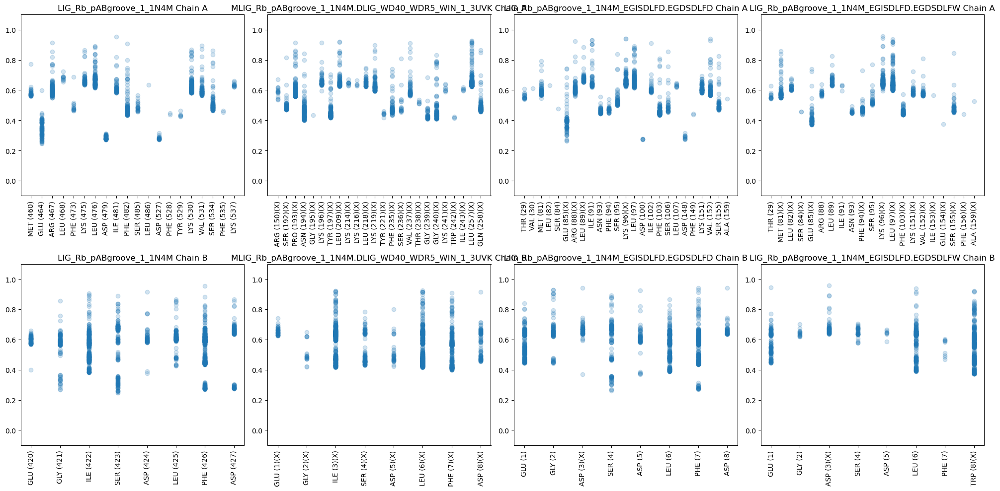

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
122,LIG_WD40_WDR5_WIN_2_4CY3,4CY3,LIG_WD40_WDR5_WIN_2,None,None,None,None,<Interface of 1759 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
511,LIG_WD40_WDR5_WIN_2_4CY3_CSRARPL.CSRAGWL,4CY3,LIG_WD40_WDR5_WIN_2,None,None,CSRARPL,CSRAGWL,<Interface of 1439 pairs>
512,LIG_WD40_WDR5_WIN_2_4CY3_CSRARPL.CSRARWL,4CY3,LIG_WD40_WDR5_WIN_2,None,None,CSRARPL,CSRARWL,<Interface of 1537 pairs>


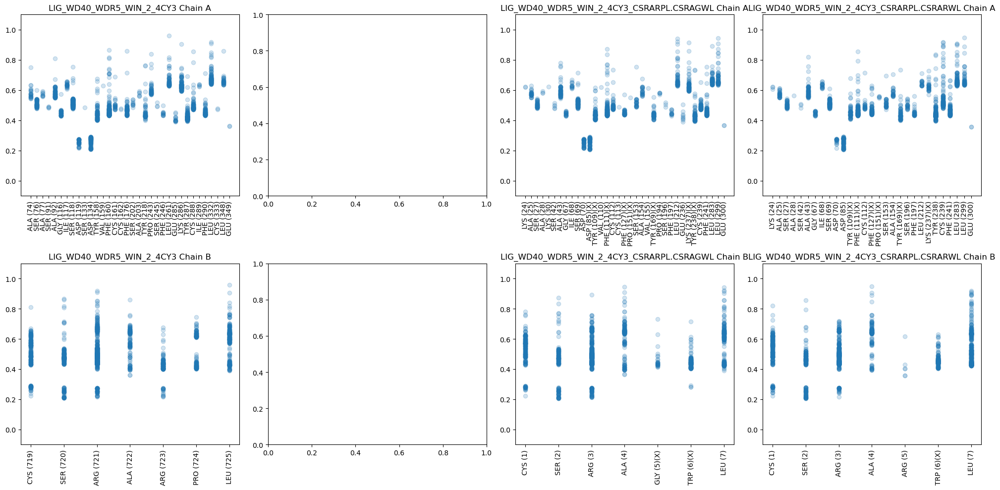

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
0,DEG_APCC_KENBOX_2_4GGD,4GGD,DEG_APCC_KENBOX_2,None,None,None,None,<Interface of 920 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
124,MDEG_APCC_KENBOX_2_4GGD.DTRG_AP2beta_CARGO_1_2G30,4GGD,MDEG_APCC_KENBOX_2,2G30,DTRG_AP2beta_CARGO_1,None,None,<Interface of 1036 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
269,DEG_APCC_KENBOX_2_4GGD_SKENV.SGENV,4GGD,DEG_APCC_KENBOX_2,None,None,SKENV,SGENV,<Interface of 771 pairs>
270,DEG_APCC_KENBOX_2_4GGD_SKENV.SGEWV,4GGD,DEG_APCC_KENBOX_2,None,None,SKENV,SGEWV,<Interface of 663 pairs>


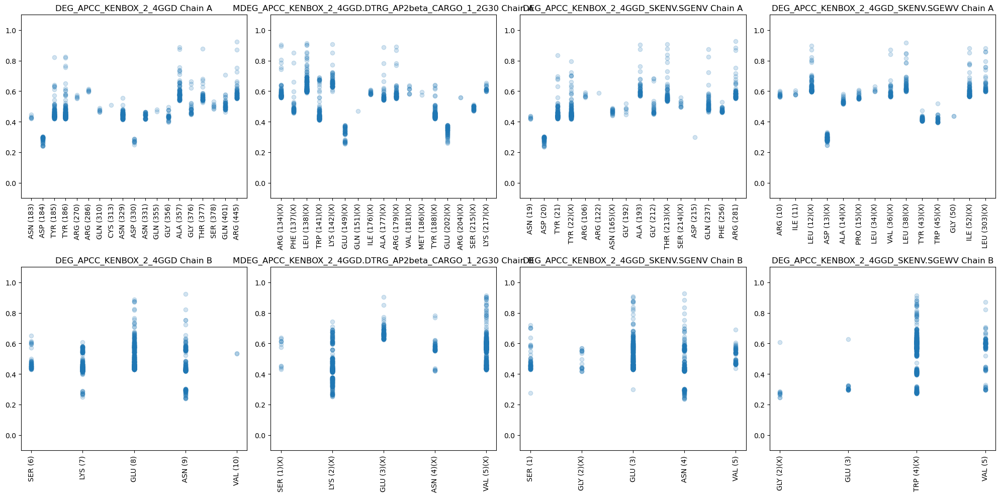

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
10,DOC_AGCK_PIF_3_1ATP,1ATP,DOC_AGCK_PIF_3,None,None,None,None,<Interface of 1160 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
134,MDOC_AGCK_PIF_3_1ATP.DDEG_Kelch_Keap1_1_2FLU,1ATP,MDOC_AGCK_PIF_3,2FLU,DDEG_Kelch_Keap1_1,None,None,<Interface of 1017 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
289,DOC_AGCK_PIF_3_1ATP_FTEF.DTED,1ATP,DOC_AGCK_PIF_3,None,None,FTEF,DTED,<Interface of 292 pairs>
290,DOC_AGCK_PIF_3_1ATP_FTEF.FTED,1ATP,DOC_AGCK_PIF_3,None,None,FTEF,FTED,<Interface of 671 pairs>


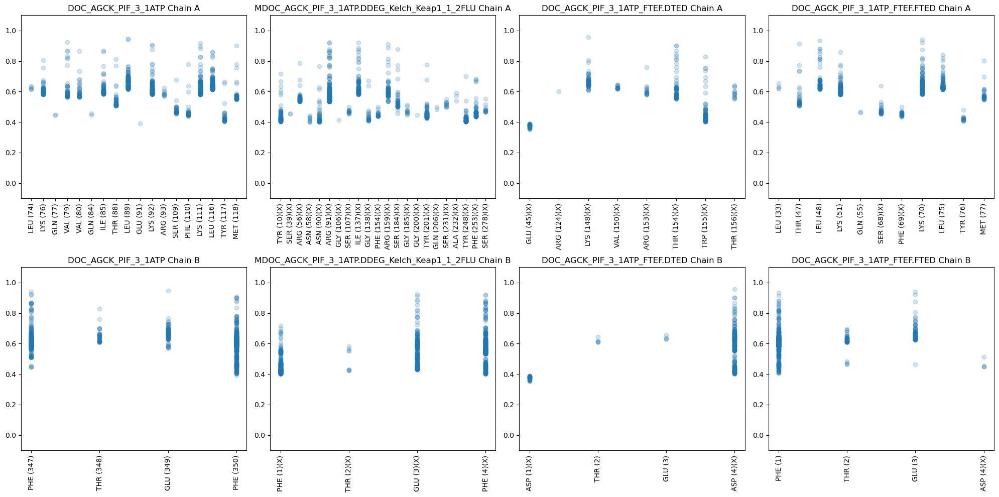

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
38,LIG_AP2alpha_1_1KY7,1KY7,LIG_AP2alpha_1,None,None,None,None,<Interface of 1140 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
161,MLIG_AP2alpha_1_1KY7.DLIG_PAM2_1_1JGN,1KY7,MLIG_AP2alpha_1,1JGN,DLIG_PAM2_1,None,None,<Interface of 488 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
345,LIG_AP2alpha_1_1KY7_FEDNF.DEDNF,1KY7,LIG_AP2alpha_1,None,None,FEDNF,DEDNF,<Interface of 566 pairs>
346,LIG_AP2alpha_1_1KY7_FEDNF.DEWNF,1KY7,LIG_AP2alpha_1,None,None,FEDNF,DEWNF,<Interface of 719 pairs>


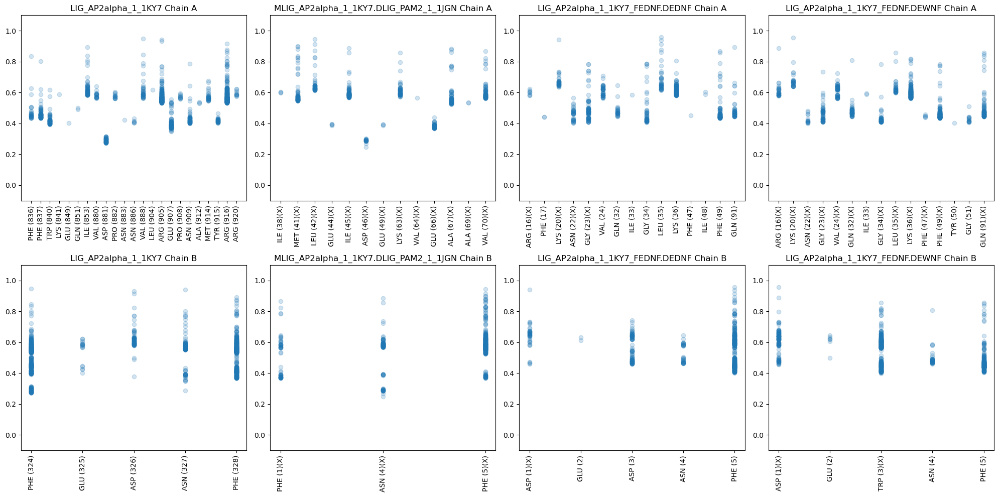

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
63,LIG_FAT_LD_1_3GM1,3GM1,LIG_FAT_LD_1,None,None,None,None,<Interface of 1264 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
186,MLIG_FAT_LD_1_3GM1.DLIG_LIR_Nem_3_5AZG,3GM1,MLIG_FAT_LD_1,5AZG,DLIG_LIR_Nem_3,None,None,<Interface of 1306 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
393,LIG_FAT_LD_1_3GM1_LDELMASLS.LDEDDASLS,3GM1,LIG_FAT_LD_1,None,None,LDELMASLS,LDEDDASLS,<Interface of 1115 pairs>
394,LIG_FAT_LD_1_3GM1_LDELMASLS.LDEDMASLS,3GM1,LIG_FAT_LD_1,None,None,LDELMASLS,LDEDMASLS,<Interface of 1250 pairs>


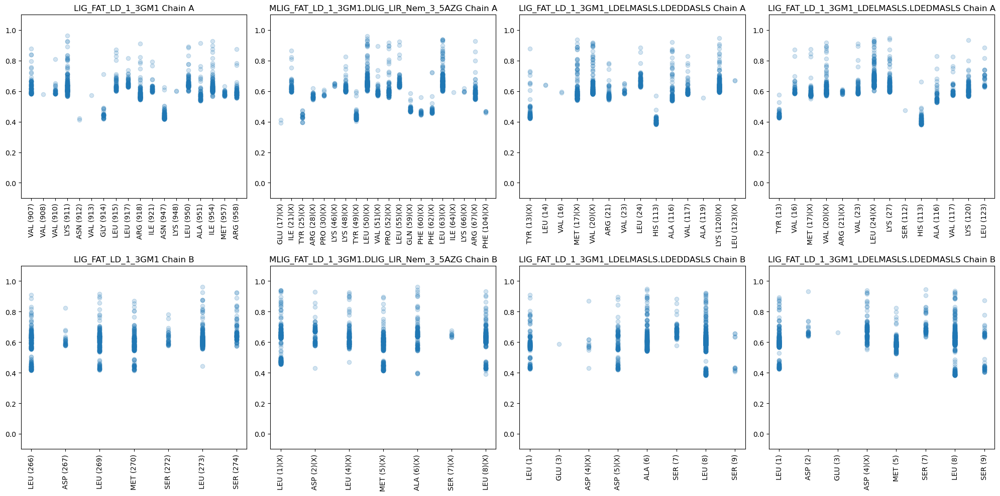

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
76,LIG_LRP6_Inhibitor_1_3SOQ,3SOQ,LIG_LRP6_Inhibitor_1,None,None,None,None,<Interface of 1360 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
199,MLIG_LRP6_Inhibitor_1_3SOQ.DTRG_NES_CRM1_1_3GB8,3SOQ,MLIG_LRP6_Inhibitor_1,3GB8,DTRG_NES_CRM1_1,None,None,<Interface of 1143 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
417,LIG_LRP6_Inhibitor_1_3SOQ_LNSNAIK.LNSNADG,3SOQ,LIG_LRP6_Inhibitor_1,None,None,LNSNAIK,LNSNADG,<Interface of 817 pairs>
418,LIG_LRP6_Inhibitor_1_3SOQ_LNSNAIK.LNSNAIG,3SOQ,LIG_LRP6_Inhibitor_1,None,None,LNSNAIK,LNSNAIG,<Interface of 883 pairs>


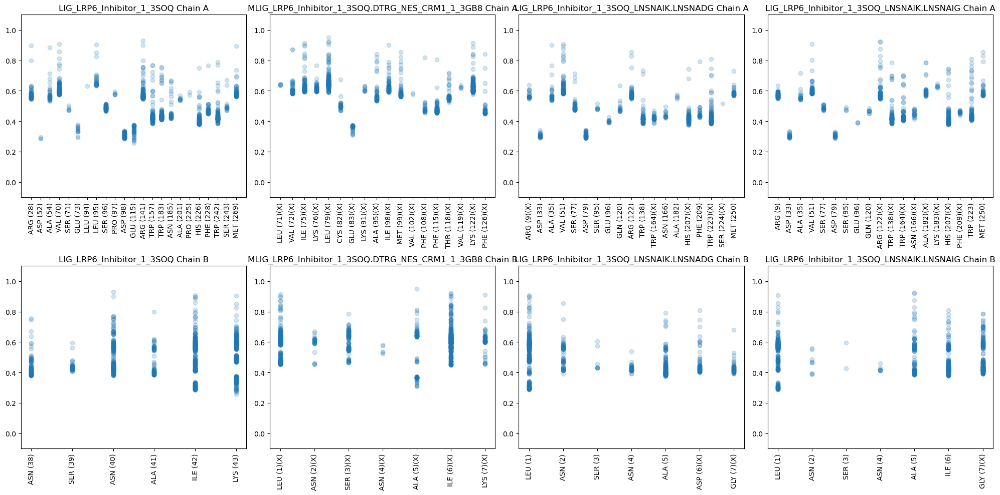

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
91,LIG_PCNA_PIPBox_1_1AXC,1AXC,LIG_PCNA_PIPBox_1,None,None,None,None,<Interface of 2158 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
214,MLIG_PCNA_PIPBox_1_1AXC.DLIG_PTB_Apo_2_1NTV,1AXC,MLIG_PCNA_PIPBox_1,1NTV,DLIG_PTB_Apo_2,None,None,<Interface of 1525 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
447,LIG_PCNA_PIPBox_1_1AXC_QTSMTDFYHS.QTSMTDDYHS,1AXC,LIG_PCNA_PIPBox_1,None,None,QTSMTDFYHS,QTSMTDDYHS,<Interface of 1733 pairs>
448,LIG_PCNA_PIPBox_1_1AXC_QTSMTDFYHS.WTSMTDDYHS,1AXC,LIG_PCNA_PIPBox_1,None,None,QTSMTDFYHS,WTSMTDDYHS,<Interface of 1412 pairs>


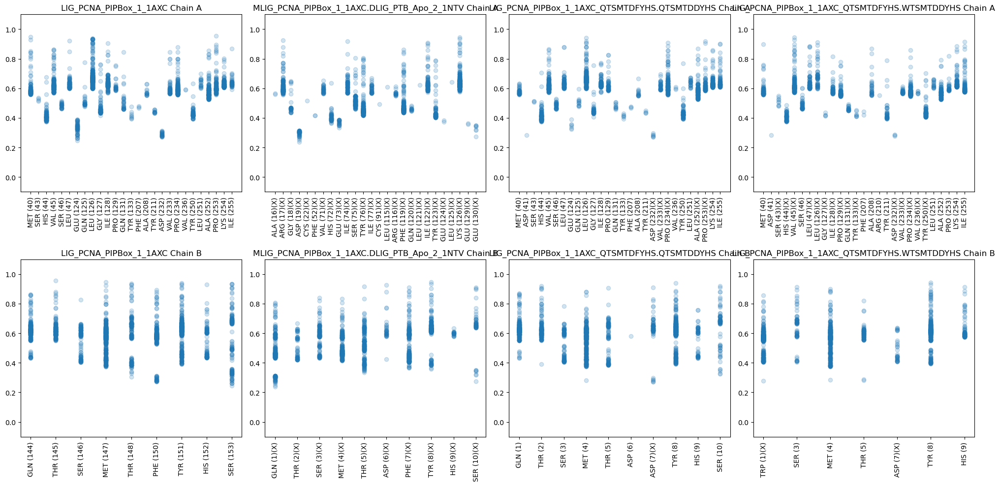

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
111,LIG_SPRY_1_2JK9,2JK9,LIG_SPRY_1,None,None,None,None,<Interface of 1168 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
233,MLIG_SPRY_1_2JK9.DLIG_BIR_III_3_1JD5,2JK9,MLIG_SPRY_1,1JD5,DLIG_BIR_III_3,None,None,<Interface of 1095 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
485,LIG_SPRY_1_2JK9_ELNNNL.ELWNNL,2JK9,LIG_SPRY_1,None,None,ELNNNL,ELWNNL,<Interface of 934 pairs>
486,LIG_SPRY_1_2JK9_ELNNNL.ELWNWL,2JK9,LIG_SPRY_1,None,None,ELNNNL,ELWNWL,<Interface of 873 pairs>


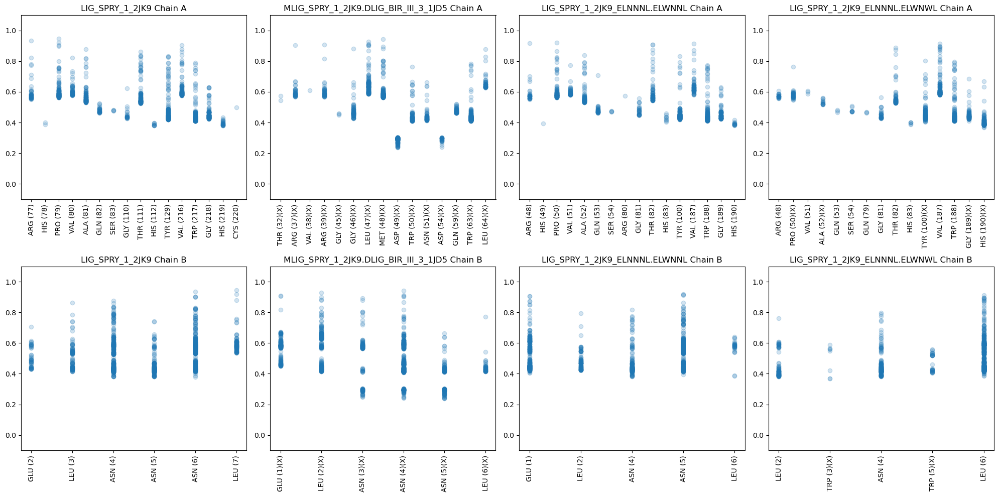

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
99,LIG_Pex14_3_4BXU,4BXU,LIG_Pex14_3,None,None,None,None,<Interface of 1187 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
222,MLIG_Pex14_3_4BXU.DLIG_Clathr_ClatBox_1_1C9I,4BXU,MLIG_Pex14_3,1C9I,DLIG_Clathr_ClatBox_1,None,None,<Interface of 1220 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
463,LIG_Pex14_3_4BXU_LVAEFL.LDAEFD,4BXU,LIG_Pex14_3,None,None,LVAEFL,LDAEFD,<Interface of 816 pairs>
464,LIG_Pex14_3_4BXU_LVAEFL.LVAEFD,4BXU,LIG_Pex14_3,None,None,LVAEFL,LVAEFD,<Interface of 428 pairs>


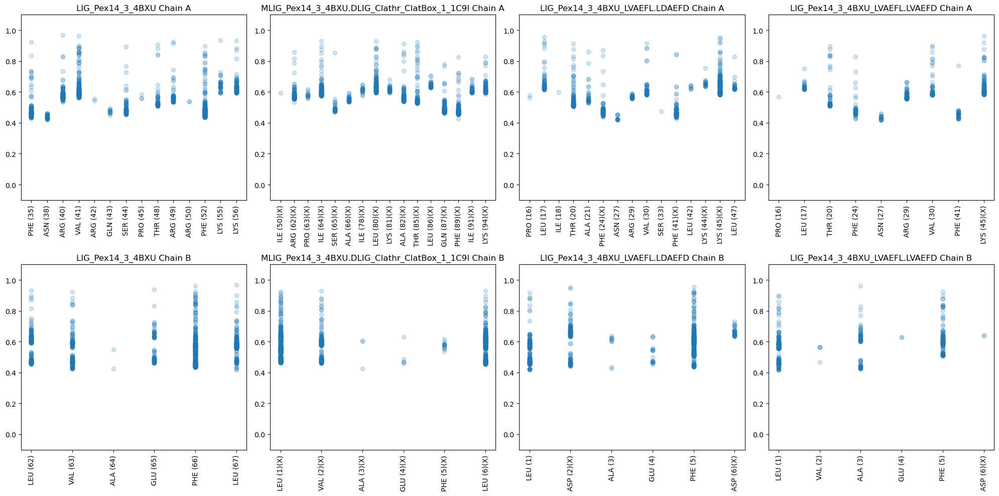

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
59,LIG_EH_1_1FF1,1FF1,LIG_EH_1,None,None,None,None,<Interface of 1325 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
181,MLIG_EH_1_1FF1.DDOC_MAPK_GRA24_9_5ETA,1FF1,MLIG_EH_1,5ETA,DDOC_MAPK_GRA24_9,None,None,<Interface of 460 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
385,LIG_EH_1_1FF1_TNPFL.TNPDL,1FF1,LIG_EH_1,None,None,TNPFL,TNPDL,<Interface of 478 pairs>
386,LIG_EH_1_1FF1_TNPFL.TWPDL,1FF1,LIG_EH_1,None,None,TNPFL,TWPDL,<Interface of 722 pairs>


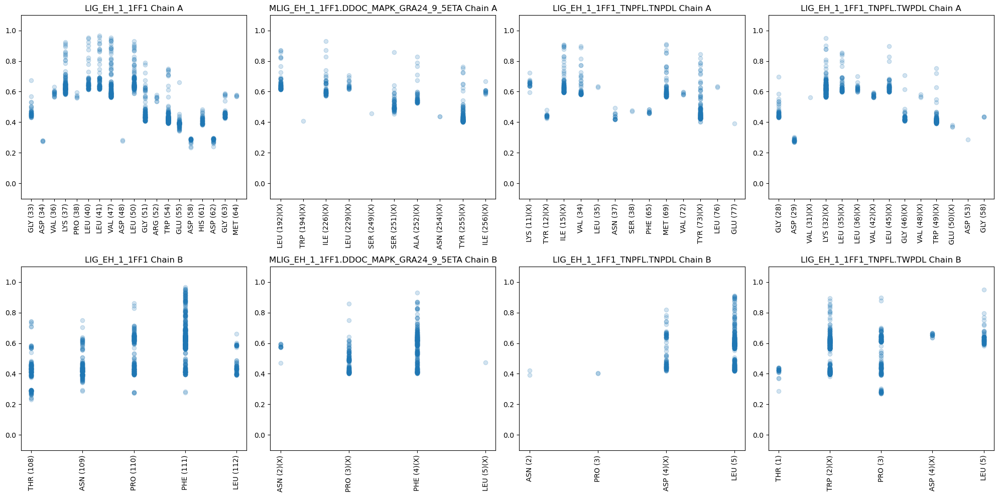

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
119,LIG_UFM1_UFIM_1_5HKH,5HKH,LIG_UFM1_UFIM_1,None,None,None,None,<Interface of 1390 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
241,MLIG_UFM1_UFIM_1_5HKH.DLIG_KLC1_Yacidic_2_6FUZ,5HKH,MLIG_UFM1_UFIM_1,6FUZ,DLIG_KLC1_Yacidic_2,None,None,<Interface of 1932 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
501,LIG_UFM1_UFIM_1_5HKH_NEWGIELV.NEWGIEDD,5HKH,LIG_UFM1_UFIM_1,None,None,NEWGIELV,NEWGIEDD,<Interface of 1121 pairs>
502,LIG_UFM1_UFIM_1_5HKH_NEWGIELV.NEWGIEDV,5HKH,LIG_UFM1_UFIM_1,None,None,NEWGIELV,NEWGIEDV,<Interface of 1127 pairs>


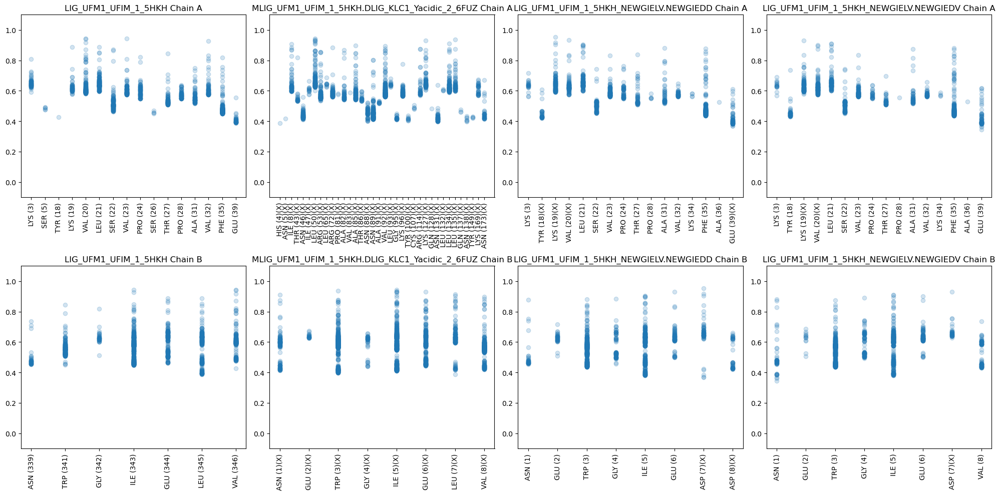

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
60,LIG_EVH1_1_1EVH,1EVH,LIG_EVH1_1,None,None,None,None,<Interface of 1141 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
183,MLIG_EVH1_1_1EVH.DLIG_Actin_WH2_1_2A41,1EVH,MLIG_EVH1_1,2A41,DLIG_Actin_WH2_1,None,None,<Interface of 926 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
387,LIG_EVH1_1_1EVH_FPPPP.DWPPP,1EVH,LIG_EVH1_1,None,None,FPPPP,DWPPP,<Interface of 888 pairs>
388,LIG_EVH1_1_1EVH_FPPPP.FWPPP,1EVH,LIG_EVH1_1,None,None,FPPPP,FWPPP,<Interface of 1046 pairs>


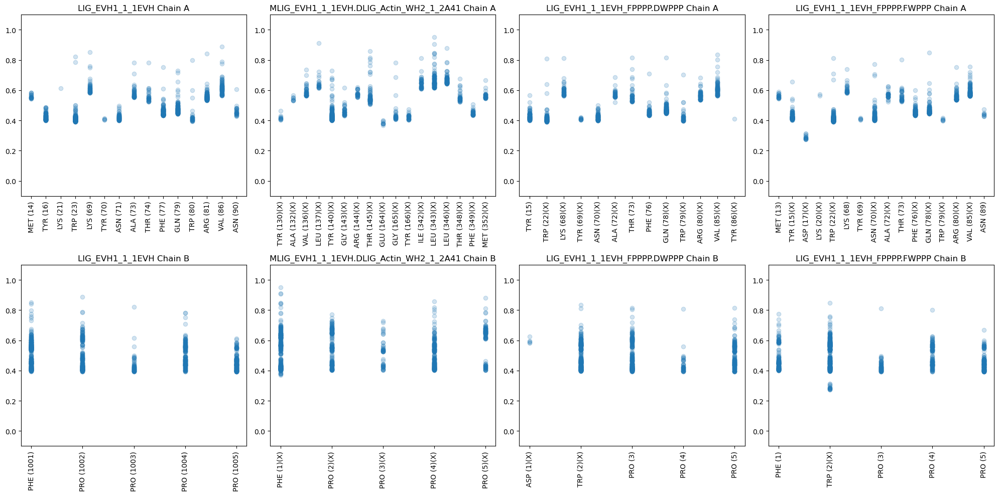

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
4,DEG_MDM2_SWIB_1_1YCR,1YCR,DEG_MDM2_SWIB_1,None,None,None,None,<Interface of 1422 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
128,MDEG_MDM2_SWIB_1_1YCR.DLIG_PCNA_APIM_2_5MLW,1YCR,MDEG_MDM2_SWIB_1,5MLW,DLIG_PCNA_APIM_2,None,None,<Interface of 1788 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
277,DEG_MDM2_SWIB_1_1YCR_FSDLWKLL.FSDLGKLD,1YCR,DEG_MDM2_SWIB_1,None,None,FSDLWKLL,FSDLGKLD,<Interface of 1208 pairs>
278,DEG_MDM2_SWIB_1_1YCR_FSDLWKLL.FSDLWKLD,1YCR,DEG_MDM2_SWIB_1,None,None,FSDLWKLL,FSDLWKLD,<Interface of 1423 pairs>


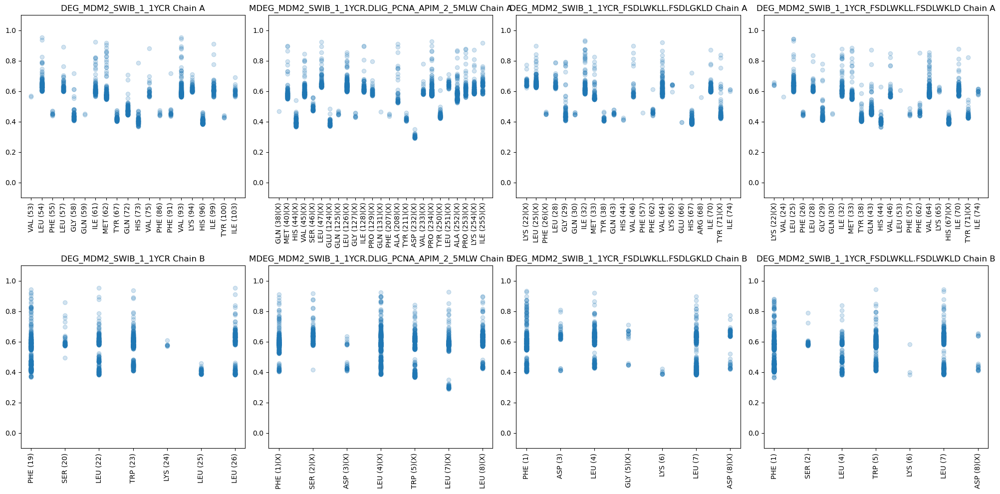

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
18,DOC_MAPK_JIP1_4_4H3B,4H3B,DOC_MAPK_JIP1_4,None,None,None,None,<Interface of 1632 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
142,MDOC_MAPK_JIP1_4_4H3B.DLIG_PAM2_1_1JGN,4H3B,MDOC_MAPK_JIP1_4,1JGN,DLIG_PAM2_1,None,None,<Interface of 687 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
305,DOC_MAPK_JIP1_4_4H3B_RPGSLDL.RWGSDDL,4H3B,DOC_MAPK_JIP1_4,None,None,RPGSLDL,RWGSDDL,<Interface of 1105 pairs>
306,DOC_MAPK_JIP1_4_4H3B_RPGSLDL.RWGSLDL,4H3B,DOC_MAPK_JIP1_4,None,None,RPGSLDL,RWGSLDL,<Interface of 1126 pairs>


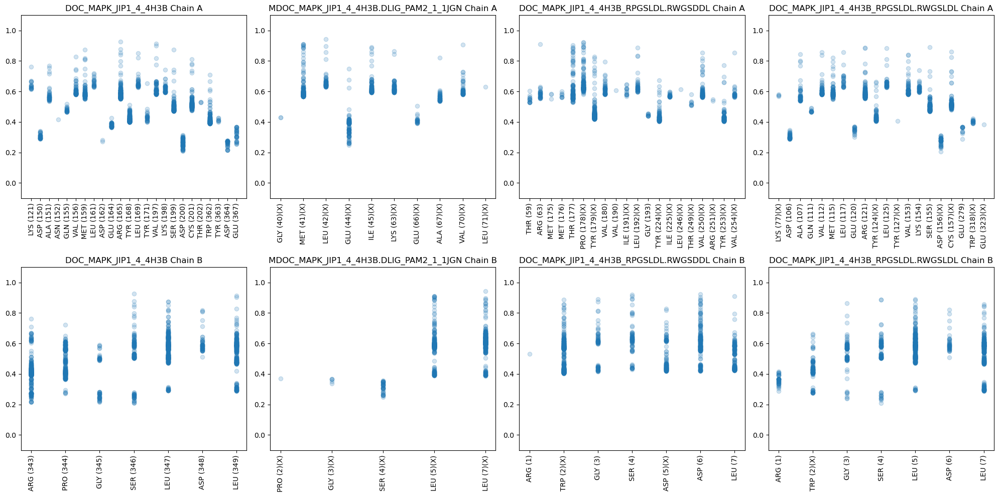

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
7,DEG_SCF_TIR1_1_2P1Q,2P1Q,DEG_SCF_TIR1_1,None,None,None,None,<Interface of 1778 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
131,MDEG_SCF_TIR1_1_2P1Q.DLIG_ULM_U2AF65_1_1O0P,2P1Q,MDEG_SCF_TIR1_1,1O0P,DLIG_ULM_U2AF65_1,None,None,<Interface of 1429 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
283,DEG_SCF_TIR1_1_2P1Q_QVVGWPPVRNYRK.QVDGWPPDRNYRK,2P1Q,DEG_SCF_TIR1_1,None,None,QVVGWPPVRNYRK,QVDGWPPDRNYRK,<Interface of 3021 pairs>
284,DEG_SCF_TIR1_1_2P1Q_QVVGWPPVRNYRK.QVDGWPPVRNYRK,2P1Q,DEG_SCF_TIR1_1,None,None,QVVGWPPVRNYRK,QVDGWPPVRNYRK,<Interface of 2426 pairs>


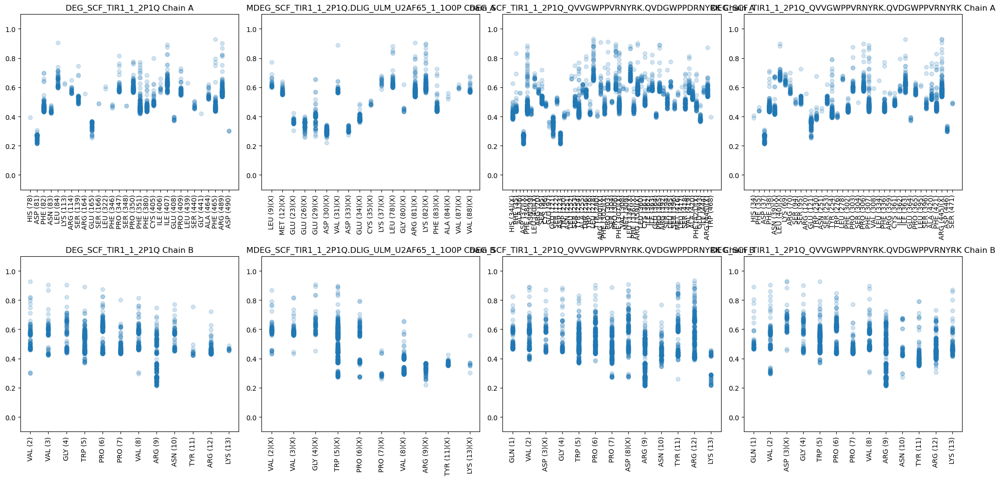

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
97,LIG_PDZ_Wminus1_1_1ZUB,1ZUB,LIG_PDZ_Wminus1_1,None,None,None,None,<Interface of 1785 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
220,MLIG_PDZ_Wminus1_1_1ZUB.DDEG_Kelch_Keap1_2_3WN7,1ZUB,MLIG_PDZ_Wminus1_1,3WN7,DDEG_Kelch_Keap1_2,None,None,<Interface of 963 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
459,LIG_PDZ_Wminus1_1_1ZUB_GIWA.GIGA,1ZUB,LIG_PDZ_Wminus1_1,None,None,GIWA,GIGA,<Interface of 1004 pairs>
460,LIG_PDZ_Wminus1_1_1ZUB_GIWA.GIGW,1ZUB,LIG_PDZ_Wminus1_1,None,None,GIWA,GIGW,<Interface of 1324 pairs>


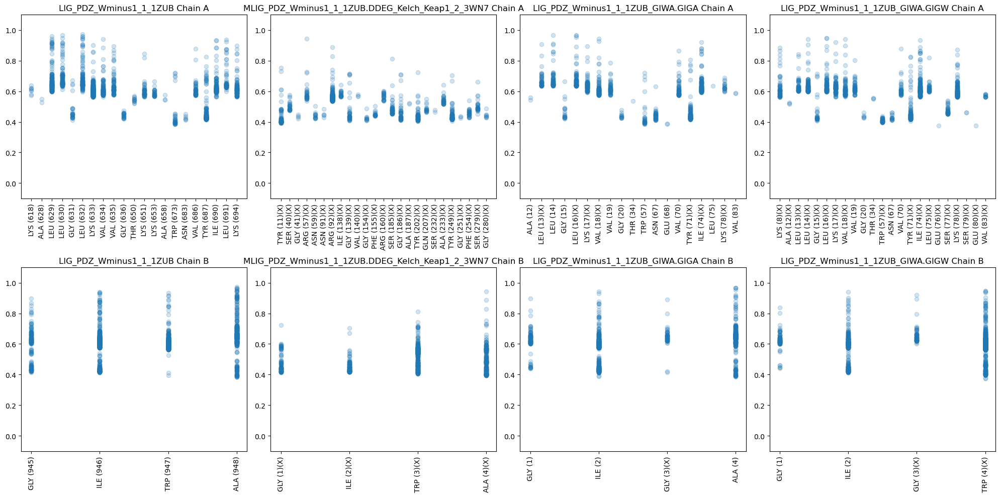

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
103,LIG_Rb_LxCxE_1_1GH6,1GH6,LIG_Rb_LxCxE_1,None,None,None,None,<Interface of 1394 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
226,MLIG_Rb_LxCxE_1_1GH6.DLIG_EVH1_1_1EVH,1GH6,MLIG_Rb_LxCxE_1,1EVH,DLIG_EVH1_1,None,None,<Interface of 1396 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
471,LIG_Rb_LxCxE_1_1GH6_ENLFCSEEMPSSDDEAT.ENLFCSEE...,1GH6,LIG_Rb_LxCxE_1,None,None,ENLFCSEEMPSSDDEAT,ENLFCSEEMPSSDDEAW,<Interface of 2213 pairs>
472,LIG_Rb_LxCxE_1_1GH6_ENLFCSEEMPSSDDEAT.ENLFCSEE...,1GH6,LIG_Rb_LxCxE_1,None,None,ENLFCSEEMPSSDDEAT,ENLFCSEEMWSSDDEAW,<Interface of 2089 pairs>


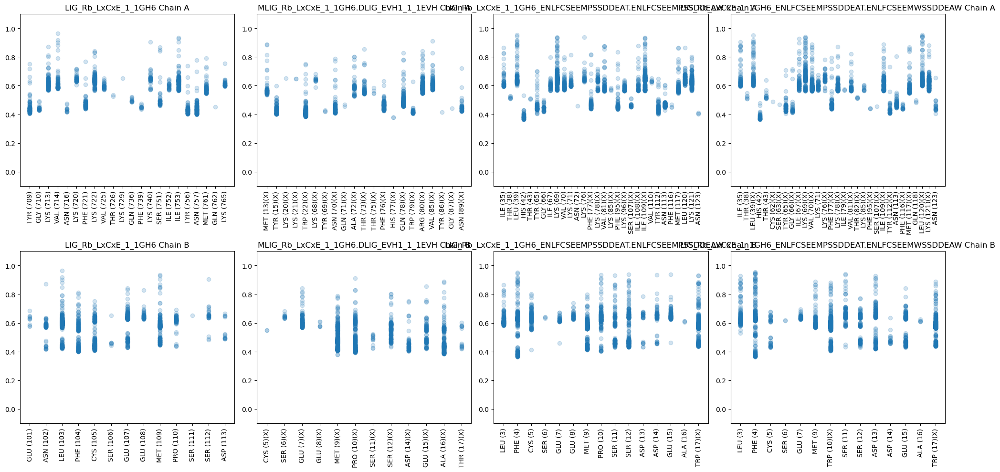

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
265,TRG_LysEnd_GGAAcLL_1_1JWG,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,None,None,<Interface of 1797 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
256,MTRG_LysEnd_GGAAcLL_1_1JWG.DLIG_SUMO_SIM_anti_...,1JWG,MTRG_LysEnd_GGAAcLL_1,2KQS,DLIG_SUMO_SIM_anti_2,None,None,<Interface of 1285 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
529,TRG_LysEnd_GGAAcLL_1_1JWG_DEDLLHI.DEDLDHI,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,DEDLLHI,DEDLDHI,<Interface of 1459 pairs>
530,TRG_LysEnd_GGAAcLL_1_1JWG_DEDLLHI.WEDLDHI,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,DEDLLHI,WEDLDHI,<Interface of 1259 pairs>


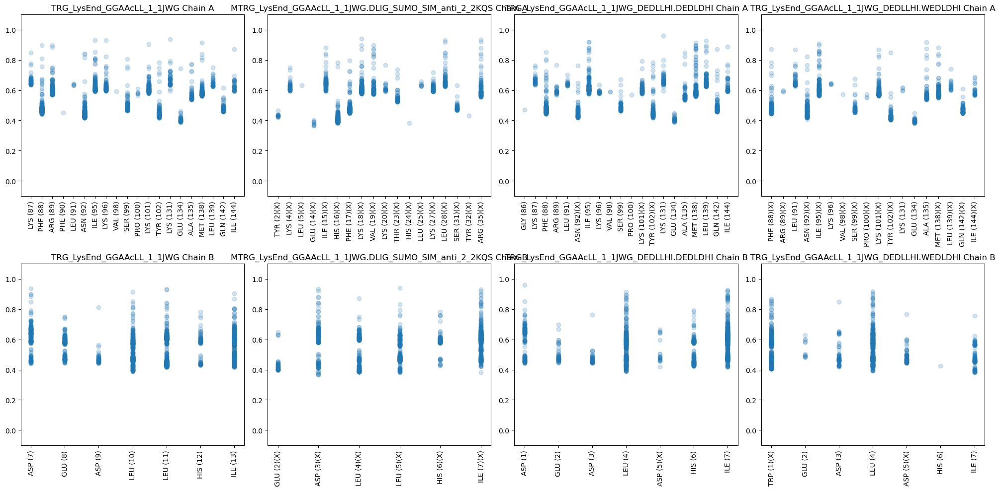

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
72,LIG_LIR_Apic_2_4EOY,4EOY,LIG_LIR_Apic_2,None,None,None,None,<Interface of 1383 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
195,MLIG_LIR_Apic_2_4EOY.DLIG_Sin3_1_1PD7,4EOY,MLIG_LIR_Apic_2,1PD7,DLIG_Sin3_1,None,None,<Interface of 663 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
409,LIG_LIR_Apic_2_4EOY_NDWLLP.NWWLLP,4EOY,LIG_LIR_Apic_2,None,None,NDWLLP,NWWLLP,<Interface of 1741 pairs>
410,LIG_LIR_Apic_2_4EOY_NDWLLP.NWWLLW,4EOY,LIG_LIR_Apic_2,None,None,NDWLLP,NWWLLW,<Interface of 1663 pairs>


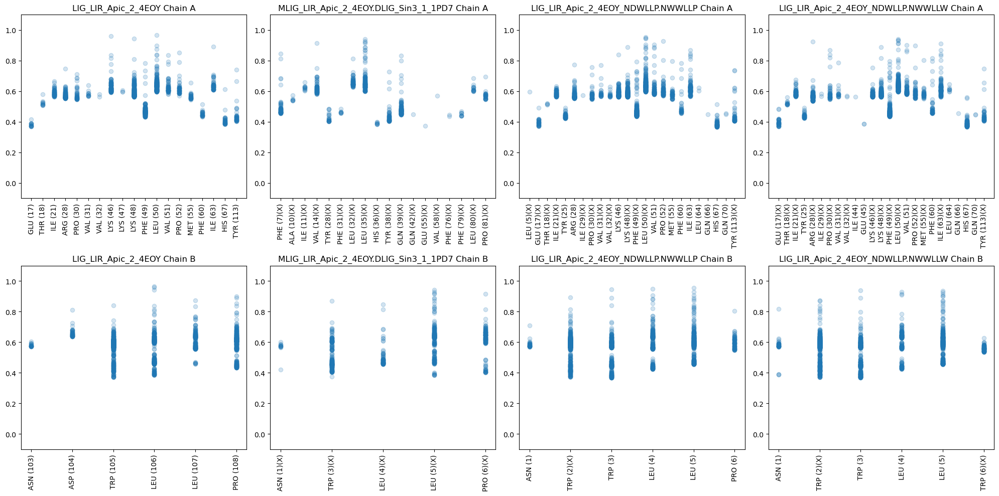

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
87,LIG_PALB2_WD40_1_3EU7,3EU7,LIG_PALB2_WD40_1,None,None,None,None,<Interface of 1450 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
210,MLIG_PALB2_WD40_1_3EU7.DLIG_Actin_RPEL_3_2V52,3EU7,MLIG_PALB2_WD40_1,2V52,DLIG_Actin_RPEL_3,None,None,<Interface of 1141 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
439,LIG_PALB2_WD40_1_3EU7_ISLNWFEEL.ISLNWDEED,3EU7,LIG_PALB2_WD40_1,None,None,ISLNWFEEL,ISLNWDEED,<Interface of 1524 pairs>
440,LIG_PALB2_WD40_1_3EU7_ISLNWFEEL.ISLNWDEEL,3EU7,LIG_PALB2_WD40_1,None,None,ISLNWFEEL,ISLNWDEEL,<Interface of 1392 pairs>


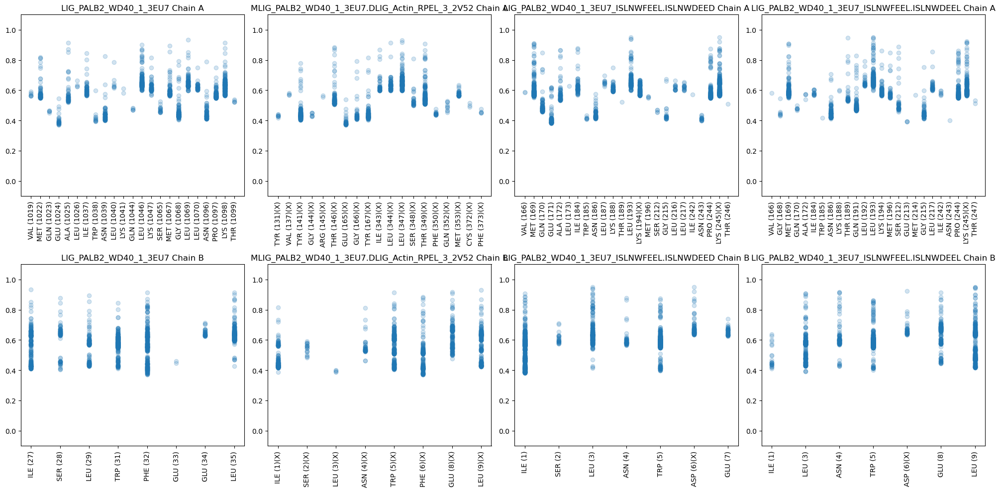

2


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
55,LIG_DLG_GKlike_1_3WP0,3WP0,LIG_DLG_GKlike_1,None,None,None,None,<Interface of 1007 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
178,MLIG_DLG_GKlike_1_3WP0.DTRG_ER_FFAT_1_2RR3,3WP0,MLIG_DLG_GKlike_1,2RR3,DTRG_ER_FFAT_1,None,None,<Interface of 1298 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


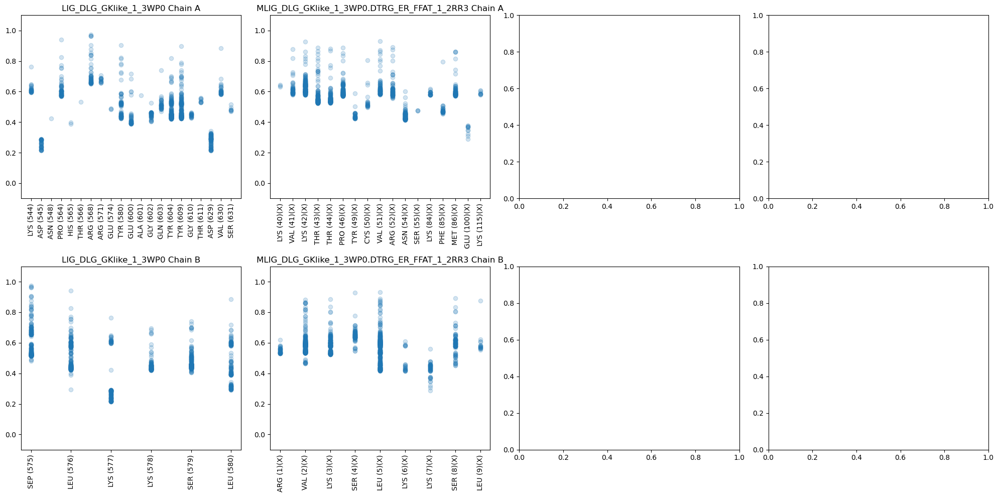

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
42,LIG_BH_BH3_1_2ROC,2ROC,LIG_BH_BH3_1,None,None,None,None,<Interface of 2468 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
165,MLIG_BH_BH3_1_2ROC.DLIG_Actin_WH2_2_2D1K,2ROC,MLIG_BH_BH3_1,2D1K,DLIG_Actin_WH2_2,None,None,<Interface of 1403 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
353,LIG_BH_BH3_1_2ROC_WAREIGAQLRRIADDLN.WAREIGAQLR...,2ROC,LIG_BH_BH3_1,None,None,WAREIGAQLRRIADDLN,WAREIGAQLRRDADDLN,<Interface of 2602 pairs>
354,LIG_BH_BH3_1_2ROC_WAREIGAQLRRIADDLN.WAREIGAQLR...,2ROC,LIG_BH_BH3_1,None,None,WAREIGAQLRRIADDLN,WAREIGAQLRRDWDDLN,<Interface of 2705 pairs>


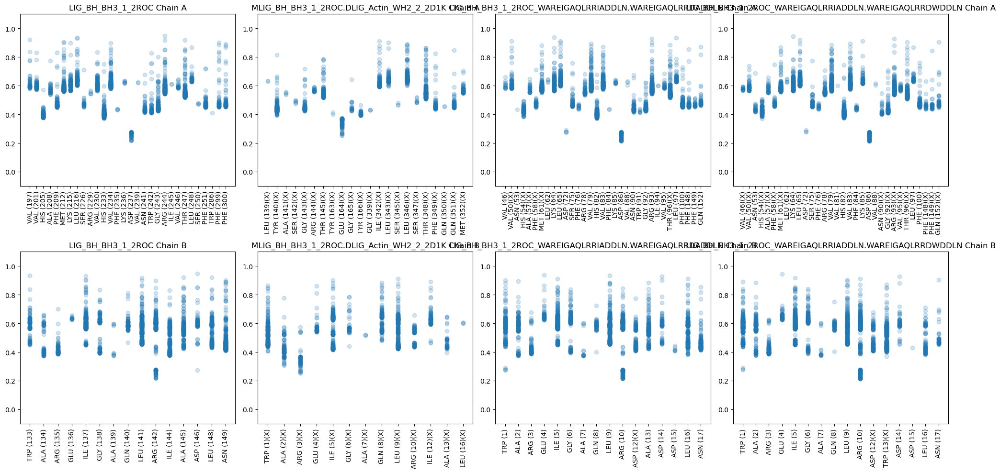

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
109,LIG_SH3_CIN85_PxpxPR_1_2BZ8,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,None,None,<Interface of 999 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
232,MLIG_SH3_CIN85_PxpxPR_1_2BZ8.DLIG_PAM2_1_1JGN,2BZ8,MLIG_SH3_CIN85_PxpxPR_1,1JGN,DLIG_PAM2_1,None,None,<Interface of 265 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
483,LIG_SH3_CIN85_PxpxPR_1_2BZ8_PKPRPR.PKPRPG,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,PKPRPR,PKPRPG,<Interface of 1007 pairs>
484,LIG_SH3_CIN85_PxpxPR_1_2BZ8_PKPRPR.PKPRWG,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,PKPRPR,PKPRWG,<Interface of 849 pairs>


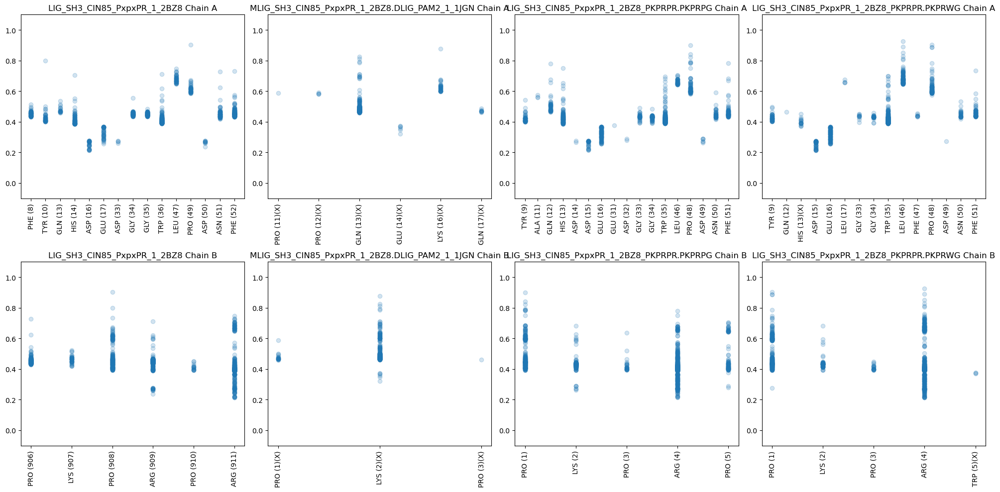

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
113,LIG_SUMO_SIM_anti_2_2KQS,2KQS,LIG_SUMO_SIM_anti_2,None,None,None,None,<Interface of 1850 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
235,MLIG_SUMO_SIM_anti_2_2KQS.DLIG_APCC_ABBA_1_4BH6,2KQS,MLIG_SUMO_SIM_anti_2,4BH6,DLIG_APCC_ABBA_1,None,None,<Interface of 965 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
489,LIG_SUMO_SIM_anti_2_2KQS_EIIVLSDSD.EIDVLSDWD,2KQS,LIG_SUMO_SIM_anti_2,None,None,EIIVLSDSD,EIDVLSDWD,<Interface of 1422 pairs>
490,LIG_SUMO_SIM_anti_2_2KQS_EIIVLSDSD.EIIVLSDWD,2KQS,LIG_SUMO_SIM_anti_2,None,None,EIIVLSDSD,EIIVLSDWD,<Interface of 1766 pairs>


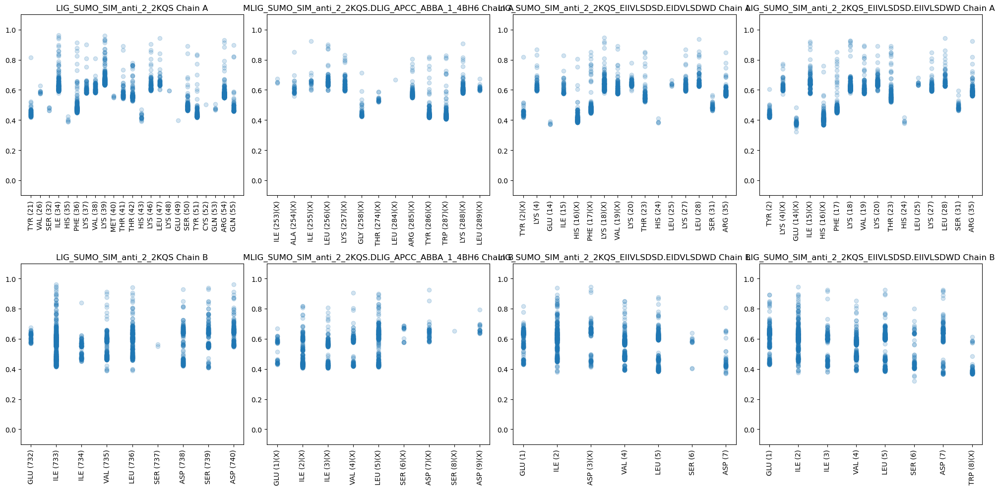

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
157,MLIG_Actin_RPEL_3_2V52.DLIG_ActinCP_TwfCPI_2_7DS2,2V52,MLIG_Actin_RPEL_3,7DS2,DLIG_ActinCP_TwfCPI_2,None,None,<Interface of 3866 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
337,LIG_Actin_RPEL_3_2V52_LKRKIRSRPERAELVRMHIL.LKR...,2V52,LIG_Actin_RPEL_3,None,None,LKRKIRSRPERAELVRMHIL,LKRKIRSGPERAELVRMHDL,<Interface of 1772 pairs>
338,LIG_Actin_RPEL_3_2V52_LKRKIRSRPERAELVRMHIL.LKR...,2V52,LIG_Actin_RPEL_3,None,None,LKRKIRSRPERAELVRMHIL,LKRKIRSGPERAELVRMHIL,<Interface of 1553 pairs>


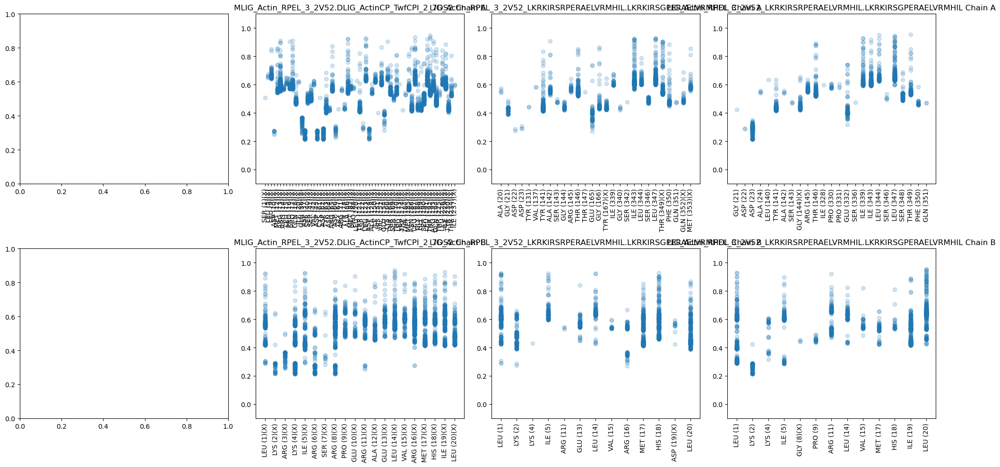

In [88]:
# with (10, 5, 5) shape
for pdb_id in pdb_ids_test:
    visualize_interface(pdb_id)

And now with residues, distance and atom types

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
33,LIG_ActinCP_TwfCPI_2_7DS2,7DS2,LIG_ActinCP_TwfCPI_2,None,None,None,None,<Interface of 1972 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
335,LIG_ActinCP_TwfCPI_2_7DS2_FAKPKGPAGKR.DAKPKGPAGKR,7DS2,LIG_ActinCP_TwfCPI_2,None,None,FAKPKGPAGKR,DAKPKGPAGKR,<Interface of 1907 pairs>
336,LIG_ActinCP_TwfCPI_2_7DS2_FAKPKGPAGKR.DAKPKGWAGKR,7DS2,LIG_ActinCP_TwfCPI_2,None,None,FAKPKGPAGKR,DAKPKGWAGKR,<Interface of 2131 pairs>


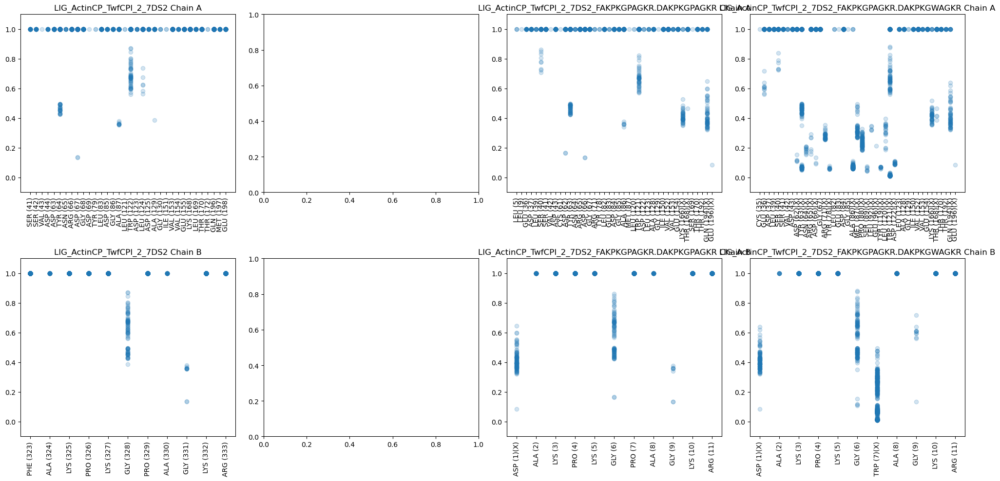

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
263,TRG_ENDOCYTIC_2_1BXX,1BXX,TRG_ENDOCYTIC_2,None,None,None,None,<Interface of 1436 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
254,MTRG_ENDOCYTIC_2_1BXX.DTRG_ER_FFAT_1_2RR3,1BXX,MTRG_ENDOCYTIC_2,2RR3,DTRG_ER_FFAT_1,None,None,<Interface of 1276 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
525,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRD,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRD,<Interface of 393 pairs>
526,TRG_ENDOCYTIC_2_1BXX_YQRL.GQRL,1BXX,TRG_ENDOCYTIC_2,None,None,YQRL,GQRL,<Interface of 845 pairs>


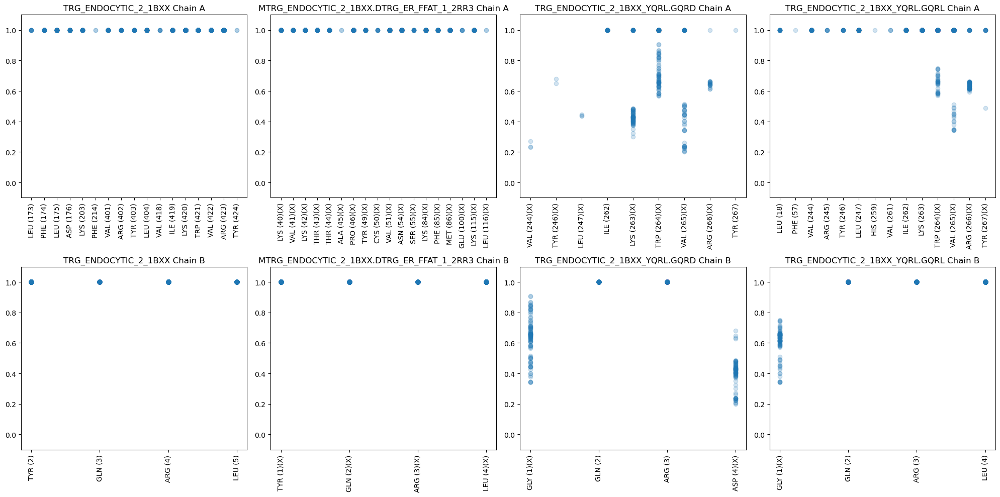

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
244,MLIG_WD40_WDR5_VDV_1_4CY2.DLIG_BIR_III_3_1JD5,4CY2,MLIG_WD40_WDR5_VDV_1,1JD5,DLIG_BIR_III_3,None,None,<Interface of 598 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
507,LIG_WD40_WDR5_VDV_1_4CY2_DLDV.DDDD,4CY2,LIG_WD40_WDR5_VDV_1,None,None,DLDV,DDDD,<Interface of 277 pairs>
508,LIG_WD40_WDR5_VDV_1_4CY2_DLDV.DLDD,4CY2,LIG_WD40_WDR5_VDV_1,None,None,DLDV,DLDD,<Interface of 628 pairs>


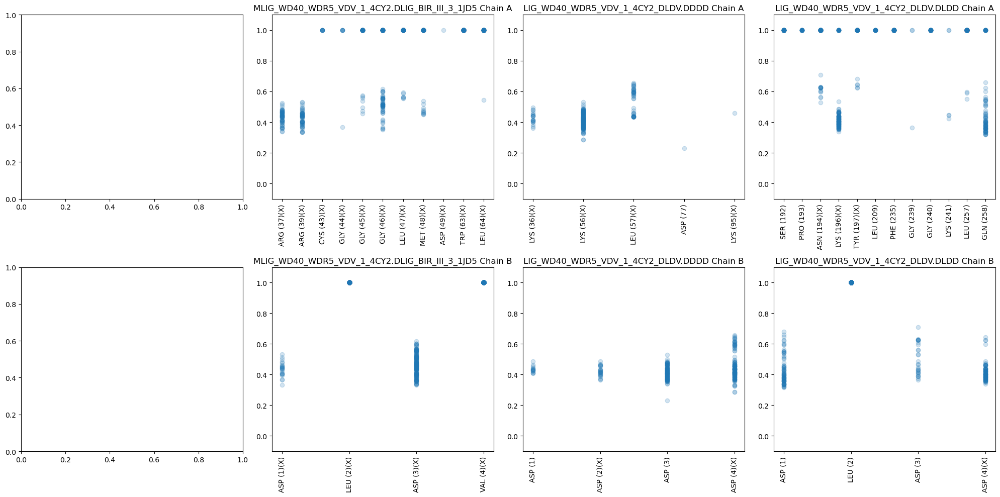

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
104,LIG_Rb_pABgroove_1_1N4M,1N4M,LIG_Rb_pABgroove_1,None,None,None,None,<Interface of 1437 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
227,MLIG_Rb_pABgroove_1_1N4M.DLIG_WD40_WDR5_WIN_1_...,1N4M,MLIG_Rb_pABgroove_1,3UVK,DLIG_WD40_WDR5_WIN_1,None,None,<Interface of 1613 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
473,LIG_Rb_pABgroove_1_1N4M_EGISDLFD.EGDSDLFD,1N4M,LIG_Rb_pABgroove_1,None,None,EGISDLFD,EGDSDLFD,<Interface of 1294 pairs>
474,LIG_Rb_pABgroove_1_1N4M_EGISDLFD.EGDSDLFW,1N4M,LIG_Rb_pABgroove_1,None,None,EGISDLFD,EGDSDLFW,<Interface of 1016 pairs>


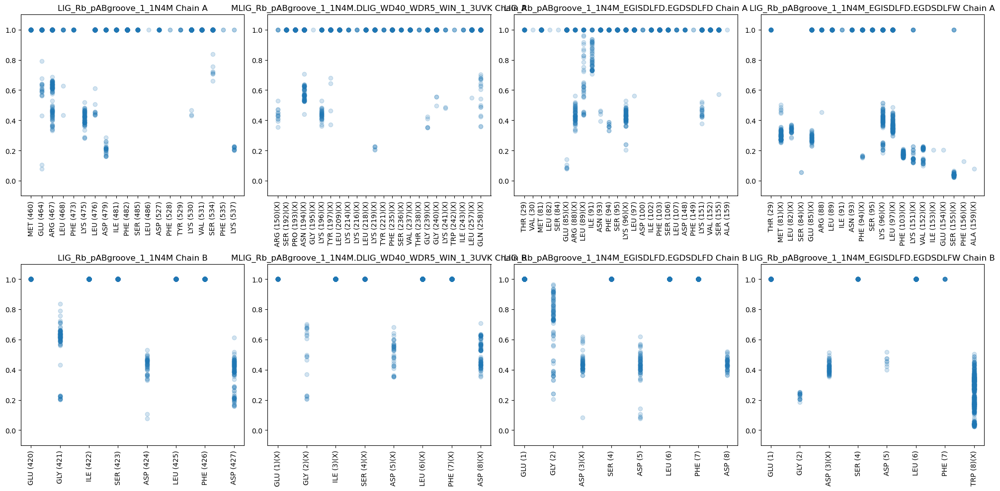

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
122,LIG_WD40_WDR5_WIN_2_4CY3,4CY3,LIG_WD40_WDR5_WIN_2,None,None,None,None,<Interface of 1759 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
511,LIG_WD40_WDR5_WIN_2_4CY3_CSRARPL.CSRAGWL,4CY3,LIG_WD40_WDR5_WIN_2,None,None,CSRARPL,CSRAGWL,<Interface of 1439 pairs>
512,LIG_WD40_WDR5_WIN_2_4CY3_CSRARPL.CSRARWL,4CY3,LIG_WD40_WDR5_WIN_2,None,None,CSRARPL,CSRARWL,<Interface of 1537 pairs>


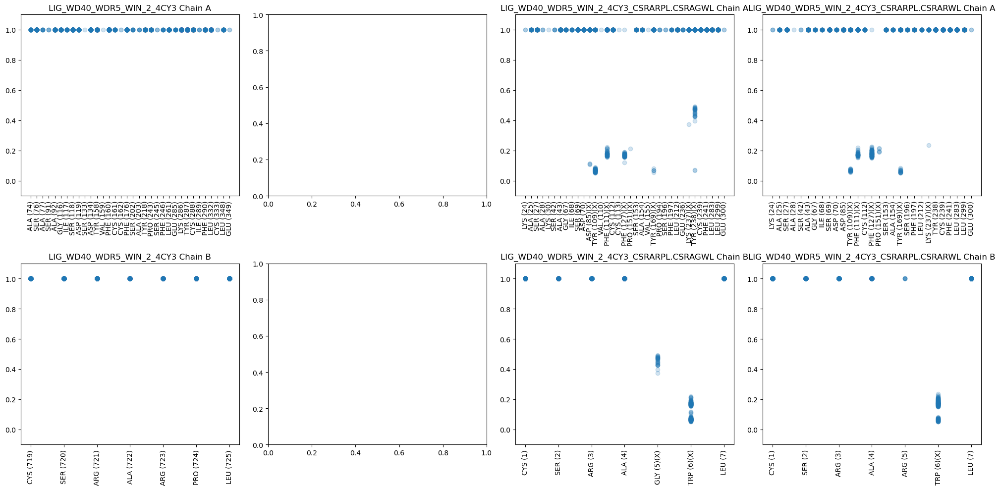

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
0,DEG_APCC_KENBOX_2_4GGD,4GGD,DEG_APCC_KENBOX_2,None,None,None,None,<Interface of 920 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
124,MDEG_APCC_KENBOX_2_4GGD.DTRG_AP2beta_CARGO_1_2G30,4GGD,MDEG_APCC_KENBOX_2,2G30,DTRG_AP2beta_CARGO_1,None,None,<Interface of 1036 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
269,DEG_APCC_KENBOX_2_4GGD_SKENV.SGENV,4GGD,DEG_APCC_KENBOX_2,None,None,SKENV,SGENV,<Interface of 771 pairs>
270,DEG_APCC_KENBOX_2_4GGD_SKENV.SGEWV,4GGD,DEG_APCC_KENBOX_2,None,None,SKENV,SGEWV,<Interface of 663 pairs>


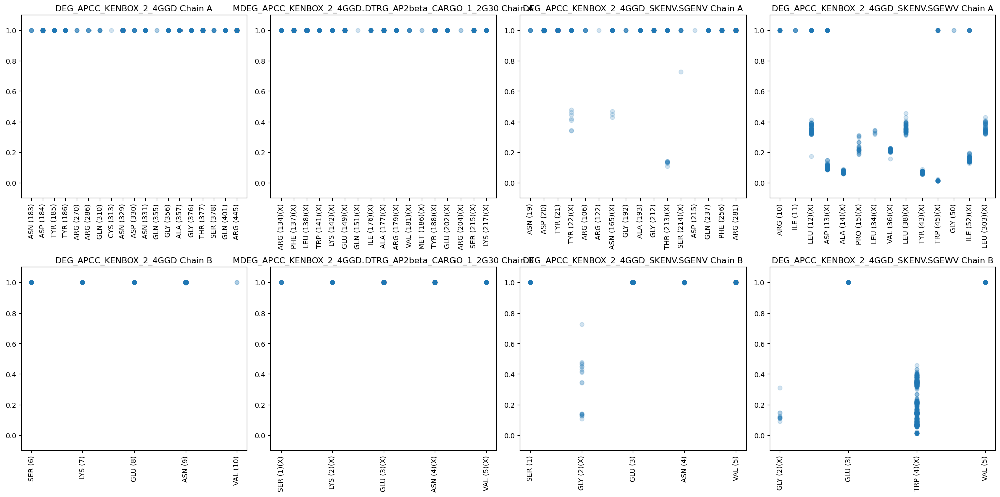

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
10,DOC_AGCK_PIF_3_1ATP,1ATP,DOC_AGCK_PIF_3,None,None,None,None,<Interface of 1160 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
134,MDOC_AGCK_PIF_3_1ATP.DDEG_Kelch_Keap1_1_2FLU,1ATP,MDOC_AGCK_PIF_3,2FLU,DDEG_Kelch_Keap1_1,None,None,<Interface of 1017 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
289,DOC_AGCK_PIF_3_1ATP_FTEF.DTED,1ATP,DOC_AGCK_PIF_3,None,None,FTEF,DTED,<Interface of 292 pairs>
290,DOC_AGCK_PIF_3_1ATP_FTEF.FTED,1ATP,DOC_AGCK_PIF_3,None,None,FTEF,FTED,<Interface of 671 pairs>


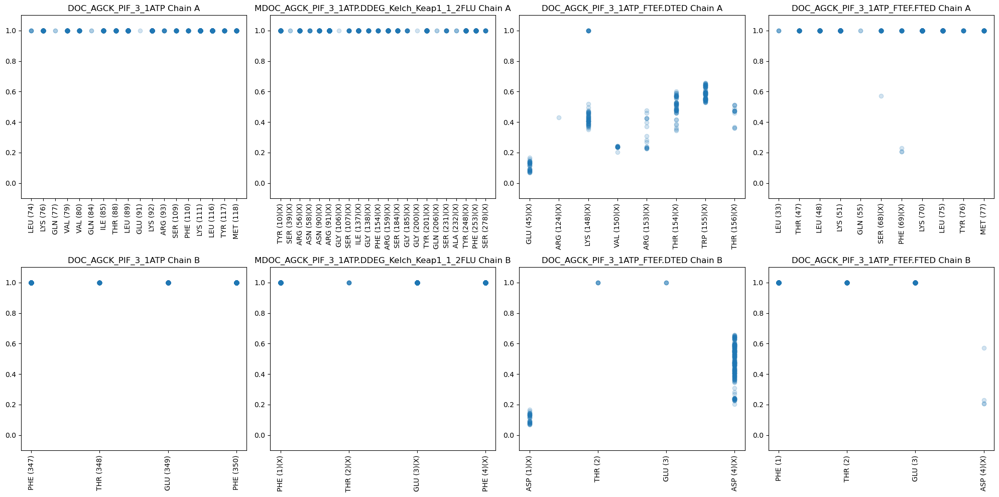

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
38,LIG_AP2alpha_1_1KY7,1KY7,LIG_AP2alpha_1,None,None,None,None,<Interface of 1140 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
161,MLIG_AP2alpha_1_1KY7.DLIG_PAM2_1_1JGN,1KY7,MLIG_AP2alpha_1,1JGN,DLIG_PAM2_1,None,None,<Interface of 488 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
345,LIG_AP2alpha_1_1KY7_FEDNF.DEDNF,1KY7,LIG_AP2alpha_1,None,None,FEDNF,DEDNF,<Interface of 566 pairs>
346,LIG_AP2alpha_1_1KY7_FEDNF.DEWNF,1KY7,LIG_AP2alpha_1,None,None,FEDNF,DEWNF,<Interface of 719 pairs>


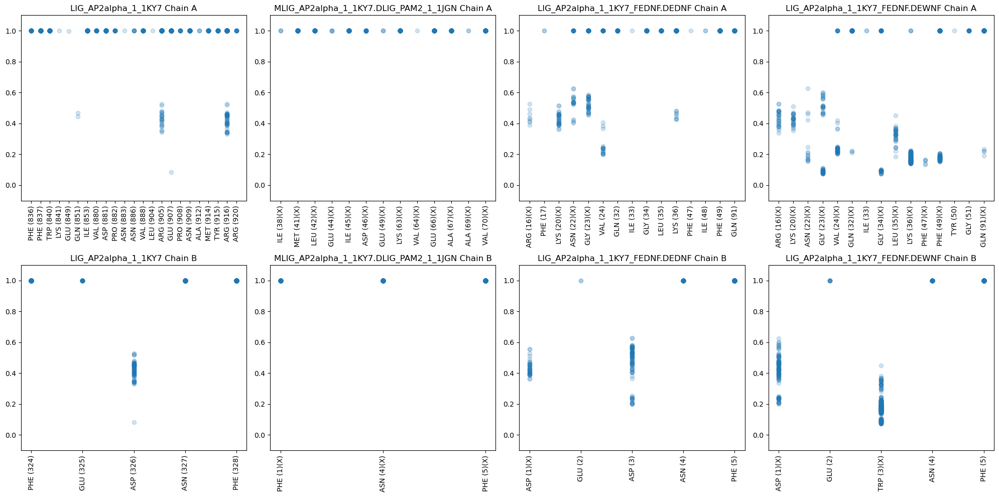

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
63,LIG_FAT_LD_1_3GM1,3GM1,LIG_FAT_LD_1,None,None,None,None,<Interface of 1264 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
186,MLIG_FAT_LD_1_3GM1.DLIG_LIR_Nem_3_5AZG,3GM1,MLIG_FAT_LD_1,5AZG,DLIG_LIR_Nem_3,None,None,<Interface of 1306 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
393,LIG_FAT_LD_1_3GM1_LDELMASLS.LDEDDASLS,3GM1,LIG_FAT_LD_1,None,None,LDELMASLS,LDEDDASLS,<Interface of 1115 pairs>
394,LIG_FAT_LD_1_3GM1_LDELMASLS.LDEDMASLS,3GM1,LIG_FAT_LD_1,None,None,LDELMASLS,LDEDMASLS,<Interface of 1250 pairs>


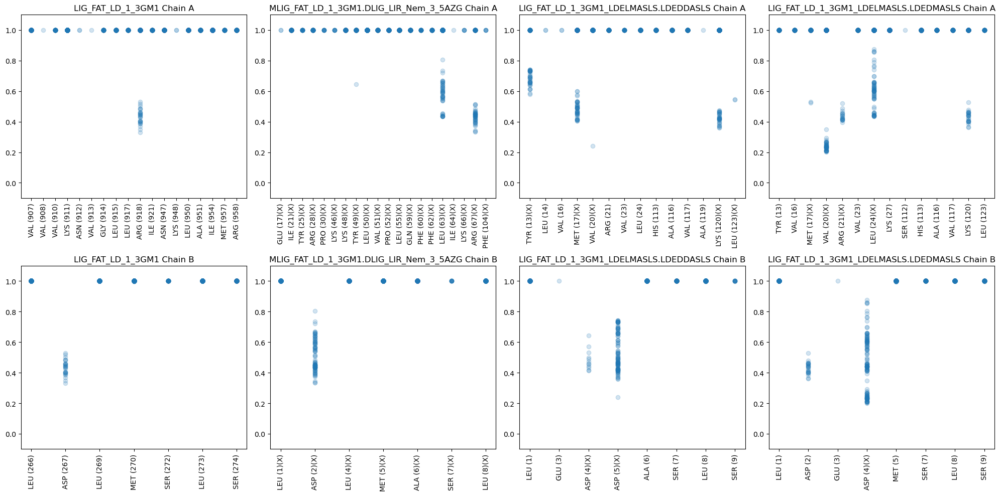

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
76,LIG_LRP6_Inhibitor_1_3SOQ,3SOQ,LIG_LRP6_Inhibitor_1,None,None,None,None,<Interface of 1360 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
199,MLIG_LRP6_Inhibitor_1_3SOQ.DTRG_NES_CRM1_1_3GB8,3SOQ,MLIG_LRP6_Inhibitor_1,3GB8,DTRG_NES_CRM1_1,None,None,<Interface of 1143 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
417,LIG_LRP6_Inhibitor_1_3SOQ_LNSNAIK.LNSNADG,3SOQ,LIG_LRP6_Inhibitor_1,None,None,LNSNAIK,LNSNADG,<Interface of 817 pairs>
418,LIG_LRP6_Inhibitor_1_3SOQ_LNSNAIK.LNSNAIG,3SOQ,LIG_LRP6_Inhibitor_1,None,None,LNSNAIK,LNSNAIG,<Interface of 883 pairs>


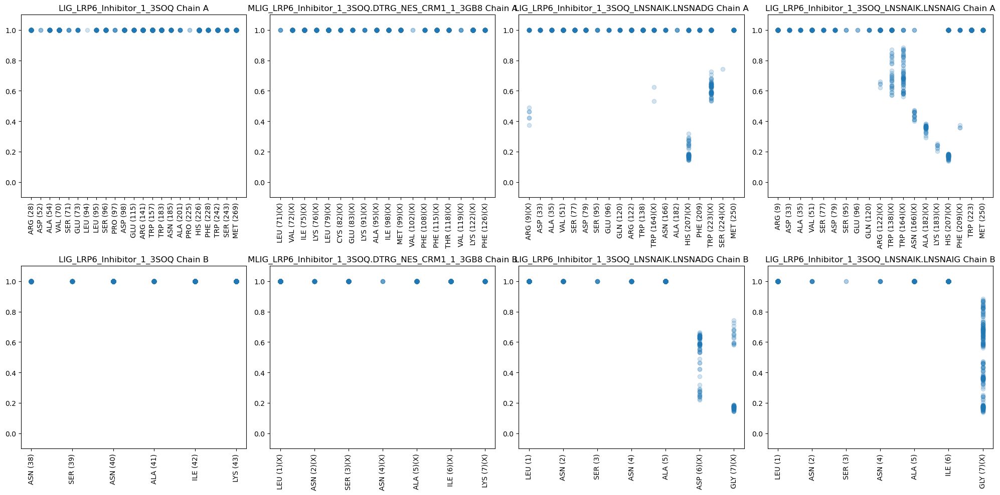

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
91,LIG_PCNA_PIPBox_1_1AXC,1AXC,LIG_PCNA_PIPBox_1,None,None,None,None,<Interface of 2158 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
214,MLIG_PCNA_PIPBox_1_1AXC.DLIG_PTB_Apo_2_1NTV,1AXC,MLIG_PCNA_PIPBox_1,1NTV,DLIG_PTB_Apo_2,None,None,<Interface of 1525 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
447,LIG_PCNA_PIPBox_1_1AXC_QTSMTDFYHS.QTSMTDDYHS,1AXC,LIG_PCNA_PIPBox_1,None,None,QTSMTDFYHS,QTSMTDDYHS,<Interface of 1733 pairs>
448,LIG_PCNA_PIPBox_1_1AXC_QTSMTDFYHS.WTSMTDDYHS,1AXC,LIG_PCNA_PIPBox_1,None,None,QTSMTDFYHS,WTSMTDDYHS,<Interface of 1412 pairs>


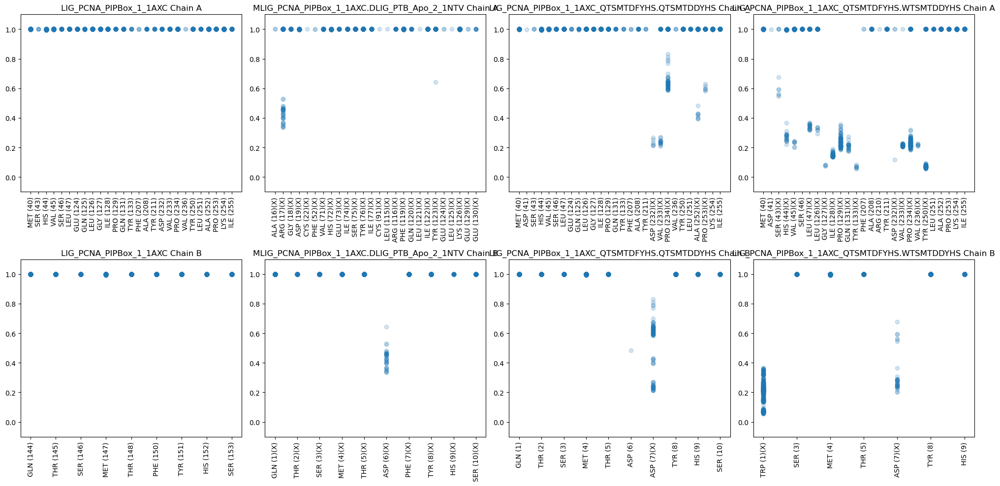

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
111,LIG_SPRY_1_2JK9,2JK9,LIG_SPRY_1,None,None,None,None,<Interface of 1168 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
233,MLIG_SPRY_1_2JK9.DLIG_BIR_III_3_1JD5,2JK9,MLIG_SPRY_1,1JD5,DLIG_BIR_III_3,None,None,<Interface of 1095 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
485,LIG_SPRY_1_2JK9_ELNNNL.ELWNNL,2JK9,LIG_SPRY_1,None,None,ELNNNL,ELWNNL,<Interface of 934 pairs>
486,LIG_SPRY_1_2JK9_ELNNNL.ELWNWL,2JK9,LIG_SPRY_1,None,None,ELNNNL,ELWNWL,<Interface of 873 pairs>


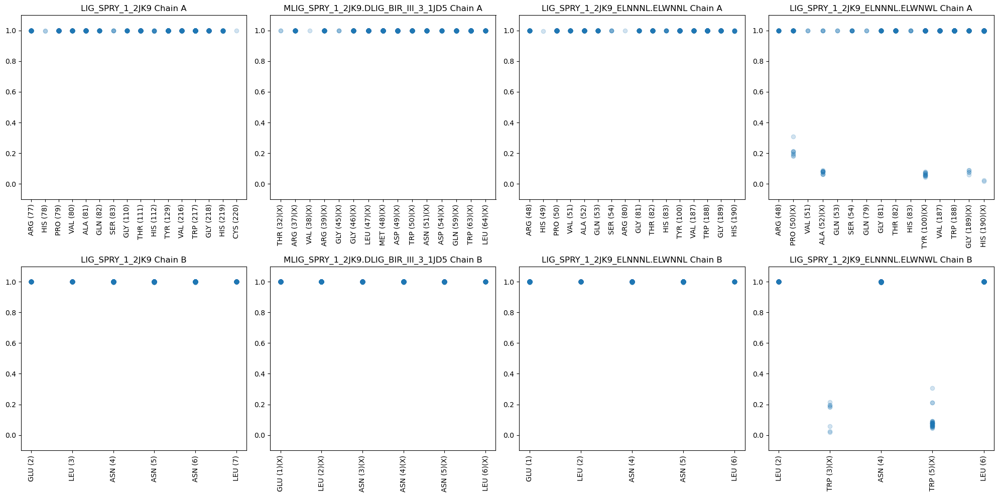

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
99,LIG_Pex14_3_4BXU,4BXU,LIG_Pex14_3,None,None,None,None,<Interface of 1187 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
222,MLIG_Pex14_3_4BXU.DLIG_Clathr_ClatBox_1_1C9I,4BXU,MLIG_Pex14_3,1C9I,DLIG_Clathr_ClatBox_1,None,None,<Interface of 1220 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
463,LIG_Pex14_3_4BXU_LVAEFL.LDAEFD,4BXU,LIG_Pex14_3,None,None,LVAEFL,LDAEFD,<Interface of 816 pairs>
464,LIG_Pex14_3_4BXU_LVAEFL.LVAEFD,4BXU,LIG_Pex14_3,None,None,LVAEFL,LVAEFD,<Interface of 428 pairs>


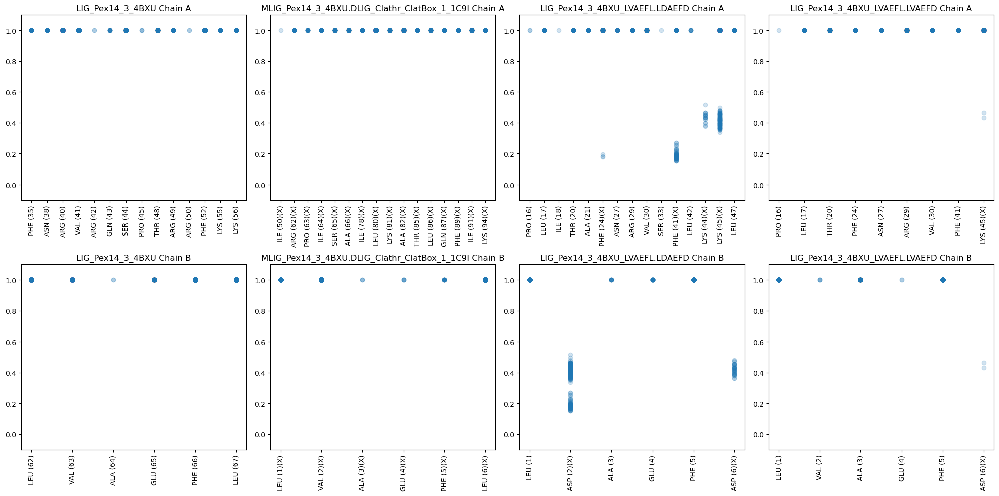

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
59,LIG_EH_1_1FF1,1FF1,LIG_EH_1,None,None,None,None,<Interface of 1325 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
181,MLIG_EH_1_1FF1.DDOC_MAPK_GRA24_9_5ETA,1FF1,MLIG_EH_1,5ETA,DDOC_MAPK_GRA24_9,None,None,<Interface of 460 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
385,LIG_EH_1_1FF1_TNPFL.TNPDL,1FF1,LIG_EH_1,None,None,TNPFL,TNPDL,<Interface of 478 pairs>
386,LIG_EH_1_1FF1_TNPFL.TWPDL,1FF1,LIG_EH_1,None,None,TNPFL,TWPDL,<Interface of 722 pairs>


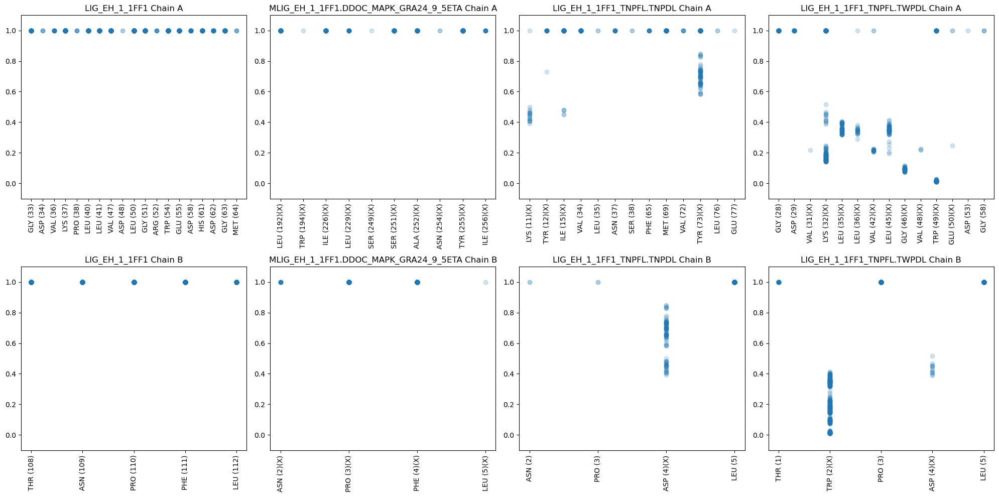

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
119,LIG_UFM1_UFIM_1_5HKH,5HKH,LIG_UFM1_UFIM_1,None,None,None,None,<Interface of 1390 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
241,MLIG_UFM1_UFIM_1_5HKH.DLIG_KLC1_Yacidic_2_6FUZ,5HKH,MLIG_UFM1_UFIM_1,6FUZ,DLIG_KLC1_Yacidic_2,None,None,<Interface of 1932 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
501,LIG_UFM1_UFIM_1_5HKH_NEWGIELV.NEWGIEDD,5HKH,LIG_UFM1_UFIM_1,None,None,NEWGIELV,NEWGIEDD,<Interface of 1121 pairs>
502,LIG_UFM1_UFIM_1_5HKH_NEWGIELV.NEWGIEDV,5HKH,LIG_UFM1_UFIM_1,None,None,NEWGIELV,NEWGIEDV,<Interface of 1127 pairs>


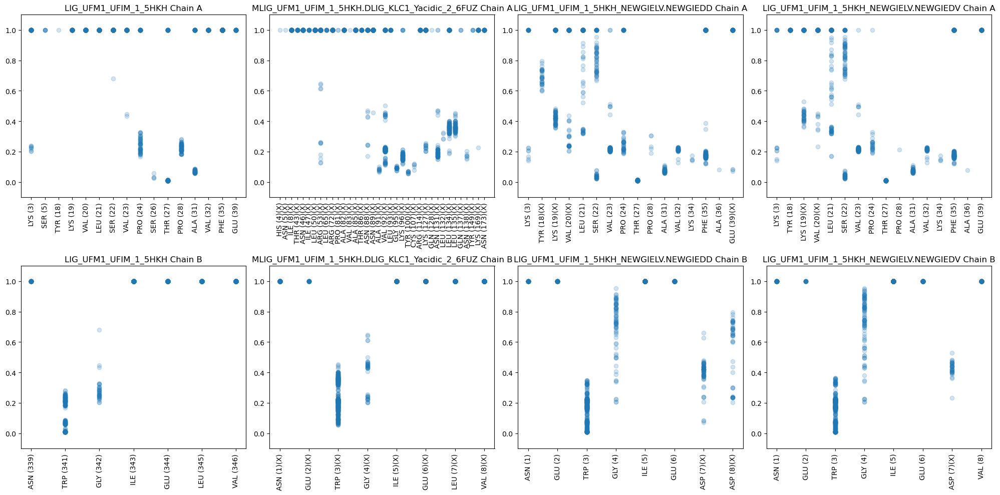

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
60,LIG_EVH1_1_1EVH,1EVH,LIG_EVH1_1,None,None,None,None,<Interface of 1141 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
183,MLIG_EVH1_1_1EVH.DLIG_Actin_WH2_1_2A41,1EVH,MLIG_EVH1_1,2A41,DLIG_Actin_WH2_1,None,None,<Interface of 926 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
387,LIG_EVH1_1_1EVH_FPPPP.DWPPP,1EVH,LIG_EVH1_1,None,None,FPPPP,DWPPP,<Interface of 888 pairs>
388,LIG_EVH1_1_1EVH_FPPPP.FWPPP,1EVH,LIG_EVH1_1,None,None,FPPPP,FWPPP,<Interface of 1046 pairs>


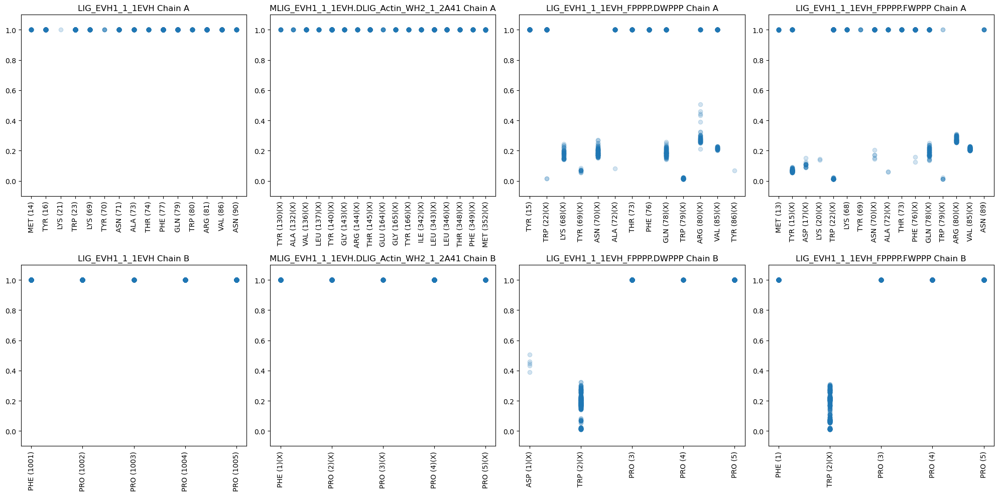

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
4,DEG_MDM2_SWIB_1_1YCR,1YCR,DEG_MDM2_SWIB_1,None,None,None,None,<Interface of 1422 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
128,MDEG_MDM2_SWIB_1_1YCR.DLIG_PCNA_APIM_2_5MLW,1YCR,MDEG_MDM2_SWIB_1,5MLW,DLIG_PCNA_APIM_2,None,None,<Interface of 1788 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
277,DEG_MDM2_SWIB_1_1YCR_FSDLWKLL.FSDLGKLD,1YCR,DEG_MDM2_SWIB_1,None,None,FSDLWKLL,FSDLGKLD,<Interface of 1208 pairs>
278,DEG_MDM2_SWIB_1_1YCR_FSDLWKLL.FSDLWKLD,1YCR,DEG_MDM2_SWIB_1,None,None,FSDLWKLL,FSDLWKLD,<Interface of 1423 pairs>


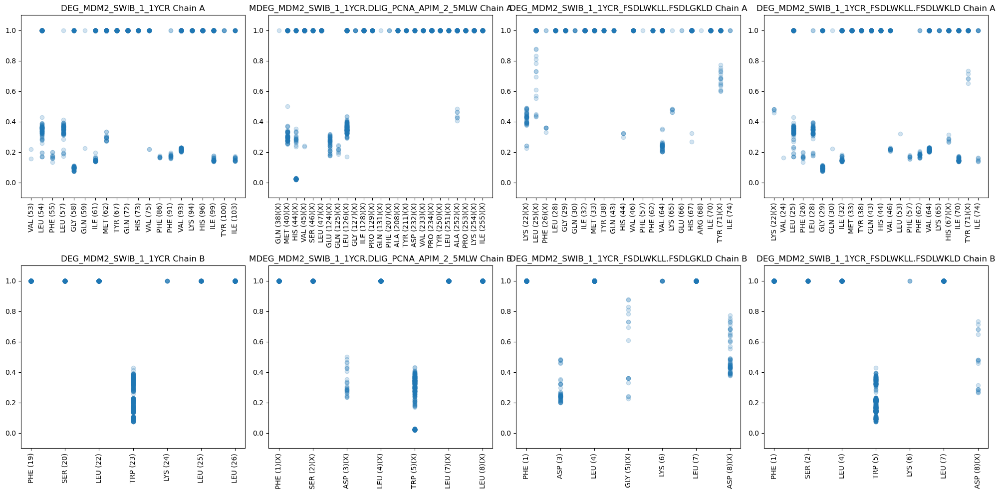

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
18,DOC_MAPK_JIP1_4_4H3B,4H3B,DOC_MAPK_JIP1_4,None,None,None,None,<Interface of 1632 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
142,MDOC_MAPK_JIP1_4_4H3B.DLIG_PAM2_1_1JGN,4H3B,MDOC_MAPK_JIP1_4,1JGN,DLIG_PAM2_1,None,None,<Interface of 687 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
305,DOC_MAPK_JIP1_4_4H3B_RPGSLDL.RWGSDDL,4H3B,DOC_MAPK_JIP1_4,None,None,RPGSLDL,RWGSDDL,<Interface of 1105 pairs>
306,DOC_MAPK_JIP1_4_4H3B_RPGSLDL.RWGSLDL,4H3B,DOC_MAPK_JIP1_4,None,None,RPGSLDL,RWGSLDL,<Interface of 1126 pairs>


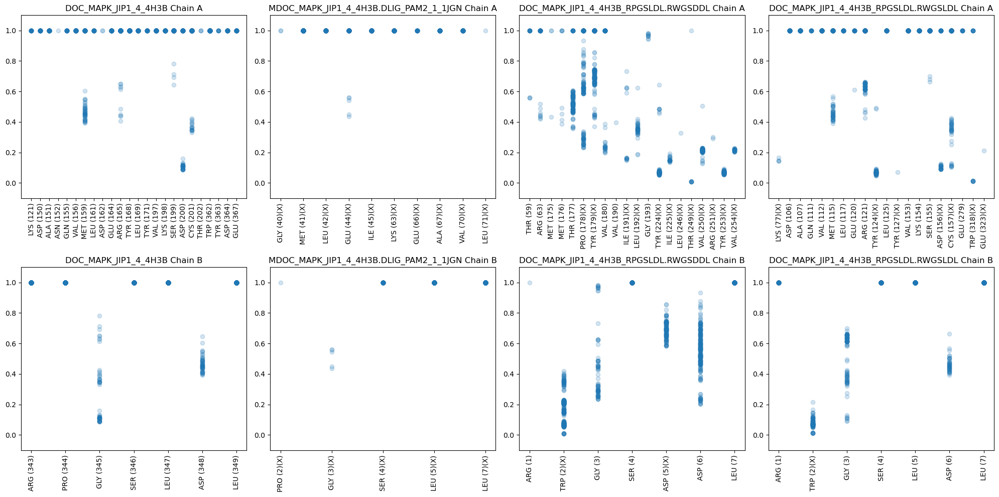

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
7,DEG_SCF_TIR1_1_2P1Q,2P1Q,DEG_SCF_TIR1_1,None,None,None,None,<Interface of 1778 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
131,MDEG_SCF_TIR1_1_2P1Q.DLIG_ULM_U2AF65_1_1O0P,2P1Q,MDEG_SCF_TIR1_1,1O0P,DLIG_ULM_U2AF65_1,None,None,<Interface of 1429 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
283,DEG_SCF_TIR1_1_2P1Q_QVVGWPPVRNYRK.QVDGWPPDRNYRK,2P1Q,DEG_SCF_TIR1_1,None,None,QVVGWPPVRNYRK,QVDGWPPDRNYRK,<Interface of 3021 pairs>
284,DEG_SCF_TIR1_1_2P1Q_QVVGWPPVRNYRK.QVDGWPPVRNYRK,2P1Q,DEG_SCF_TIR1_1,None,None,QVVGWPPVRNYRK,QVDGWPPVRNYRK,<Interface of 2426 pairs>


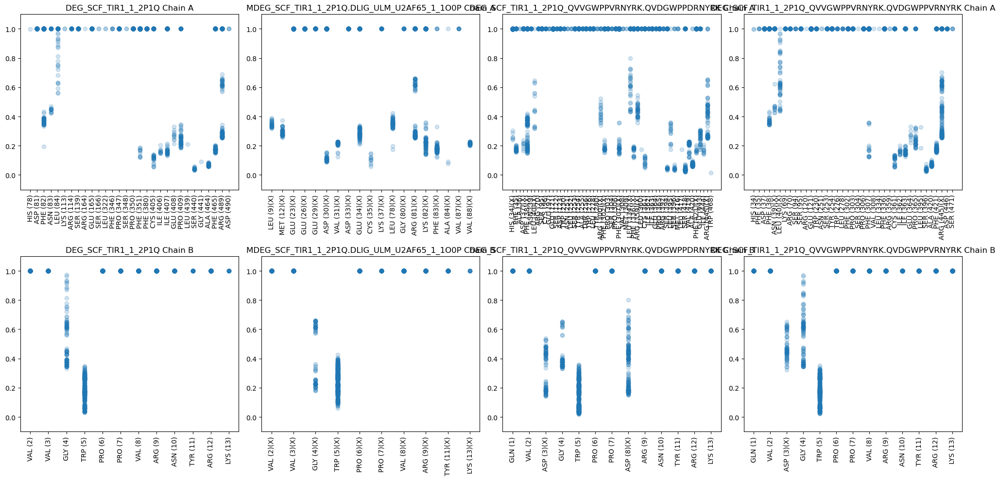

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
97,LIG_PDZ_Wminus1_1_1ZUB,1ZUB,LIG_PDZ_Wminus1_1,None,None,None,None,<Interface of 1785 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
220,MLIG_PDZ_Wminus1_1_1ZUB.DDEG_Kelch_Keap1_2_3WN7,1ZUB,MLIG_PDZ_Wminus1_1,3WN7,DDEG_Kelch_Keap1_2,None,None,<Interface of 963 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
459,LIG_PDZ_Wminus1_1_1ZUB_GIWA.GIGA,1ZUB,LIG_PDZ_Wminus1_1,None,None,GIWA,GIGA,<Interface of 1004 pairs>
460,LIG_PDZ_Wminus1_1_1ZUB_GIWA.GIGW,1ZUB,LIG_PDZ_Wminus1_1,None,None,GIWA,GIGW,<Interface of 1324 pairs>


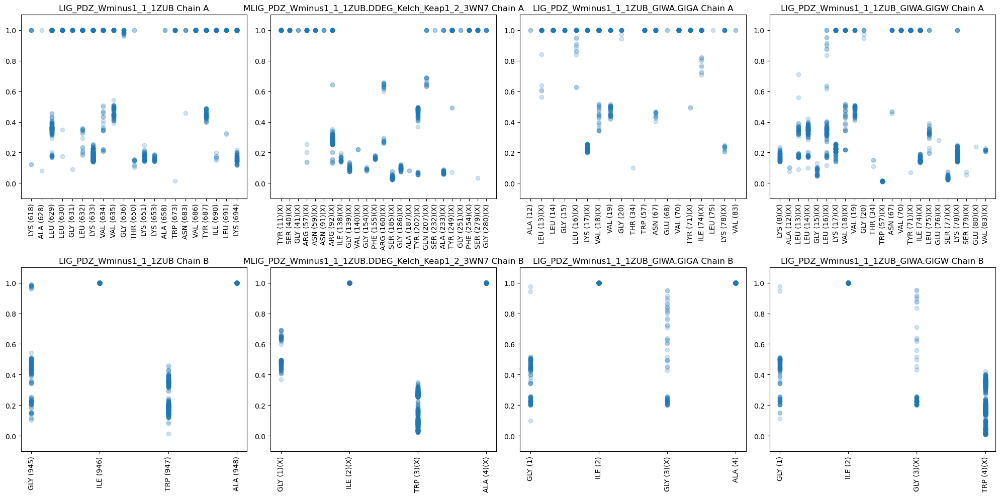

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
103,LIG_Rb_LxCxE_1_1GH6,1GH6,LIG_Rb_LxCxE_1,None,None,None,None,<Interface of 1394 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
226,MLIG_Rb_LxCxE_1_1GH6.DLIG_EVH1_1_1EVH,1GH6,MLIG_Rb_LxCxE_1,1EVH,DLIG_EVH1_1,None,None,<Interface of 1396 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
471,LIG_Rb_LxCxE_1_1GH6_ENLFCSEEMPSSDDEAT.ENLFCSEE...,1GH6,LIG_Rb_LxCxE_1,None,None,ENLFCSEEMPSSDDEAT,ENLFCSEEMPSSDDEAW,<Interface of 2213 pairs>
472,LIG_Rb_LxCxE_1_1GH6_ENLFCSEEMPSSDDEAT.ENLFCSEE...,1GH6,LIG_Rb_LxCxE_1,None,None,ENLFCSEEMPSSDDEAT,ENLFCSEEMWSSDDEAW,<Interface of 2089 pairs>


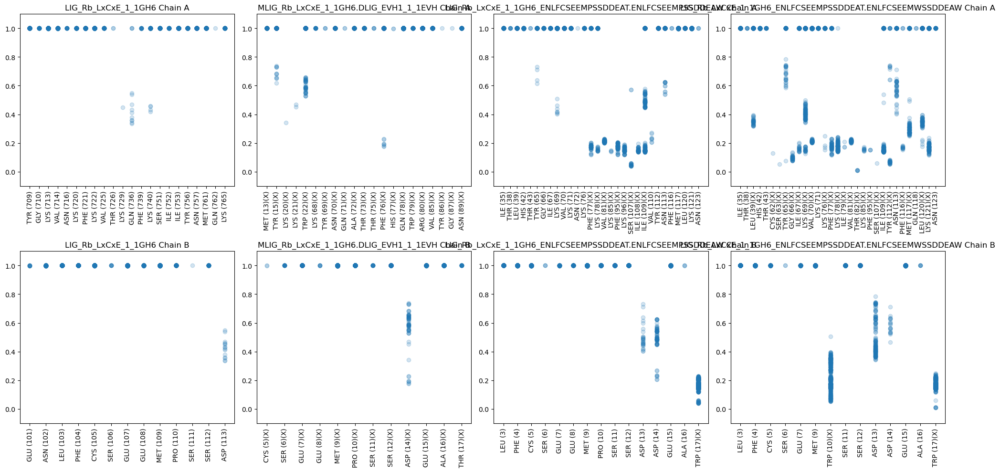

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
265,TRG_LysEnd_GGAAcLL_1_1JWG,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,None,None,<Interface of 1797 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
256,MTRG_LysEnd_GGAAcLL_1_1JWG.DLIG_SUMO_SIM_anti_...,1JWG,MTRG_LysEnd_GGAAcLL_1,2KQS,DLIG_SUMO_SIM_anti_2,None,None,<Interface of 1285 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
529,TRG_LysEnd_GGAAcLL_1_1JWG_DEDLLHI.DEDLDHI,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,DEDLLHI,DEDLDHI,<Interface of 1459 pairs>
530,TRG_LysEnd_GGAAcLL_1_1JWG_DEDLLHI.WEDLDHI,1JWG,TRG_LysEnd_GGAAcLL_1,None,None,DEDLLHI,WEDLDHI,<Interface of 1259 pairs>


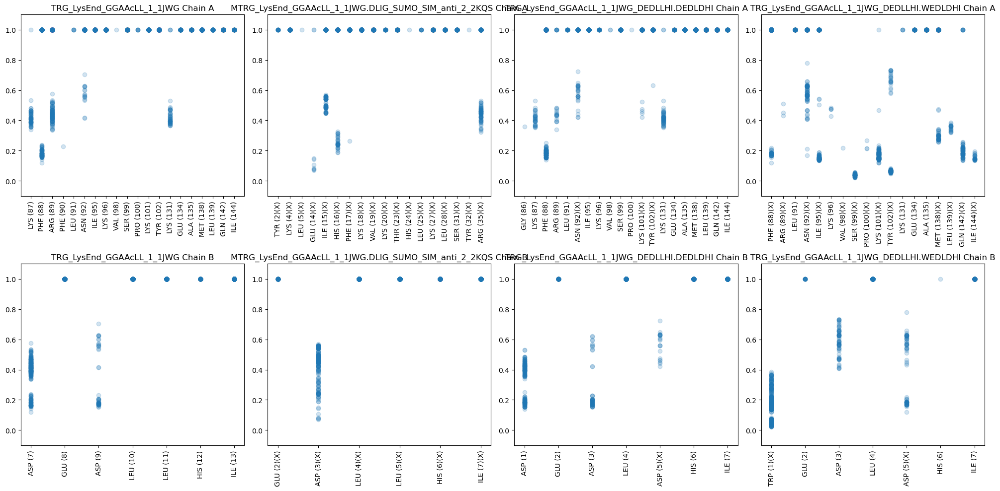

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
72,LIG_LIR_Apic_2_4EOY,4EOY,LIG_LIR_Apic_2,None,None,None,None,<Interface of 1383 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
195,MLIG_LIR_Apic_2_4EOY.DLIG_Sin3_1_1PD7,4EOY,MLIG_LIR_Apic_2,1PD7,DLIG_Sin3_1,None,None,<Interface of 663 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
409,LIG_LIR_Apic_2_4EOY_NDWLLP.NWWLLP,4EOY,LIG_LIR_Apic_2,None,None,NDWLLP,NWWLLP,<Interface of 1741 pairs>
410,LIG_LIR_Apic_2_4EOY_NDWLLP.NWWLLW,4EOY,LIG_LIR_Apic_2,None,None,NDWLLP,NWWLLW,<Interface of 1663 pairs>


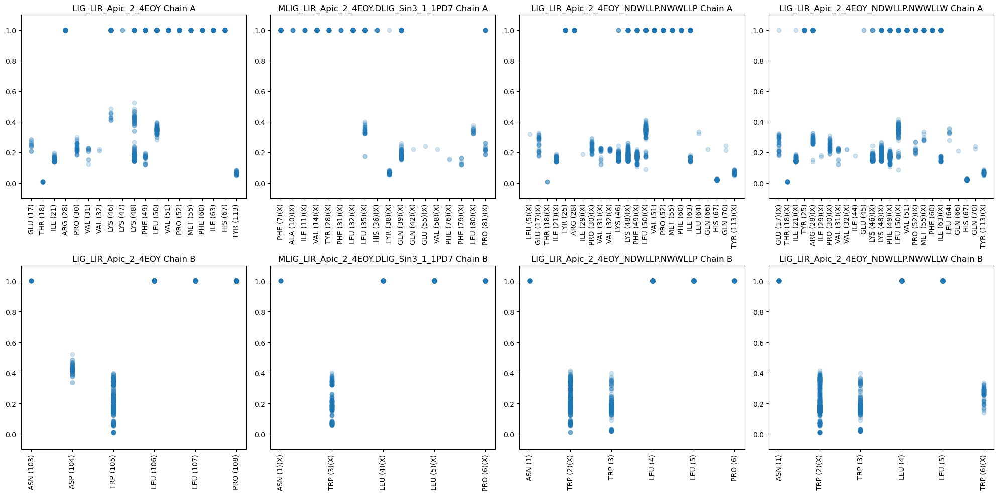

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
87,LIG_PALB2_WD40_1_3EU7,3EU7,LIG_PALB2_WD40_1,None,None,None,None,<Interface of 1450 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
210,MLIG_PALB2_WD40_1_3EU7.DLIG_Actin_RPEL_3_2V52,3EU7,MLIG_PALB2_WD40_1,2V52,DLIG_Actin_RPEL_3,None,None,<Interface of 1141 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
439,LIG_PALB2_WD40_1_3EU7_ISLNWFEEL.ISLNWDEED,3EU7,LIG_PALB2_WD40_1,None,None,ISLNWFEEL,ISLNWDEED,<Interface of 1524 pairs>
440,LIG_PALB2_WD40_1_3EU7_ISLNWFEEL.ISLNWDEEL,3EU7,LIG_PALB2_WD40_1,None,None,ISLNWFEEL,ISLNWDEEL,<Interface of 1392 pairs>


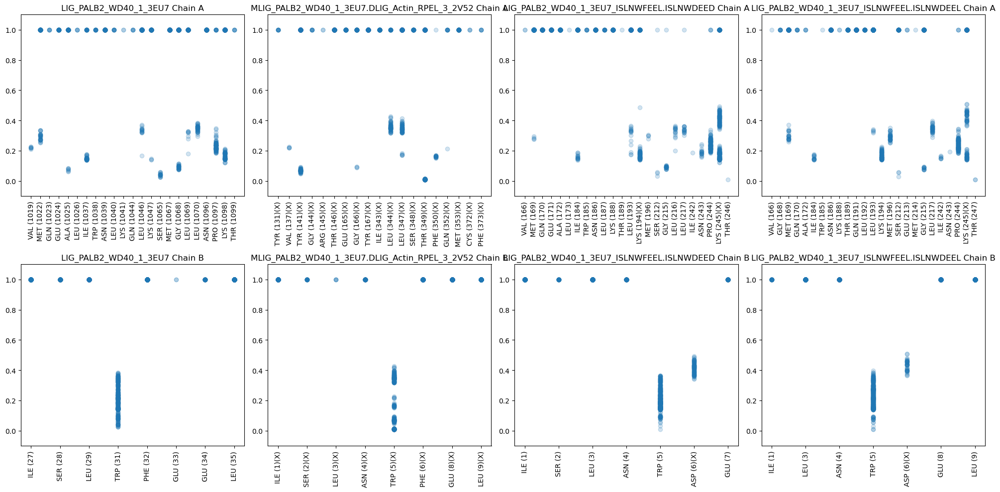

2


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
55,LIG_DLG_GKlike_1_3WP0,3WP0,LIG_DLG_GKlike_1,None,None,None,None,<Interface of 1007 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
178,MLIG_DLG_GKlike_1_3WP0.DTRG_ER_FFAT_1_2RR3,3WP0,MLIG_DLG_GKlike_1,2RR3,DTRG_ER_FFAT_1,None,None,<Interface of 1298 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


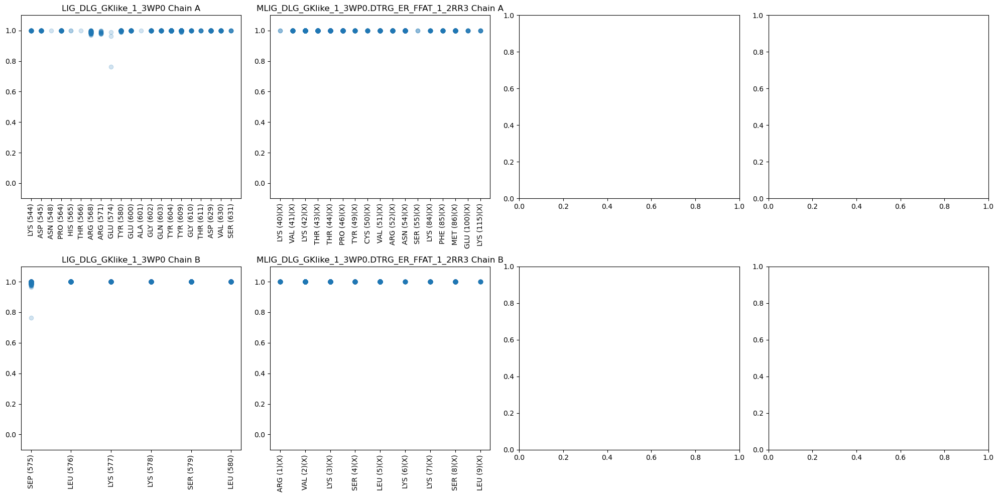

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
42,LIG_BH_BH3_1_2ROC,2ROC,LIG_BH_BH3_1,None,None,None,None,<Interface of 2468 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
165,MLIG_BH_BH3_1_2ROC.DLIG_Actin_WH2_2_2D1K,2ROC,MLIG_BH_BH3_1,2D1K,DLIG_Actin_WH2_2,None,None,<Interface of 1403 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
353,LIG_BH_BH3_1_2ROC_WAREIGAQLRRIADDLN.WAREIGAQLR...,2ROC,LIG_BH_BH3_1,None,None,WAREIGAQLRRIADDLN,WAREIGAQLRRDADDLN,<Interface of 2602 pairs>
354,LIG_BH_BH3_1_2ROC_WAREIGAQLRRIADDLN.WAREIGAQLR...,2ROC,LIG_BH_BH3_1,None,None,WAREIGAQLRRIADDLN,WAREIGAQLRRDWDDLN,<Interface of 2705 pairs>


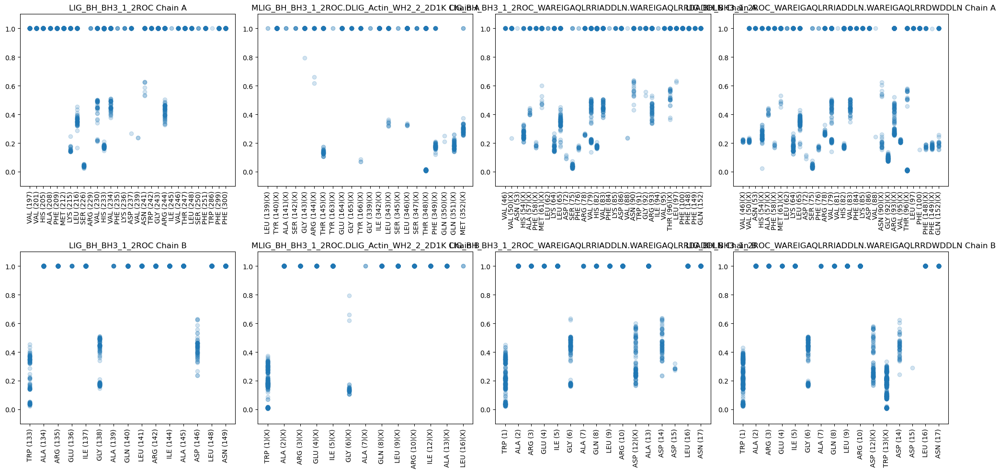

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
109,LIG_SH3_CIN85_PxpxPR_1_2BZ8,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,None,None,<Interface of 999 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
232,MLIG_SH3_CIN85_PxpxPR_1_2BZ8.DLIG_PAM2_1_1JGN,2BZ8,MLIG_SH3_CIN85_PxpxPR_1,1JGN,DLIG_PAM2_1,None,None,<Interface of 265 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
483,LIG_SH3_CIN85_PxpxPR_1_2BZ8_PKPRPR.PKPRPG,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,PKPRPR,PKPRPG,<Interface of 1007 pairs>
484,LIG_SH3_CIN85_PxpxPR_1_2BZ8_PKPRPR.PKPRWG,2BZ8,LIG_SH3_CIN85_PxpxPR_1,None,None,PKPRPR,PKPRWG,<Interface of 849 pairs>


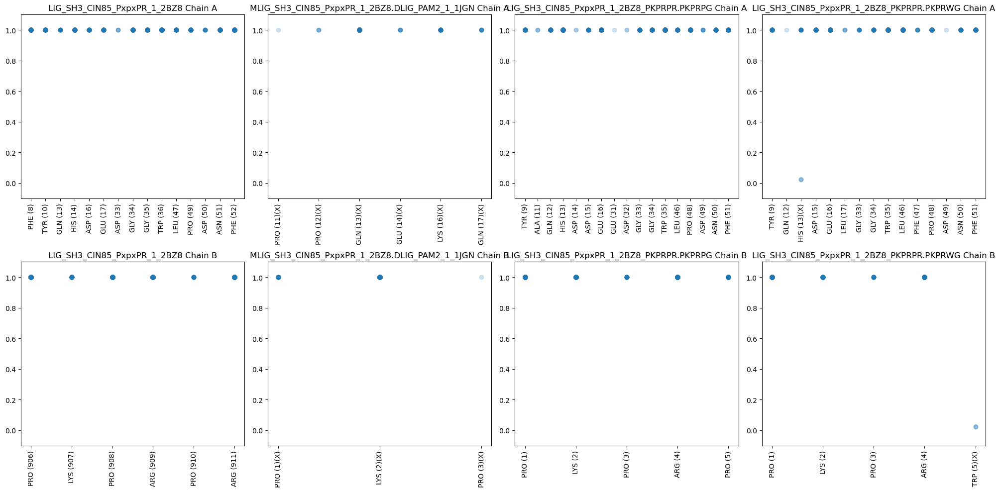

4


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
113,LIG_SUMO_SIM_anti_2_2KQS,2KQS,LIG_SUMO_SIM_anti_2,None,None,None,None,<Interface of 1850 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
235,MLIG_SUMO_SIM_anti_2_2KQS.DLIG_APCC_ABBA_1_4BH6,2KQS,MLIG_SUMO_SIM_anti_2,4BH6,DLIG_APCC_ABBA_1,None,None,<Interface of 965 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
489,LIG_SUMO_SIM_anti_2_2KQS_EIIVLSDSD.EIDVLSDWD,2KQS,LIG_SUMO_SIM_anti_2,None,None,EIIVLSDSD,EIDVLSDWD,<Interface of 1422 pairs>
490,LIG_SUMO_SIM_anti_2_2KQS_EIIVLSDSD.EIIVLSDWD,2KQS,LIG_SUMO_SIM_anti_2,None,None,EIIVLSDSD,EIIVLSDWD,<Interface of 1766 pairs>


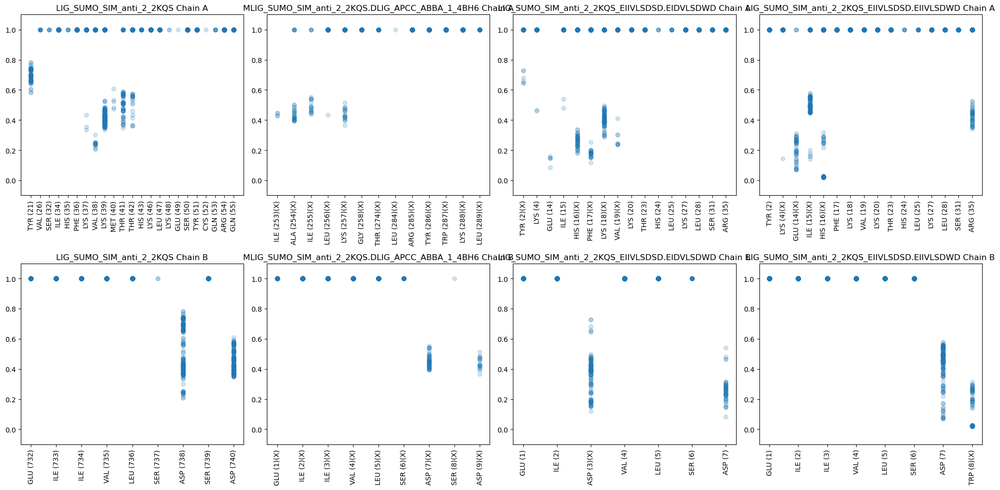

3


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
157,MLIG_Actin_RPEL_3_2V52.DLIG_ActinCP_TwfCPI_2_7DS2,2V52,MLIG_Actin_RPEL_3,7DS2,DLIG_ActinCP_TwfCPI_2,None,None,<Interface of 3866 pairs>


,structure_name,PDB_id,ELM_instance,PDB_id_random_paired,ELM_instance_random_paired,sequence,sequence_mutated,interface
337,LIG_Actin_RPEL_3_2V52_LKRKIRSRPERAELVRMHIL.LKR...,2V52,LIG_Actin_RPEL_3,None,None,LKRKIRSRPERAELVRMHIL,LKRKIRSGPERAELVRMHDL,<Interface of 1772 pairs>
338,LIG_Actin_RPEL_3_2V52_LKRKIRSRPERAELVRMHIL.LKR...,2V52,LIG_Actin_RPEL_3,None,None,LKRKIRSRPERAELVRMHIL,LKRKIRSGPERAELVRMHIL,<Interface of 1553 pairs>


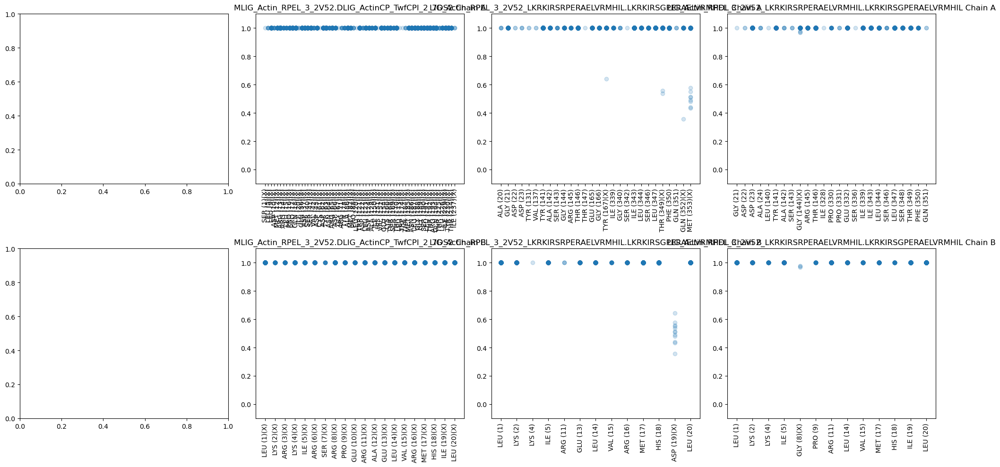

In [83]:
for pdb_id in pdb_ids_test:
    visualize_interface(pdb_id)